# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

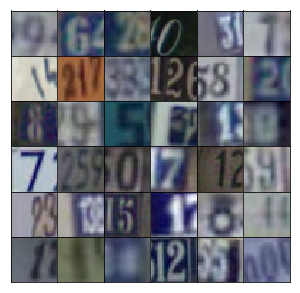

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2436... Generator Loss: 0.6785
Epoch 1/25... Discriminator Loss: 0.3475... Generator Loss: 1.9212
Epoch 1/25... Discriminator Loss: 0.1208... Generator Loss: 2.8579
Epoch 1/25... Discriminator Loss: 0.1227... Generator Loss: 3.2710
Epoch 1/25... Discriminator Loss: 0.2406... Generator Loss: 2.1881
Epoch 1/25... Discriminator Loss: 0.0751... Generator Loss: 3.5216
Epoch 1/25... Discriminator Loss: 0.0834... Generator Loss: 3.0931
Epoch 1/25... Discriminator Loss: 0.1949... Generator Loss: 5.6864
Epoch 1/25... Discriminator Loss: 0.0929... Generator Loss: 3.3664
Epoch 1/25... Discriminator Loss: 0.9643... Generator Loss: 1.3290


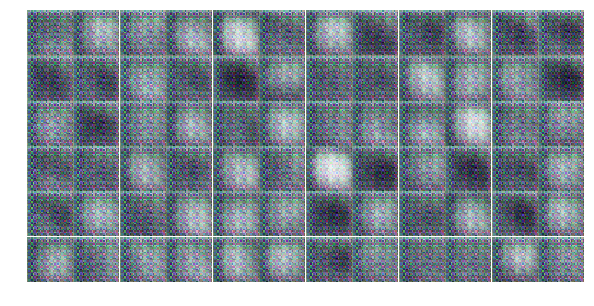

Epoch 1/25... Discriminator Loss: 0.7243... Generator Loss: 1.3117
Epoch 1/25... Discriminator Loss: 0.6073... Generator Loss: 1.6196
Epoch 1/25... Discriminator Loss: 0.4340... Generator Loss: 1.9106
Epoch 1/25... Discriminator Loss: 0.3264... Generator Loss: 1.7127
Epoch 1/25... Discriminator Loss: 0.7797... Generator Loss: 1.4066
Epoch 1/25... Discriminator Loss: 0.3804... Generator Loss: 2.5452
Epoch 1/25... Discriminator Loss: 0.4149... Generator Loss: 1.6648
Epoch 1/25... Discriminator Loss: 0.3118... Generator Loss: 2.9428
Epoch 1/25... Discriminator Loss: 0.6403... Generator Loss: 2.0113
Epoch 1/25... Discriminator Loss: 0.3584... Generator Loss: 4.2978


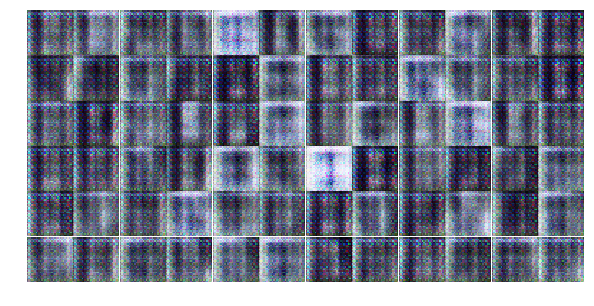

Epoch 1/25... Discriminator Loss: 0.4990... Generator Loss: 1.5109
Epoch 1/25... Discriminator Loss: 0.5960... Generator Loss: 1.3932
Epoch 1/25... Discriminator Loss: 1.8716... Generator Loss: 0.5756
Epoch 1/25... Discriminator Loss: 0.7957... Generator Loss: 3.8393
Epoch 1/25... Discriminator Loss: 0.5474... Generator Loss: 1.4866
Epoch 1/25... Discriminator Loss: 0.2863... Generator Loss: 2.0391
Epoch 1/25... Discriminator Loss: 1.2064... Generator Loss: 0.7103
Epoch 1/25... Discriminator Loss: 0.7938... Generator Loss: 1.1188
Epoch 1/25... Discriminator Loss: 1.2294... Generator Loss: 1.0402
Epoch 1/25... Discriminator Loss: 0.5713... Generator Loss: 2.2828


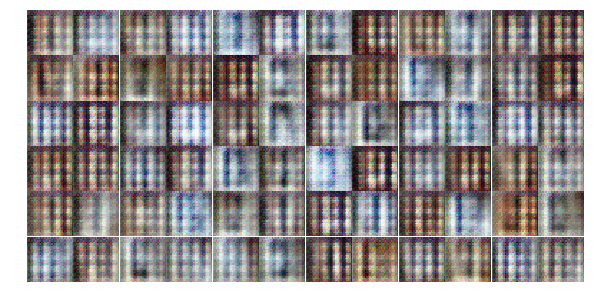

Epoch 1/25... Discriminator Loss: 1.0701... Generator Loss: 0.8224
Epoch 1/25... Discriminator Loss: 0.5224... Generator Loss: 1.8786
Epoch 1/25... Discriminator Loss: 0.8171... Generator Loss: 0.9711
Epoch 1/25... Discriminator Loss: 0.7818... Generator Loss: 1.4311
Epoch 1/25... Discriminator Loss: 0.5715... Generator Loss: 1.3469
Epoch 1/25... Discriminator Loss: 0.8635... Generator Loss: 1.0267
Epoch 1/25... Discriminator Loss: 0.4458... Generator Loss: 1.7262
Epoch 1/25... Discriminator Loss: 0.4072... Generator Loss: 2.3744
Epoch 1/25... Discriminator Loss: 0.6545... Generator Loss: 1.3274
Epoch 1/25... Discriminator Loss: 0.8307... Generator Loss: 1.6501


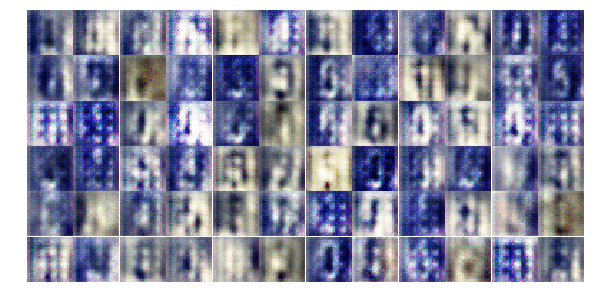

Epoch 1/25... Discriminator Loss: 0.7091... Generator Loss: 2.1951
Epoch 1/25... Discriminator Loss: 0.8285... Generator Loss: 2.2204
Epoch 1/25... Discriminator Loss: 0.7248... Generator Loss: 2.0490
Epoch 1/25... Discriminator Loss: 0.7360... Generator Loss: 1.8825
Epoch 1/25... Discriminator Loss: 0.7137... Generator Loss: 1.4508
Epoch 1/25... Discriminator Loss: 0.7770... Generator Loss: 1.2336
Epoch 1/25... Discriminator Loss: 0.5667... Generator Loss: 1.6351
Epoch 1/25... Discriminator Loss: 0.9378... Generator Loss: 1.0812
Epoch 1/25... Discriminator Loss: 1.0563... Generator Loss: 0.7452
Epoch 1/25... Discriminator Loss: 1.1849... Generator Loss: 0.7904


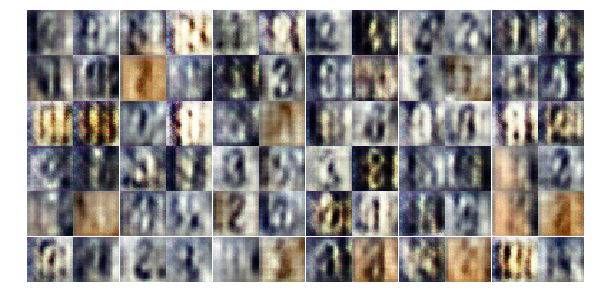

Epoch 1/25... Discriminator Loss: 0.9736... Generator Loss: 0.9109
Epoch 1/25... Discriminator Loss: 0.7694... Generator Loss: 1.4180
Epoch 1/25... Discriminator Loss: 0.7950... Generator Loss: 1.2018
Epoch 1/25... Discriminator Loss: 1.1886... Generator Loss: 0.6552
Epoch 1/25... Discriminator Loss: 0.7247... Generator Loss: 1.4999
Epoch 1/25... Discriminator Loss: 0.7762... Generator Loss: 1.2753
Epoch 1/25... Discriminator Loss: 0.7900... Generator Loss: 1.3820
Epoch 2/25... Discriminator Loss: 0.9050... Generator Loss: 1.4303
Epoch 2/25... Discriminator Loss: 1.0720... Generator Loss: 1.0909
Epoch 2/25... Discriminator Loss: 1.2997... Generator Loss: 1.2834


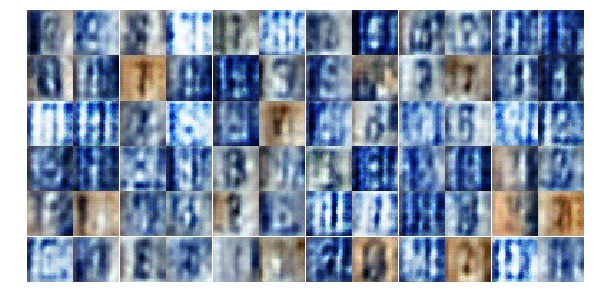

Epoch 2/25... Discriminator Loss: 0.7031... Generator Loss: 1.2593
Epoch 2/25... Discriminator Loss: 1.4143... Generator Loss: 0.4869
Epoch 2/25... Discriminator Loss: 1.0528... Generator Loss: 0.8170
Epoch 2/25... Discriminator Loss: 1.0989... Generator Loss: 1.1002
Epoch 2/25... Discriminator Loss: 1.3431... Generator Loss: 0.7013
Epoch 2/25... Discriminator Loss: 1.1537... Generator Loss: 0.9358
Epoch 2/25... Discriminator Loss: 1.0265... Generator Loss: 1.3118
Epoch 2/25... Discriminator Loss: 0.7505... Generator Loss: 1.3973
Epoch 2/25... Discriminator Loss: 0.9648... Generator Loss: 0.8002
Epoch 2/25... Discriminator Loss: 1.0148... Generator Loss: 1.0284


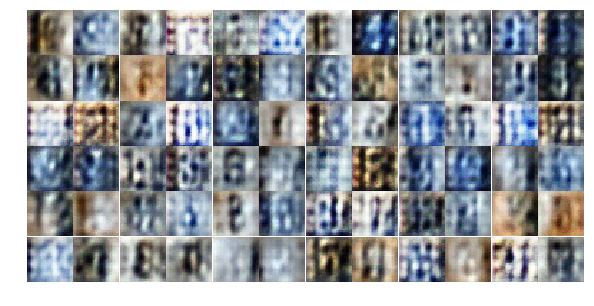

Epoch 2/25... Discriminator Loss: 1.0062... Generator Loss: 1.0005
Epoch 2/25... Discriminator Loss: 0.9013... Generator Loss: 1.4695
Epoch 2/25... Discriminator Loss: 0.8776... Generator Loss: 1.0155
Epoch 2/25... Discriminator Loss: 1.2117... Generator Loss: 0.7255
Epoch 2/25... Discriminator Loss: 1.4360... Generator Loss: 0.9540
Epoch 2/25... Discriminator Loss: 1.6684... Generator Loss: 0.8324
Epoch 2/25... Discriminator Loss: 1.0301... Generator Loss: 0.9090
Epoch 2/25... Discriminator Loss: 1.0892... Generator Loss: 0.7476
Epoch 2/25... Discriminator Loss: 1.3168... Generator Loss: 0.6906
Epoch 2/25... Discriminator Loss: 1.0463... Generator Loss: 0.9043


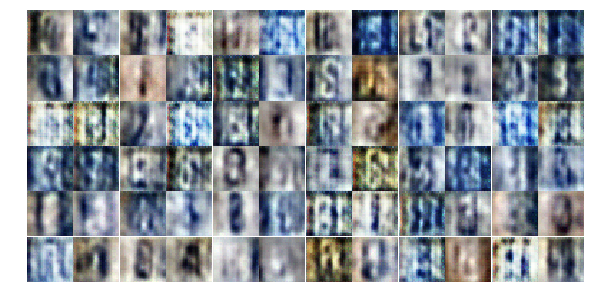

Epoch 2/25... Discriminator Loss: 1.1579... Generator Loss: 0.8032
Epoch 2/25... Discriminator Loss: 1.3056... Generator Loss: 0.7476
Epoch 2/25... Discriminator Loss: 1.0431... Generator Loss: 1.1779
Epoch 2/25... Discriminator Loss: 1.0237... Generator Loss: 1.1969
Epoch 2/25... Discriminator Loss: 1.1418... Generator Loss: 0.9716
Epoch 2/25... Discriminator Loss: 1.0744... Generator Loss: 0.9313
Epoch 2/25... Discriminator Loss: 1.3872... Generator Loss: 0.5056
Epoch 2/25... Discriminator Loss: 1.3031... Generator Loss: 0.6443
Epoch 2/25... Discriminator Loss: 1.1122... Generator Loss: 0.8955
Epoch 2/25... Discriminator Loss: 1.2426... Generator Loss: 0.9199


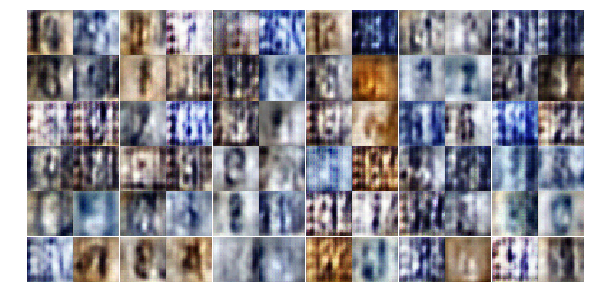

Epoch 2/25... Discriminator Loss: 1.0068... Generator Loss: 0.8958
Epoch 2/25... Discriminator Loss: 1.2648... Generator Loss: 0.8597
Epoch 2/25... Discriminator Loss: 1.1998... Generator Loss: 0.6605
Epoch 2/25... Discriminator Loss: 1.1229... Generator Loss: 0.8952
Epoch 2/25... Discriminator Loss: 1.0306... Generator Loss: 1.1463
Epoch 2/25... Discriminator Loss: 1.1711... Generator Loss: 0.8107
Epoch 2/25... Discriminator Loss: 1.1567... Generator Loss: 0.9047
Epoch 2/25... Discriminator Loss: 1.1256... Generator Loss: 1.2263
Epoch 2/25... Discriminator Loss: 1.2236... Generator Loss: 1.3148
Epoch 2/25... Discriminator Loss: 1.0133... Generator Loss: 0.9265


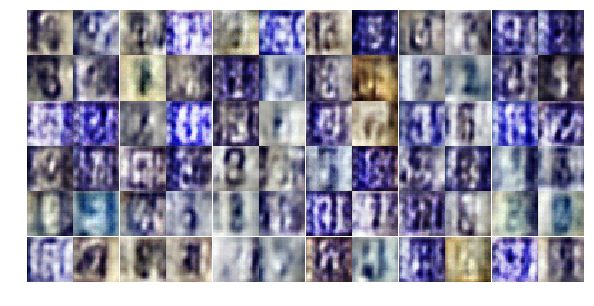

Epoch 2/25... Discriminator Loss: 1.0381... Generator Loss: 1.3716
Epoch 2/25... Discriminator Loss: 1.1599... Generator Loss: 1.0334
Epoch 2/25... Discriminator Loss: 1.1764... Generator Loss: 0.7035
Epoch 2/25... Discriminator Loss: 0.9902... Generator Loss: 0.8042
Epoch 2/25... Discriminator Loss: 1.0733... Generator Loss: 0.8621
Epoch 2/25... Discriminator Loss: 1.0535... Generator Loss: 0.7757
Epoch 2/25... Discriminator Loss: 1.1711... Generator Loss: 1.2907
Epoch 2/25... Discriminator Loss: 1.0944... Generator Loss: 1.1839
Epoch 2/25... Discriminator Loss: 1.0963... Generator Loss: 0.7189
Epoch 2/25... Discriminator Loss: 0.8886... Generator Loss: 1.1234


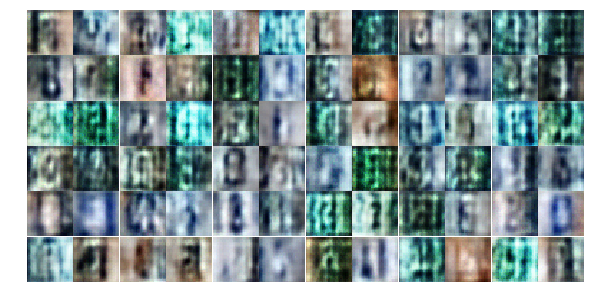

Epoch 2/25... Discriminator Loss: 0.8761... Generator Loss: 1.2150
Epoch 2/25... Discriminator Loss: 0.8567... Generator Loss: 1.2582
Epoch 2/25... Discriminator Loss: 0.8454... Generator Loss: 1.0431
Epoch 2/25... Discriminator Loss: 0.8587... Generator Loss: 1.1587
Epoch 3/25... Discriminator Loss: 0.9249... Generator Loss: 1.7255
Epoch 3/25... Discriminator Loss: 0.8435... Generator Loss: 1.3175
Epoch 3/25... Discriminator Loss: 0.8452... Generator Loss: 0.9674
Epoch 3/25... Discriminator Loss: 0.7700... Generator Loss: 1.2172
Epoch 3/25... Discriminator Loss: 0.7603... Generator Loss: 1.9585
Epoch 3/25... Discriminator Loss: 0.8951... Generator Loss: 1.4151


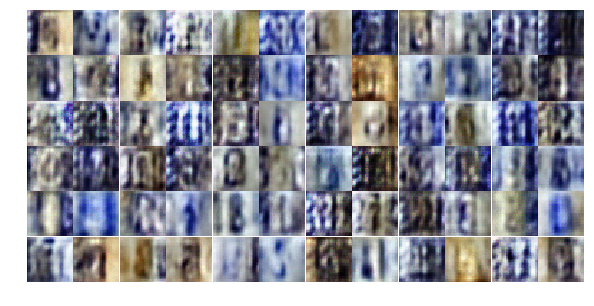

Epoch 3/25... Discriminator Loss: 0.6840... Generator Loss: 1.3342
Epoch 3/25... Discriminator Loss: 0.8903... Generator Loss: 2.3553
Epoch 3/25... Discriminator Loss: 0.7421... Generator Loss: 1.0755
Epoch 3/25... Discriminator Loss: 0.7293... Generator Loss: 1.0218
Epoch 3/25... Discriminator Loss: 0.8302... Generator Loss: 1.2266
Epoch 3/25... Discriminator Loss: 0.7452... Generator Loss: 1.2430
Epoch 3/25... Discriminator Loss: 0.6148... Generator Loss: 1.4354
Epoch 3/25... Discriminator Loss: 0.8660... Generator Loss: 0.8849
Epoch 3/25... Discriminator Loss: 0.8790... Generator Loss: 0.8001
Epoch 3/25... Discriminator Loss: 0.4962... Generator Loss: 1.6515


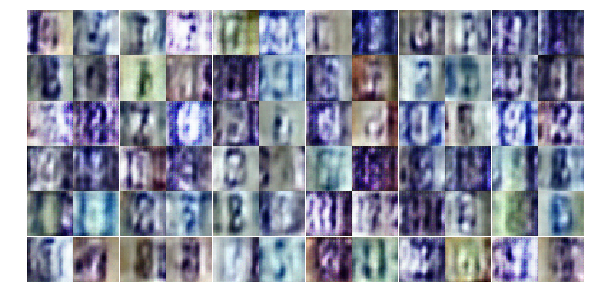

Epoch 3/25... Discriminator Loss: 0.5279... Generator Loss: 1.3849
Epoch 3/25... Discriminator Loss: 0.7804... Generator Loss: 1.1702
Epoch 3/25... Discriminator Loss: 0.5660... Generator Loss: 1.7452
Epoch 3/25... Discriminator Loss: 0.6253... Generator Loss: 1.4254
Epoch 3/25... Discriminator Loss: 0.5002... Generator Loss: 1.6317
Epoch 3/25... Discriminator Loss: 0.5616... Generator Loss: 1.9741
Epoch 3/25... Discriminator Loss: 1.0701... Generator Loss: 0.6511
Epoch 3/25... Discriminator Loss: 0.6029... Generator Loss: 1.6077
Epoch 3/25... Discriminator Loss: 0.6318... Generator Loss: 2.0848
Epoch 3/25... Discriminator Loss: 0.6868... Generator Loss: 1.0376


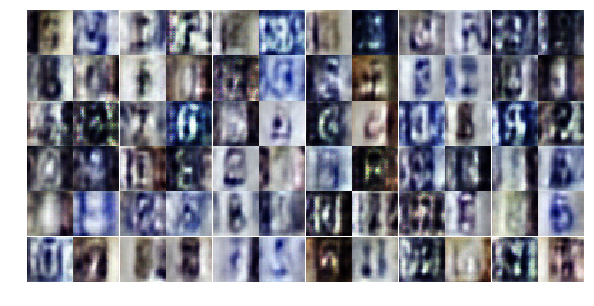

Epoch 3/25... Discriminator Loss: 0.7076... Generator Loss: 1.2864
Epoch 3/25... Discriminator Loss: 0.7337... Generator Loss: 1.4403
Epoch 3/25... Discriminator Loss: 0.4549... Generator Loss: 1.9342
Epoch 3/25... Discriminator Loss: 0.6597... Generator Loss: 2.0747
Epoch 3/25... Discriminator Loss: 0.8500... Generator Loss: 1.0868
Epoch 3/25... Discriminator Loss: 0.6539... Generator Loss: 1.9096
Epoch 3/25... Discriminator Loss: 0.6435... Generator Loss: 1.4600
Epoch 3/25... Discriminator Loss: 1.0990... Generator Loss: 1.8492
Epoch 3/25... Discriminator Loss: 0.6103... Generator Loss: 1.3462
Epoch 3/25... Discriminator Loss: 0.7238... Generator Loss: 1.8038


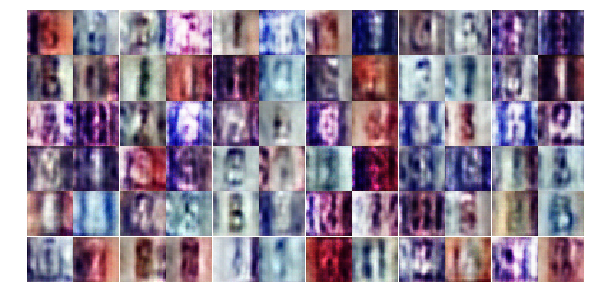

Epoch 3/25... Discriminator Loss: 0.6714... Generator Loss: 1.2371
Epoch 3/25... Discriminator Loss: 0.5480... Generator Loss: 2.3575
Epoch 3/25... Discriminator Loss: 0.7205... Generator Loss: 1.0690
Epoch 3/25... Discriminator Loss: 0.5481... Generator Loss: 1.4654
Epoch 3/25... Discriminator Loss: 0.8636... Generator Loss: 2.6803
Epoch 3/25... Discriminator Loss: 0.6767... Generator Loss: 1.1996
Epoch 3/25... Discriminator Loss: 0.5694... Generator Loss: 1.6863
Epoch 3/25... Discriminator Loss: 0.6061... Generator Loss: 1.2416
Epoch 3/25... Discriminator Loss: 0.5557... Generator Loss: 2.4806
Epoch 3/25... Discriminator Loss: 0.5973... Generator Loss: 1.7575


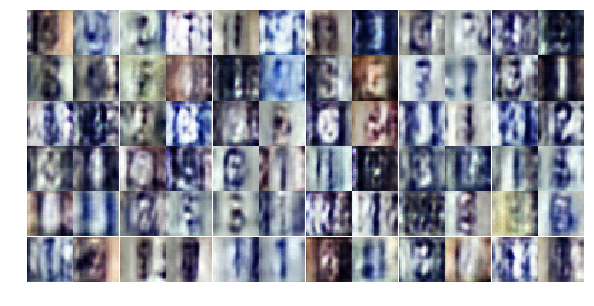

Epoch 3/25... Discriminator Loss: 1.5464... Generator Loss: 0.3513
Epoch 3/25... Discriminator Loss: 1.0445... Generator Loss: 1.3539
Epoch 3/25... Discriminator Loss: 0.9350... Generator Loss: 0.8187
Epoch 3/25... Discriminator Loss: 0.6328... Generator Loss: 1.1321
Epoch 3/25... Discriminator Loss: 0.7359... Generator Loss: 2.4562
Epoch 3/25... Discriminator Loss: 0.4962... Generator Loss: 1.9751
Epoch 3/25... Discriminator Loss: 0.5684... Generator Loss: 1.4591
Epoch 3/25... Discriminator Loss: 0.5745... Generator Loss: 2.1350
Epoch 3/25... Discriminator Loss: 0.5195... Generator Loss: 1.7339
Epoch 3/25... Discriminator Loss: 0.4302... Generator Loss: 1.9763


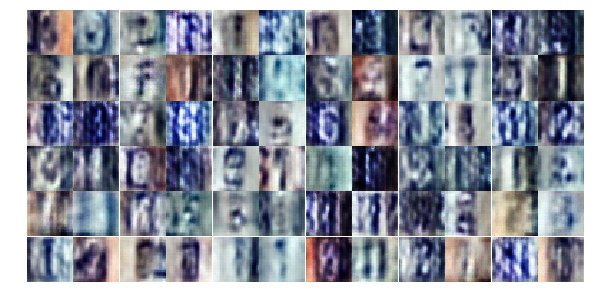

Epoch 3/25... Discriminator Loss: 1.3751... Generator Loss: 0.4245
Epoch 4/25... Discriminator Loss: 0.8838... Generator Loss: 0.9141
Epoch 4/25... Discriminator Loss: 1.2861... Generator Loss: 0.5208
Epoch 4/25... Discriminator Loss: 0.7601... Generator Loss: 1.0916
Epoch 4/25... Discriminator Loss: 0.8130... Generator Loss: 1.6279
Epoch 4/25... Discriminator Loss: 0.5013... Generator Loss: 1.3713
Epoch 4/25... Discriminator Loss: 0.6714... Generator Loss: 1.7418
Epoch 4/25... Discriminator Loss: 0.9908... Generator Loss: 0.7634
Epoch 4/25... Discriminator Loss: 0.4093... Generator Loss: 1.9343
Epoch 4/25... Discriminator Loss: 0.5373... Generator Loss: 1.2335


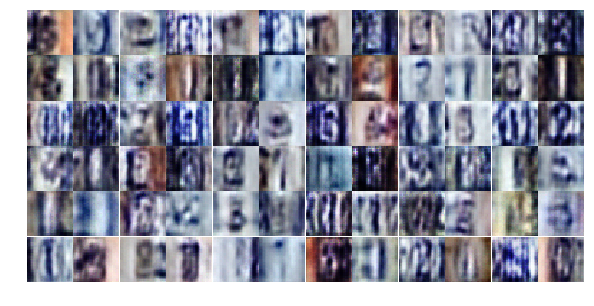

Epoch 4/25... Discriminator Loss: 0.4924... Generator Loss: 2.0751
Epoch 4/25... Discriminator Loss: 0.9716... Generator Loss: 0.7403
Epoch 4/25... Discriminator Loss: 0.6890... Generator Loss: 1.4681
Epoch 4/25... Discriminator Loss: 0.5092... Generator Loss: 1.6337
Epoch 4/25... Discriminator Loss: 1.1571... Generator Loss: 2.5260
Epoch 4/25... Discriminator Loss: 1.2248... Generator Loss: 0.4887
Epoch 4/25... Discriminator Loss: 0.6879... Generator Loss: 1.0174
Epoch 4/25... Discriminator Loss: 0.6415... Generator Loss: 1.1651
Epoch 4/25... Discriminator Loss: 0.7760... Generator Loss: 1.7936
Epoch 4/25... Discriminator Loss: 0.7006... Generator Loss: 2.3032


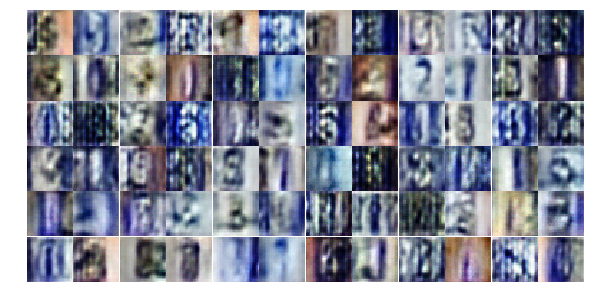

Epoch 4/25... Discriminator Loss: 0.5519... Generator Loss: 1.6604
Epoch 4/25... Discriminator Loss: 0.4975... Generator Loss: 1.6180
Epoch 4/25... Discriminator Loss: 0.8988... Generator Loss: 0.7246
Epoch 4/25... Discriminator Loss: 0.4757... Generator Loss: 1.7279
Epoch 4/25... Discriminator Loss: 0.3873... Generator Loss: 1.6792
Epoch 4/25... Discriminator Loss: 0.4817... Generator Loss: 1.8525
Epoch 4/25... Discriminator Loss: 0.9417... Generator Loss: 0.7213
Epoch 4/25... Discriminator Loss: 0.5394... Generator Loss: 1.3481
Epoch 4/25... Discriminator Loss: 1.0699... Generator Loss: 0.9297
Epoch 4/25... Discriminator Loss: 0.9112... Generator Loss: 2.9513


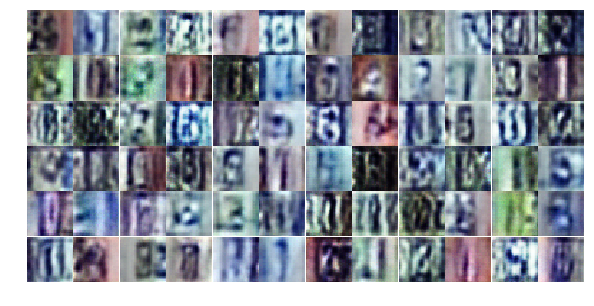

Epoch 4/25... Discriminator Loss: 0.4702... Generator Loss: 1.5561
Epoch 4/25... Discriminator Loss: 0.4792... Generator Loss: 1.4205
Epoch 4/25... Discriminator Loss: 0.5262... Generator Loss: 1.4938
Epoch 4/25... Discriminator Loss: 0.5764... Generator Loss: 2.2252
Epoch 4/25... Discriminator Loss: 0.2400... Generator Loss: 2.3431
Epoch 4/25... Discriminator Loss: 0.4597... Generator Loss: 1.6842
Epoch 4/25... Discriminator Loss: 1.5401... Generator Loss: 3.4664
Epoch 4/25... Discriminator Loss: 0.9528... Generator Loss: 0.6938
Epoch 4/25... Discriminator Loss: 0.5682... Generator Loss: 1.1670
Epoch 4/25... Discriminator Loss: 0.5930... Generator Loss: 1.4403


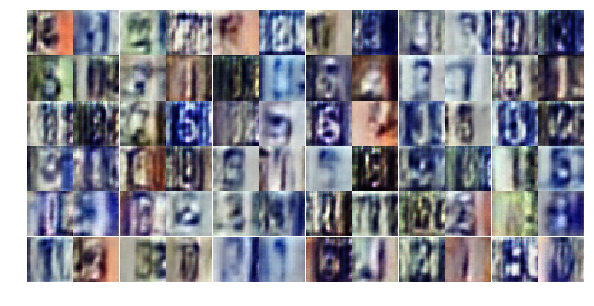

Epoch 4/25... Discriminator Loss: 0.5877... Generator Loss: 1.2745
Epoch 4/25... Discriminator Loss: 0.3959... Generator Loss: 1.6890
Epoch 4/25... Discriminator Loss: 0.7101... Generator Loss: 1.0075
Epoch 4/25... Discriminator Loss: 0.6235... Generator Loss: 1.2956
Epoch 4/25... Discriminator Loss: 0.3872... Generator Loss: 1.5623
Epoch 4/25... Discriminator Loss: 0.6900... Generator Loss: 1.2304
Epoch 4/25... Discriminator Loss: 0.6168... Generator Loss: 1.5428
Epoch 4/25... Discriminator Loss: 0.7218... Generator Loss: 2.2002
Epoch 4/25... Discriminator Loss: 0.7967... Generator Loss: 0.8454
Epoch 4/25... Discriminator Loss: 0.6553... Generator Loss: 1.0715


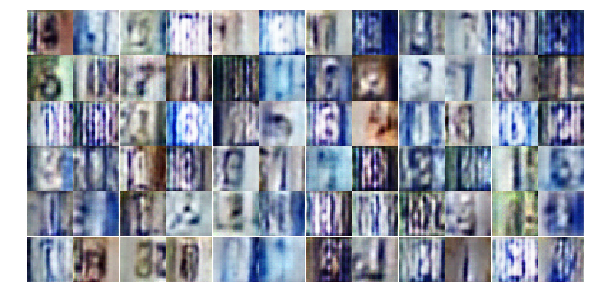

Epoch 4/25... Discriminator Loss: 0.4161... Generator Loss: 1.8123
Epoch 4/25... Discriminator Loss: 0.5462... Generator Loss: 1.6726
Epoch 4/25... Discriminator Loss: 0.4598... Generator Loss: 1.6350
Epoch 4/25... Discriminator Loss: 0.4952... Generator Loss: 1.6407
Epoch 4/25... Discriminator Loss: 0.4941... Generator Loss: 2.0457
Epoch 4/25... Discriminator Loss: 0.6105... Generator Loss: 2.2802
Epoch 4/25... Discriminator Loss: 0.4621... Generator Loss: 1.4497
Epoch 4/25... Discriminator Loss: 1.0402... Generator Loss: 0.5886
Epoch 4/25... Discriminator Loss: 0.7286... Generator Loss: 2.2786
Epoch 5/25... Discriminator Loss: 0.4587... Generator Loss: 1.5694


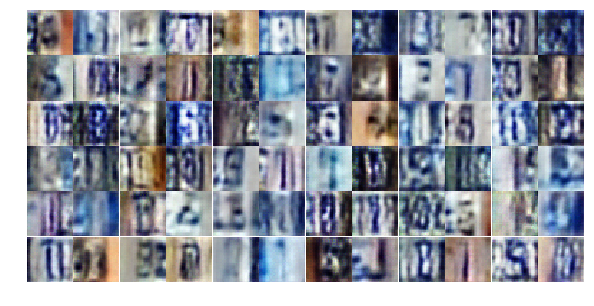

Epoch 5/25... Discriminator Loss: 0.2785... Generator Loss: 2.2748
Epoch 5/25... Discriminator Loss: 0.4489... Generator Loss: 1.4970
Epoch 5/25... Discriminator Loss: 1.0312... Generator Loss: 3.3684
Epoch 5/25... Discriminator Loss: 0.7659... Generator Loss: 0.8717
Epoch 5/25... Discriminator Loss: 0.3951... Generator Loss: 1.8880
Epoch 5/25... Discriminator Loss: 1.0100... Generator Loss: 0.6338
Epoch 5/25... Discriminator Loss: 0.6791... Generator Loss: 1.0132
Epoch 5/25... Discriminator Loss: 0.5790... Generator Loss: 1.1388
Epoch 5/25... Discriminator Loss: 1.1425... Generator Loss: 3.7215
Epoch 5/25... Discriminator Loss: 1.3229... Generator Loss: 0.4480


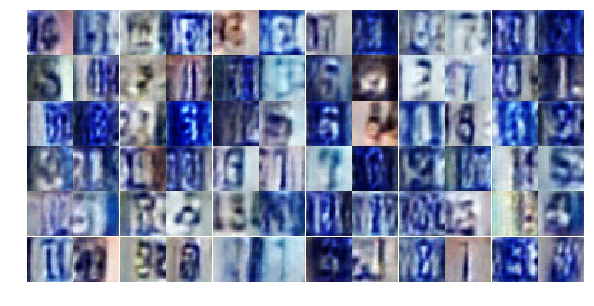

Epoch 5/25... Discriminator Loss: 0.9921... Generator Loss: 1.7277
Epoch 5/25... Discriminator Loss: 0.6328... Generator Loss: 1.2587
Epoch 5/25... Discriminator Loss: 0.5199... Generator Loss: 2.0859
Epoch 5/25... Discriminator Loss: 1.2368... Generator Loss: 0.5323
Epoch 5/25... Discriminator Loss: 0.6890... Generator Loss: 1.2358
Epoch 5/25... Discriminator Loss: 0.5132... Generator Loss: 1.4635
Epoch 5/25... Discriminator Loss: 0.5621... Generator Loss: 1.2428
Epoch 5/25... Discriminator Loss: 0.4051... Generator Loss: 1.9190
Epoch 5/25... Discriminator Loss: 0.5088... Generator Loss: 1.4988
Epoch 5/25... Discriminator Loss: 0.5932... Generator Loss: 1.1918


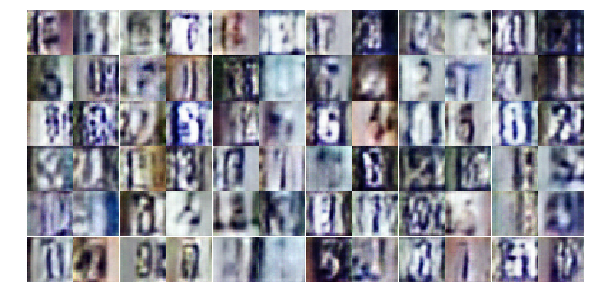

Epoch 5/25... Discriminator Loss: 0.4797... Generator Loss: 1.5315
Epoch 5/25... Discriminator Loss: 1.8065... Generator Loss: 0.3420
Epoch 5/25... Discriminator Loss: 0.8898... Generator Loss: 0.8924
Epoch 5/25... Discriminator Loss: 0.7263... Generator Loss: 1.1250
Epoch 5/25... Discriminator Loss: 0.5635... Generator Loss: 1.2765
Epoch 5/25... Discriminator Loss: 0.6907... Generator Loss: 1.0591
Epoch 5/25... Discriminator Loss: 1.1839... Generator Loss: 0.5275
Epoch 5/25... Discriminator Loss: 0.6794... Generator Loss: 1.0716
Epoch 5/25... Discriminator Loss: 0.8719... Generator Loss: 0.9883
Epoch 5/25... Discriminator Loss: 0.4151... Generator Loss: 1.7791


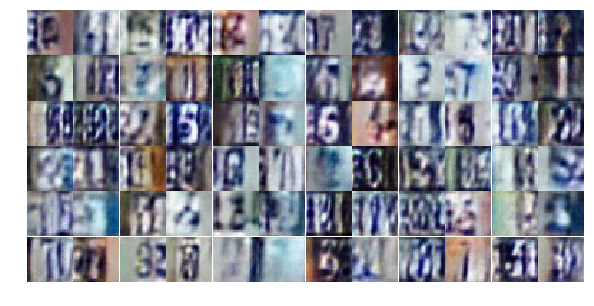

Epoch 5/25... Discriminator Loss: 0.6204... Generator Loss: 1.2818
Epoch 5/25... Discriminator Loss: 0.6237... Generator Loss: 1.2293
Epoch 5/25... Discriminator Loss: 0.5695... Generator Loss: 1.3550
Epoch 5/25... Discriminator Loss: 0.7210... Generator Loss: 0.9381
Epoch 5/25... Discriminator Loss: 0.7969... Generator Loss: 1.4845
Epoch 5/25... Discriminator Loss: 0.4097... Generator Loss: 1.8659
Epoch 5/25... Discriminator Loss: 0.7379... Generator Loss: 0.8865
Epoch 5/25... Discriminator Loss: 0.8593... Generator Loss: 0.7617
Epoch 5/25... Discriminator Loss: 1.3651... Generator Loss: 2.8835
Epoch 5/25... Discriminator Loss: 0.4893... Generator Loss: 1.7635


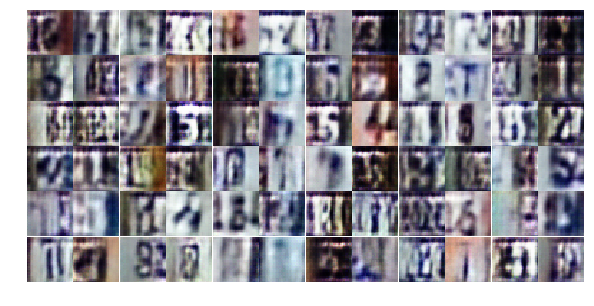

Epoch 5/25... Discriminator Loss: 0.5087... Generator Loss: 1.7315
Epoch 5/25... Discriminator Loss: 0.5228... Generator Loss: 1.2663
Epoch 5/25... Discriminator Loss: 1.3154... Generator Loss: 0.4764
Epoch 5/25... Discriminator Loss: 1.5950... Generator Loss: 0.3461
Epoch 5/25... Discriminator Loss: 0.6889... Generator Loss: 1.5944
Epoch 5/25... Discriminator Loss: 1.0393... Generator Loss: 1.8336
Epoch 5/25... Discriminator Loss: 0.8469... Generator Loss: 0.8647
Epoch 5/25... Discriminator Loss: 0.4730... Generator Loss: 1.7764
Epoch 5/25... Discriminator Loss: 0.5895... Generator Loss: 1.3192
Epoch 5/25... Discriminator Loss: 0.4603... Generator Loss: 2.1186


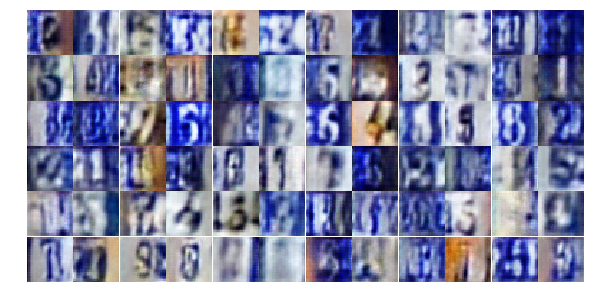

Epoch 5/25... Discriminator Loss: 0.5679... Generator Loss: 1.1432
Epoch 5/25... Discriminator Loss: 0.6338... Generator Loss: 1.0945
Epoch 5/25... Discriminator Loss: 0.6969... Generator Loss: 1.3144
Epoch 5/25... Discriminator Loss: 0.6306... Generator Loss: 1.0361
Epoch 5/25... Discriminator Loss: 0.8508... Generator Loss: 0.8327
Epoch 5/25... Discriminator Loss: 1.0392... Generator Loss: 0.6928
Epoch 6/25... Discriminator Loss: 0.8767... Generator Loss: 0.7495
Epoch 6/25... Discriminator Loss: 0.5842... Generator Loss: 1.1996
Epoch 6/25... Discriminator Loss: 1.1500... Generator Loss: 0.6895
Epoch 6/25... Discriminator Loss: 0.1913... Generator Loss: 2.9939


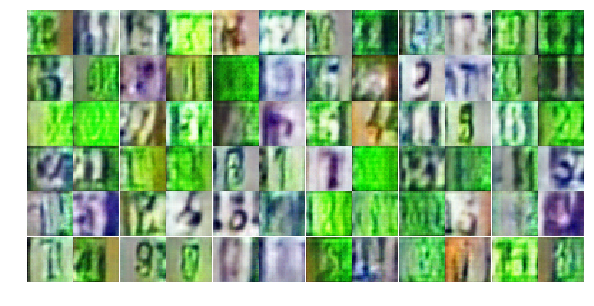

Epoch 6/25... Discriminator Loss: 1.0963... Generator Loss: 0.6178
Epoch 6/25... Discriminator Loss: 1.6532... Generator Loss: 2.9890
Epoch 6/25... Discriminator Loss: 0.8329... Generator Loss: 2.5099
Epoch 6/25... Discriminator Loss: 1.0607... Generator Loss: 0.7170
Epoch 6/25... Discriminator Loss: 1.2005... Generator Loss: 0.5001
Epoch 6/25... Discriminator Loss: 0.4989... Generator Loss: 1.3761
Epoch 6/25... Discriminator Loss: 0.5574... Generator Loss: 1.2000
Epoch 6/25... Discriminator Loss: 1.0474... Generator Loss: 0.5734
Epoch 6/25... Discriminator Loss: 0.6271... Generator Loss: 1.1033
Epoch 6/25... Discriminator Loss: 0.5273... Generator Loss: 2.3759


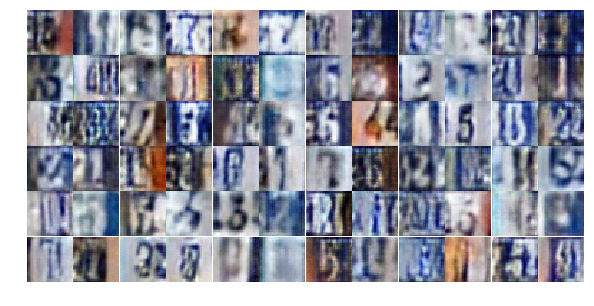

Epoch 6/25... Discriminator Loss: 0.5918... Generator Loss: 1.6625
Epoch 6/25... Discriminator Loss: 0.7006... Generator Loss: 1.6507
Epoch 6/25... Discriminator Loss: 1.2454... Generator Loss: 0.4624
Epoch 6/25... Discriminator Loss: 0.4292... Generator Loss: 1.5551
Epoch 6/25... Discriminator Loss: 0.3176... Generator Loss: 2.5794
Epoch 6/25... Discriminator Loss: 0.5977... Generator Loss: 1.4668
Epoch 6/25... Discriminator Loss: 0.7142... Generator Loss: 1.0439
Epoch 6/25... Discriminator Loss: 0.7430... Generator Loss: 1.2268
Epoch 6/25... Discriminator Loss: 0.6955... Generator Loss: 2.1139
Epoch 6/25... Discriminator Loss: 0.6390... Generator Loss: 1.2631


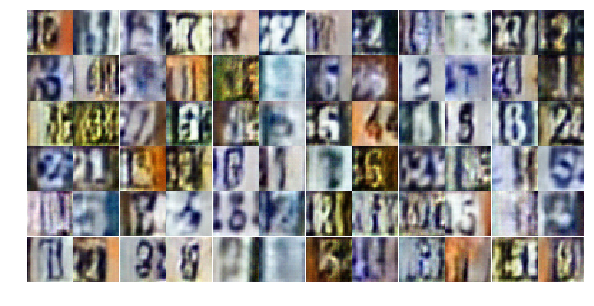

Epoch 6/25... Discriminator Loss: 0.7544... Generator Loss: 0.9402
Epoch 6/25... Discriminator Loss: 0.5337... Generator Loss: 1.2343
Epoch 6/25... Discriminator Loss: 0.9984... Generator Loss: 0.6646
Epoch 6/25... Discriminator Loss: 0.9976... Generator Loss: 0.6063
Epoch 6/25... Discriminator Loss: 0.6485... Generator Loss: 1.9575
Epoch 6/25... Discriminator Loss: 0.7757... Generator Loss: 1.0550
Epoch 6/25... Discriminator Loss: 0.6438... Generator Loss: 1.4640
Epoch 6/25... Discriminator Loss: 0.3244... Generator Loss: 2.0716
Epoch 6/25... Discriminator Loss: 0.4842... Generator Loss: 2.1025
Epoch 6/25... Discriminator Loss: 0.6852... Generator Loss: 1.0751


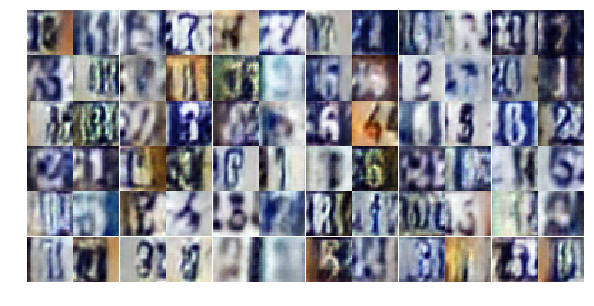

Epoch 6/25... Discriminator Loss: 1.1445... Generator Loss: 2.5625
Epoch 6/25... Discriminator Loss: 0.9292... Generator Loss: 2.3802
Epoch 6/25... Discriminator Loss: 0.6156... Generator Loss: 1.1333
Epoch 6/25... Discriminator Loss: 0.6718... Generator Loss: 1.0053
Epoch 6/25... Discriminator Loss: 1.0352... Generator Loss: 0.6146
Epoch 6/25... Discriminator Loss: 0.7998... Generator Loss: 0.7807
Epoch 6/25... Discriminator Loss: 0.7081... Generator Loss: 0.9814
Epoch 6/25... Discriminator Loss: 0.4660... Generator Loss: 1.8746
Epoch 6/25... Discriminator Loss: 0.5260... Generator Loss: 2.0338
Epoch 6/25... Discriminator Loss: 0.4326... Generator Loss: 1.3523


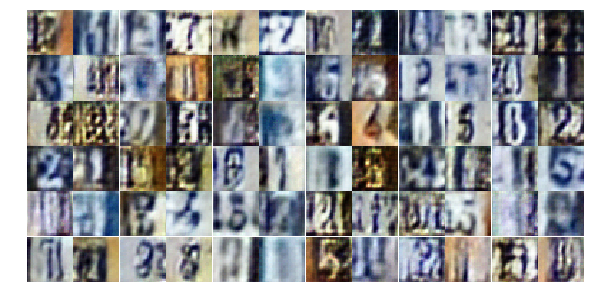

Epoch 6/25... Discriminator Loss: 0.9149... Generator Loss: 2.0162
Epoch 6/25... Discriminator Loss: 0.8055... Generator Loss: 1.5207
Epoch 6/25... Discriminator Loss: 0.7683... Generator Loss: 0.9542
Epoch 6/25... Discriminator Loss: 0.5238... Generator Loss: 1.7139
Epoch 6/25... Discriminator Loss: 0.6069... Generator Loss: 1.2893
Epoch 6/25... Discriminator Loss: 0.5077... Generator Loss: 1.4355
Epoch 6/25... Discriminator Loss: 1.0097... Generator Loss: 0.6264
Epoch 6/25... Discriminator Loss: 1.0885... Generator Loss: 1.9070
Epoch 6/25... Discriminator Loss: 0.8469... Generator Loss: 0.7858
Epoch 6/25... Discriminator Loss: 2.1472... Generator Loss: 0.1880


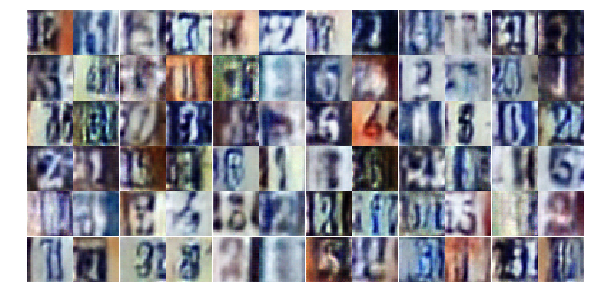

Epoch 6/25... Discriminator Loss: 0.5398... Generator Loss: 1.4731
Epoch 6/25... Discriminator Loss: 0.4876... Generator Loss: 1.3676
Epoch 6/25... Discriminator Loss: 0.7217... Generator Loss: 0.8844
Epoch 7/25... Discriminator Loss: 0.9180... Generator Loss: 2.3150
Epoch 7/25... Discriminator Loss: 1.0232... Generator Loss: 0.7453
Epoch 7/25... Discriminator Loss: 0.7050... Generator Loss: 0.9966
Epoch 7/25... Discriminator Loss: 0.4327... Generator Loss: 1.6255
Epoch 7/25... Discriminator Loss: 0.4179... Generator Loss: 1.6904
Epoch 7/25... Discriminator Loss: 0.7256... Generator Loss: 3.2080
Epoch 7/25... Discriminator Loss: 0.6973... Generator Loss: 1.1315


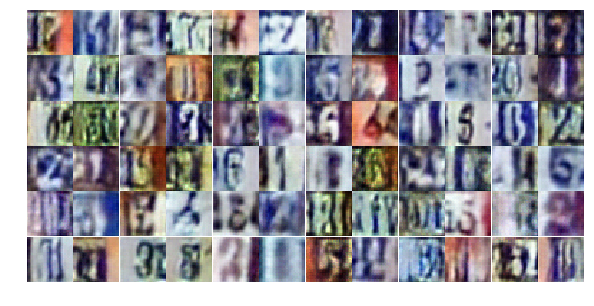

Epoch 7/25... Discriminator Loss: 0.4879... Generator Loss: 1.8790
Epoch 7/25... Discriminator Loss: 0.9151... Generator Loss: 0.7862
Epoch 7/25... Discriminator Loss: 0.7861... Generator Loss: 0.8587
Epoch 7/25... Discriminator Loss: 0.7392... Generator Loss: 1.3660
Epoch 7/25... Discriminator Loss: 1.0274... Generator Loss: 0.6086
Epoch 7/25... Discriminator Loss: 0.4878... Generator Loss: 1.2891
Epoch 7/25... Discriminator Loss: 0.6197... Generator Loss: 2.2246
Epoch 7/25... Discriminator Loss: 1.5162... Generator Loss: 2.4222
Epoch 7/25... Discriminator Loss: 0.8573... Generator Loss: 2.2258
Epoch 7/25... Discriminator Loss: 0.6802... Generator Loss: 1.2393


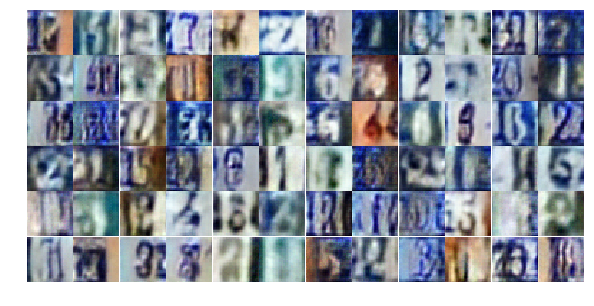

Epoch 7/25... Discriminator Loss: 0.6821... Generator Loss: 1.0893
Epoch 7/25... Discriminator Loss: 0.5178... Generator Loss: 1.8941
Epoch 7/25... Discriminator Loss: 0.6771... Generator Loss: 1.1430
Epoch 7/25... Discriminator Loss: 0.6739... Generator Loss: 1.1765
Epoch 7/25... Discriminator Loss: 0.5201... Generator Loss: 1.2395
Epoch 7/25... Discriminator Loss: 0.5647... Generator Loss: 1.2623
Epoch 7/25... Discriminator Loss: 0.4028... Generator Loss: 1.6207
Epoch 7/25... Discriminator Loss: 0.9193... Generator Loss: 0.8410
Epoch 7/25... Discriminator Loss: 0.4134... Generator Loss: 1.5365
Epoch 7/25... Discriminator Loss: 0.5047... Generator Loss: 1.5712


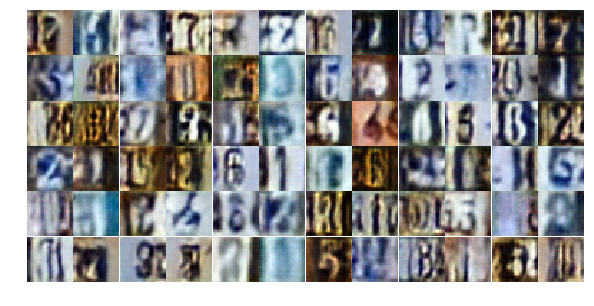

Epoch 7/25... Discriminator Loss: 0.8696... Generator Loss: 0.8115
Epoch 7/25... Discriminator Loss: 2.6610... Generator Loss: 0.3697
Epoch 7/25... Discriminator Loss: 0.9071... Generator Loss: 0.9809
Epoch 7/25... Discriminator Loss: 0.8434... Generator Loss: 0.9717
Epoch 7/25... Discriminator Loss: 0.7595... Generator Loss: 0.9453
Epoch 7/25... Discriminator Loss: 0.7282... Generator Loss: 1.1052
Epoch 7/25... Discriminator Loss: 0.5440... Generator Loss: 1.2569
Epoch 7/25... Discriminator Loss: 0.8135... Generator Loss: 0.9007
Epoch 7/25... Discriminator Loss: 0.8071... Generator Loss: 1.0881
Epoch 7/25... Discriminator Loss: 0.7998... Generator Loss: 2.1349


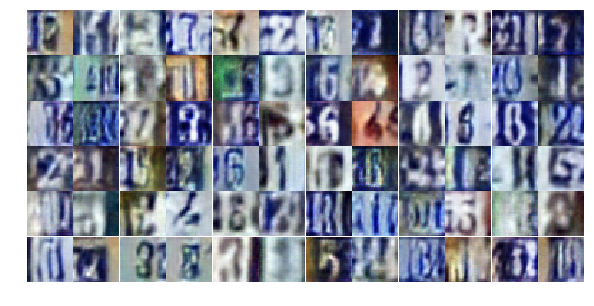

Epoch 7/25... Discriminator Loss: 1.6494... Generator Loss: 0.3092
Epoch 7/25... Discriminator Loss: 0.8489... Generator Loss: 1.5553
Epoch 7/25... Discriminator Loss: 0.4491... Generator Loss: 1.5879
Epoch 7/25... Discriminator Loss: 0.6109... Generator Loss: 1.1644
Epoch 7/25... Discriminator Loss: 0.7708... Generator Loss: 1.0225
Epoch 7/25... Discriminator Loss: 0.3778... Generator Loss: 1.7779
Epoch 7/25... Discriminator Loss: 0.5745... Generator Loss: 1.0993
Epoch 7/25... Discriminator Loss: 0.9473... Generator Loss: 0.7427
Epoch 7/25... Discriminator Loss: 0.5166... Generator Loss: 2.7679
Epoch 7/25... Discriminator Loss: 0.6751... Generator Loss: 0.9933


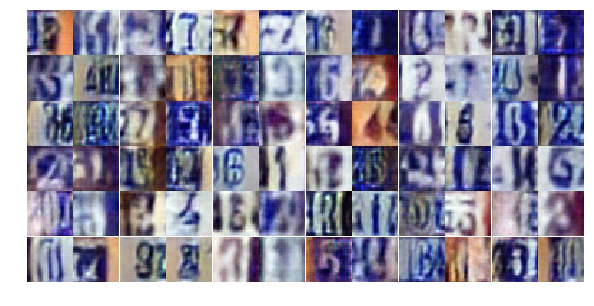

Epoch 7/25... Discriminator Loss: 0.5247... Generator Loss: 1.5815
Epoch 7/25... Discriminator Loss: 0.7407... Generator Loss: 1.0010
Epoch 7/25... Discriminator Loss: 0.6974... Generator Loss: 1.1873
Epoch 7/25... Discriminator Loss: 0.7324... Generator Loss: 0.9462
Epoch 7/25... Discriminator Loss: 0.5913... Generator Loss: 1.2031
Epoch 7/25... Discriminator Loss: 0.8381... Generator Loss: 0.8916
Epoch 7/25... Discriminator Loss: 1.4487... Generator Loss: 0.3946
Epoch 7/25... Discriminator Loss: 0.7575... Generator Loss: 0.9543
Epoch 7/25... Discriminator Loss: 0.8071... Generator Loss: 1.3778
Epoch 7/25... Discriminator Loss: 0.4104... Generator Loss: 1.5337


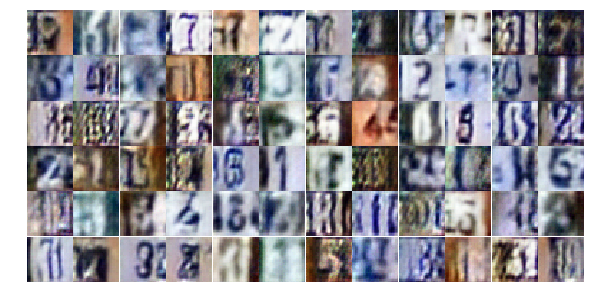

Epoch 7/25... Discriminator Loss: 0.4902... Generator Loss: 1.6932
Epoch 8/25... Discriminator Loss: 0.6585... Generator Loss: 1.0585
Epoch 8/25... Discriminator Loss: 0.9138... Generator Loss: 0.6763
Epoch 8/25... Discriminator Loss: 0.7989... Generator Loss: 0.9622
Epoch 8/25... Discriminator Loss: 0.6091... Generator Loss: 1.3931
Epoch 8/25... Discriminator Loss: 1.2082... Generator Loss: 2.2102
Epoch 8/25... Discriminator Loss: 0.6782... Generator Loss: 1.1863
Epoch 8/25... Discriminator Loss: 0.4643... Generator Loss: 1.5888
Epoch 8/25... Discriminator Loss: 1.0049... Generator Loss: 0.7613
Epoch 8/25... Discriminator Loss: 0.7381... Generator Loss: 0.9697


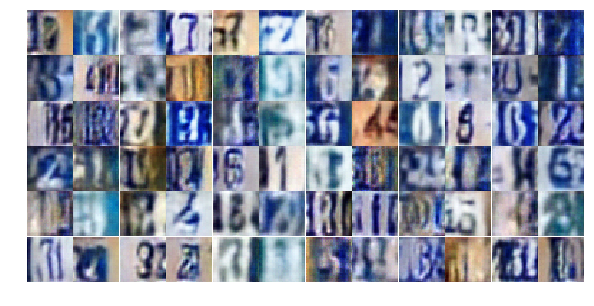

Epoch 8/25... Discriminator Loss: 0.6030... Generator Loss: 1.2932
Epoch 8/25... Discriminator Loss: 0.4212... Generator Loss: 1.5030
Epoch 8/25... Discriminator Loss: 0.6994... Generator Loss: 1.1258
Epoch 8/25... Discriminator Loss: 0.4832... Generator Loss: 1.4236
Epoch 8/25... Discriminator Loss: 0.7804... Generator Loss: 1.0211
Epoch 8/25... Discriminator Loss: 0.7372... Generator Loss: 2.6289
Epoch 8/25... Discriminator Loss: 0.6120... Generator Loss: 1.2671
Epoch 8/25... Discriminator Loss: 0.5476... Generator Loss: 1.3343
Epoch 8/25... Discriminator Loss: 0.9958... Generator Loss: 0.7121
Epoch 8/25... Discriminator Loss: 0.8822... Generator Loss: 0.8256


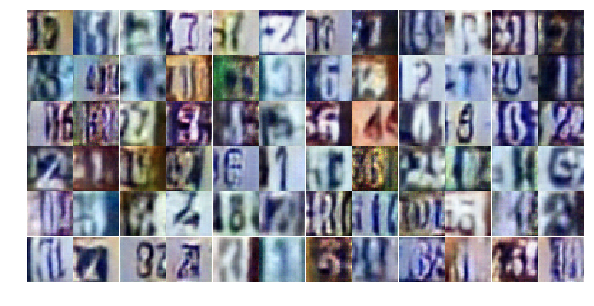

Epoch 8/25... Discriminator Loss: 0.5845... Generator Loss: 1.3345
Epoch 8/25... Discriminator Loss: 0.7787... Generator Loss: 0.8083
Epoch 8/25... Discriminator Loss: 0.6861... Generator Loss: 1.0003
Epoch 8/25... Discriminator Loss: 0.5853... Generator Loss: 1.3681
Epoch 8/25... Discriminator Loss: 0.4102... Generator Loss: 1.8508
Epoch 8/25... Discriminator Loss: 0.5542... Generator Loss: 1.8813
Epoch 8/25... Discriminator Loss: 1.0523... Generator Loss: 2.7085
Epoch 8/25... Discriminator Loss: 0.7581... Generator Loss: 1.3685
Epoch 8/25... Discriminator Loss: 1.1901... Generator Loss: 3.3041
Epoch 8/25... Discriminator Loss: 0.7176... Generator Loss: 2.1948


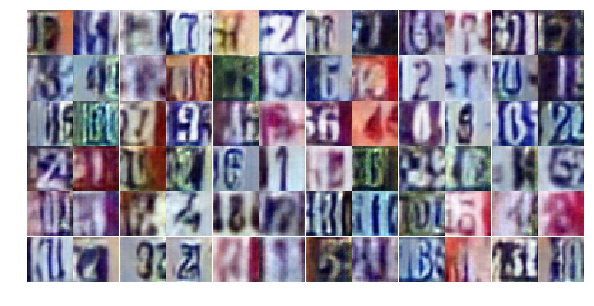

Epoch 8/25... Discriminator Loss: 0.6659... Generator Loss: 1.5796
Epoch 8/25... Discriminator Loss: 1.4397... Generator Loss: 0.3780
Epoch 8/25... Discriminator Loss: 0.5534... Generator Loss: 1.3467
Epoch 8/25... Discriminator Loss: 0.9327... Generator Loss: 0.6486
Epoch 8/25... Discriminator Loss: 0.4692... Generator Loss: 1.3443
Epoch 8/25... Discriminator Loss: 0.5600... Generator Loss: 1.2233
Epoch 8/25... Discriminator Loss: 0.6756... Generator Loss: 2.1415
Epoch 8/25... Discriminator Loss: 0.4268... Generator Loss: 1.4917
Epoch 8/25... Discriminator Loss: 0.9318... Generator Loss: 1.5250
Epoch 8/25... Discriminator Loss: 0.5812... Generator Loss: 1.7331


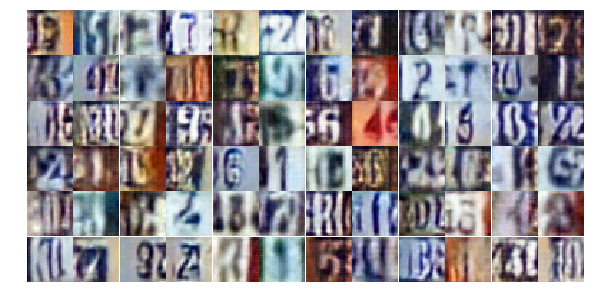

Epoch 8/25... Discriminator Loss: 0.4957... Generator Loss: 1.8437
Epoch 8/25... Discriminator Loss: 1.1987... Generator Loss: 0.4817
Epoch 8/25... Discriminator Loss: 0.6460... Generator Loss: 1.0002
Epoch 8/25... Discriminator Loss: 0.6863... Generator Loss: 1.0825
Epoch 8/25... Discriminator Loss: 0.8646... Generator Loss: 1.3014
Epoch 8/25... Discriminator Loss: 0.7639... Generator Loss: 0.9099
Epoch 8/25... Discriminator Loss: 0.4019... Generator Loss: 1.5745
Epoch 8/25... Discriminator Loss: 0.7076... Generator Loss: 1.7292
Epoch 8/25... Discriminator Loss: 0.6352... Generator Loss: 1.8200
Epoch 8/25... Discriminator Loss: 0.6046... Generator Loss: 1.0984


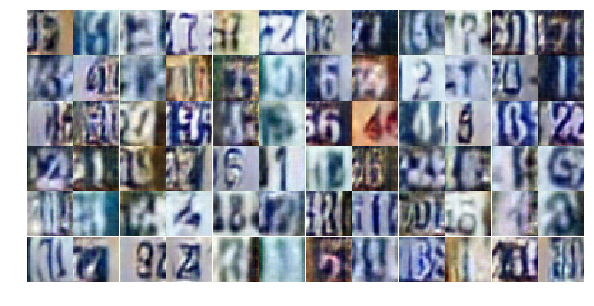

Epoch 8/25... Discriminator Loss: 0.5797... Generator Loss: 2.2459
Epoch 8/25... Discriminator Loss: 0.4931... Generator Loss: 1.3568
Epoch 8/25... Discriminator Loss: 0.4846... Generator Loss: 2.1126
Epoch 8/25... Discriminator Loss: 0.7895... Generator Loss: 0.8992
Epoch 8/25... Discriminator Loss: 0.6137... Generator Loss: 1.2068
Epoch 8/25... Discriminator Loss: 0.9674... Generator Loss: 0.6964
Epoch 8/25... Discriminator Loss: 0.9249... Generator Loss: 0.6665
Epoch 8/25... Discriminator Loss: 0.4629... Generator Loss: 1.8712
Epoch 9/25... Discriminator Loss: 0.9965... Generator Loss: 0.7088
Epoch 9/25... Discriminator Loss: 0.6557... Generator Loss: 1.6847


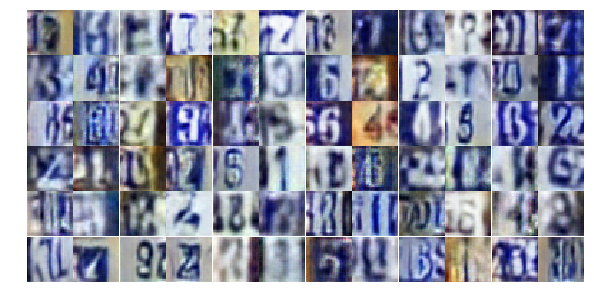

Epoch 9/25... Discriminator Loss: 0.9976... Generator Loss: 0.6373
Epoch 9/25... Discriminator Loss: 0.8160... Generator Loss: 0.7805
Epoch 9/25... Discriminator Loss: 1.1983... Generator Loss: 0.4967
Epoch 9/25... Discriminator Loss: 0.4879... Generator Loss: 4.1758
Epoch 9/25... Discriminator Loss: 1.1381... Generator Loss: 0.5489
Epoch 9/25... Discriminator Loss: 0.5268... Generator Loss: 1.4064
Epoch 9/25... Discriminator Loss: 0.6764... Generator Loss: 1.3701
Epoch 9/25... Discriminator Loss: 0.5467... Generator Loss: 1.1356
Epoch 9/25... Discriminator Loss: 0.7207... Generator Loss: 0.9549
Epoch 9/25... Discriminator Loss: 0.6284... Generator Loss: 1.4880


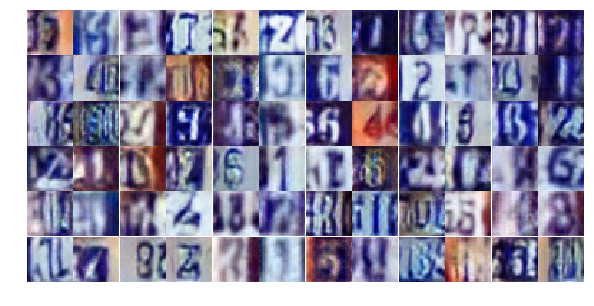

Epoch 9/25... Discriminator Loss: 0.9762... Generator Loss: 0.7322
Epoch 9/25... Discriminator Loss: 1.0273... Generator Loss: 0.7292
Epoch 9/25... Discriminator Loss: 0.8653... Generator Loss: 0.7768
Epoch 9/25... Discriminator Loss: 0.9211... Generator Loss: 0.7050
Epoch 9/25... Discriminator Loss: 0.5211... Generator Loss: 1.5557
Epoch 9/25... Discriminator Loss: 0.5640... Generator Loss: 1.3550
Epoch 9/25... Discriminator Loss: 0.7452... Generator Loss: 1.1125
Epoch 9/25... Discriminator Loss: 0.6677... Generator Loss: 1.1759
Epoch 9/25... Discriminator Loss: 1.1111... Generator Loss: 0.5499
Epoch 9/25... Discriminator Loss: 0.7510... Generator Loss: 1.0281


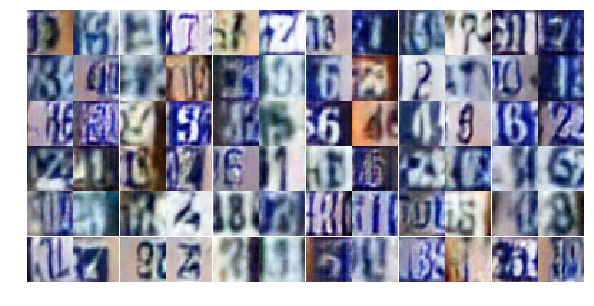

Epoch 9/25... Discriminator Loss: 1.4672... Generator Loss: 0.3728
Epoch 9/25... Discriminator Loss: 0.4630... Generator Loss: 1.8798
Epoch 9/25... Discriminator Loss: 0.6719... Generator Loss: 1.2632
Epoch 9/25... Discriminator Loss: 0.7889... Generator Loss: 0.8916
Epoch 9/25... Discriminator Loss: 0.5083... Generator Loss: 1.3190
Epoch 9/25... Discriminator Loss: 0.5326... Generator Loss: 1.4340
Epoch 9/25... Discriminator Loss: 1.1221... Generator Loss: 0.6150
Epoch 9/25... Discriminator Loss: 0.6039... Generator Loss: 1.2145
Epoch 9/25... Discriminator Loss: 0.6079... Generator Loss: 1.1130
Epoch 9/25... Discriminator Loss: 1.0387... Generator Loss: 0.5664


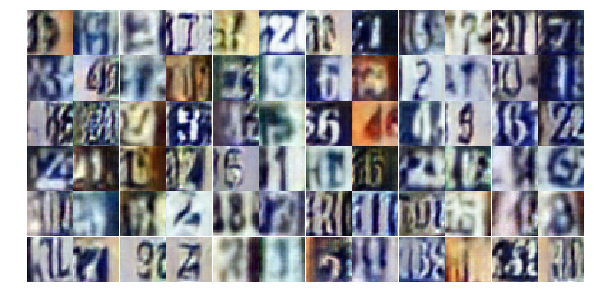

Epoch 9/25... Discriminator Loss: 0.7042... Generator Loss: 0.9242
Epoch 9/25... Discriminator Loss: 0.6715... Generator Loss: 1.0784
Epoch 9/25... Discriminator Loss: 0.7785... Generator Loss: 1.3589
Epoch 9/25... Discriminator Loss: 0.6870... Generator Loss: 1.1385
Epoch 9/25... Discriminator Loss: 0.7176... Generator Loss: 1.1047
Epoch 9/25... Discriminator Loss: 0.7484... Generator Loss: 0.9256
Epoch 9/25... Discriminator Loss: 0.8305... Generator Loss: 2.0599
Epoch 9/25... Discriminator Loss: 0.4644... Generator Loss: 1.2897
Epoch 9/25... Discriminator Loss: 0.7144... Generator Loss: 0.9654
Epoch 9/25... Discriminator Loss: 0.7711... Generator Loss: 0.8424


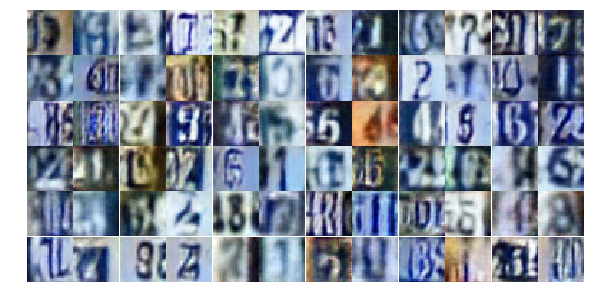

Epoch 9/25... Discriminator Loss: 0.6039... Generator Loss: 1.1233
Epoch 9/25... Discriminator Loss: 0.7826... Generator Loss: 0.8088
Epoch 9/25... Discriminator Loss: 1.9226... Generator Loss: 0.2336
Epoch 9/25... Discriminator Loss: 0.6752... Generator Loss: 2.3274
Epoch 9/25... Discriminator Loss: 0.7721... Generator Loss: 0.9562
Epoch 9/25... Discriminator Loss: 1.0607... Generator Loss: 0.5994
Epoch 9/25... Discriminator Loss: 0.6441... Generator Loss: 1.2155
Epoch 9/25... Discriminator Loss: 0.9372... Generator Loss: 0.6240
Epoch 9/25... Discriminator Loss: 0.7704... Generator Loss: 0.9291
Epoch 9/25... Discriminator Loss: 0.9145... Generator Loss: 2.9208


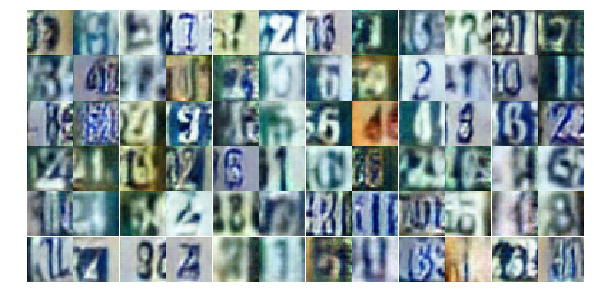

Epoch 9/25... Discriminator Loss: 1.3334... Generator Loss: 2.6757
Epoch 9/25... Discriminator Loss: 1.1074... Generator Loss: 2.3848
Epoch 9/25... Discriminator Loss: 0.9065... Generator Loss: 0.8161
Epoch 9/25... Discriminator Loss: 0.8601... Generator Loss: 0.9606
Epoch 9/25... Discriminator Loss: 0.6774... Generator Loss: 1.3830
Epoch 10/25... Discriminator Loss: 0.7424... Generator Loss: 0.9910
Epoch 10/25... Discriminator Loss: 0.7511... Generator Loss: 0.9654
Epoch 10/25... Discriminator Loss: 0.5599... Generator Loss: 1.4895
Epoch 10/25... Discriminator Loss: 0.7602... Generator Loss: 1.0682
Epoch 10/25... Discriminator Loss: 1.6130... Generator Loss: 0.3020


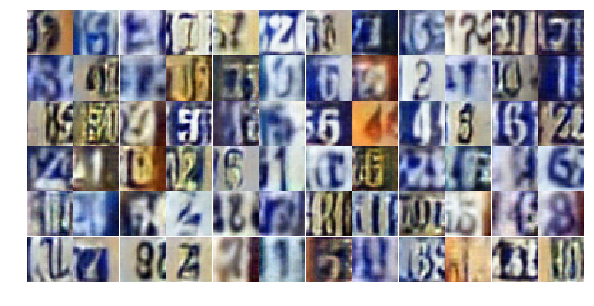

Epoch 10/25... Discriminator Loss: 0.8235... Generator Loss: 0.8436
Epoch 10/25... Discriminator Loss: 0.6123... Generator Loss: 1.3187
Epoch 10/25... Discriminator Loss: 0.5881... Generator Loss: 1.4054
Epoch 10/25... Discriminator Loss: 0.5771... Generator Loss: 2.1072
Epoch 10/25... Discriminator Loss: 0.5597... Generator Loss: 1.6309
Epoch 10/25... Discriminator Loss: 0.7570... Generator Loss: 1.0017
Epoch 10/25... Discriminator Loss: 0.6203... Generator Loss: 1.0642
Epoch 10/25... Discriminator Loss: 1.2688... Generator Loss: 0.4734
Epoch 10/25... Discriminator Loss: 0.8479... Generator Loss: 0.9039
Epoch 10/25... Discriminator Loss: 1.2115... Generator Loss: 0.5885


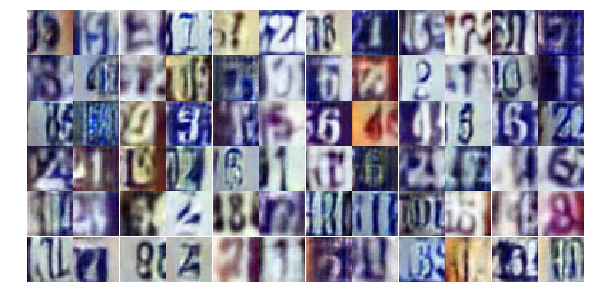

Epoch 10/25... Discriminator Loss: 0.7400... Generator Loss: 1.1404
Epoch 10/25... Discriminator Loss: 0.9706... Generator Loss: 0.6666
Epoch 10/25... Discriminator Loss: 0.7380... Generator Loss: 1.0563
Epoch 10/25... Discriminator Loss: 1.0254... Generator Loss: 0.6335
Epoch 10/25... Discriminator Loss: 0.6482... Generator Loss: 1.1287
Epoch 10/25... Discriminator Loss: 0.5021... Generator Loss: 1.4069
Epoch 10/25... Discriminator Loss: 0.6428... Generator Loss: 1.0064
Epoch 10/25... Discriminator Loss: 0.4852... Generator Loss: 1.8082
Epoch 10/25... Discriminator Loss: 0.7477... Generator Loss: 0.9529
Epoch 10/25... Discriminator Loss: 0.3856... Generator Loss: 2.6278


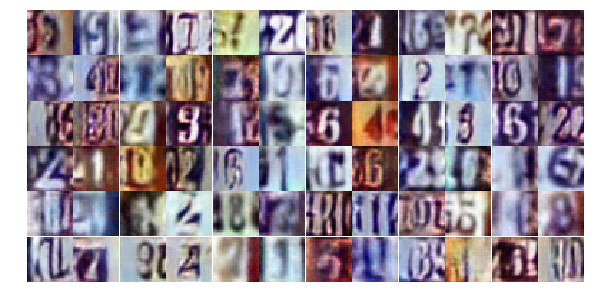

Epoch 10/25... Discriminator Loss: 1.2167... Generator Loss: 0.4810
Epoch 10/25... Discriminator Loss: 0.7724... Generator Loss: 0.9076
Epoch 10/25... Discriminator Loss: 0.4806... Generator Loss: 1.4121
Epoch 10/25... Discriminator Loss: 0.4446... Generator Loss: 2.7904
Epoch 10/25... Discriminator Loss: 1.7788... Generator Loss: 0.2670
Epoch 10/25... Discriminator Loss: 0.8588... Generator Loss: 1.3383
Epoch 10/25... Discriminator Loss: 0.3775... Generator Loss: 1.6710
Epoch 10/25... Discriminator Loss: 0.8164... Generator Loss: 1.0610
Epoch 10/25... Discriminator Loss: 0.8828... Generator Loss: 0.7298
Epoch 10/25... Discriminator Loss: 0.8381... Generator Loss: 0.8697


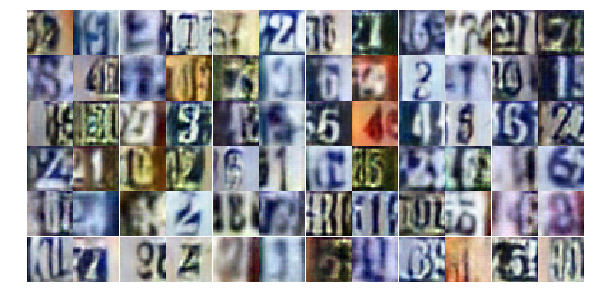

Epoch 10/25... Discriminator Loss: 0.5411... Generator Loss: 1.3725
Epoch 10/25... Discriminator Loss: 0.7106... Generator Loss: 1.0083
Epoch 10/25... Discriminator Loss: 0.5707... Generator Loss: 1.2851
Epoch 10/25... Discriminator Loss: 0.7770... Generator Loss: 2.2233
Epoch 10/25... Discriminator Loss: 0.9854... Generator Loss: 0.6533
Epoch 10/25... Discriminator Loss: 0.7407... Generator Loss: 1.3139
Epoch 10/25... Discriminator Loss: 0.6861... Generator Loss: 1.0485
Epoch 10/25... Discriminator Loss: 1.0467... Generator Loss: 0.5878
Epoch 10/25... Discriminator Loss: 0.7083... Generator Loss: 1.0247
Epoch 10/25... Discriminator Loss: 0.8504... Generator Loss: 2.6159


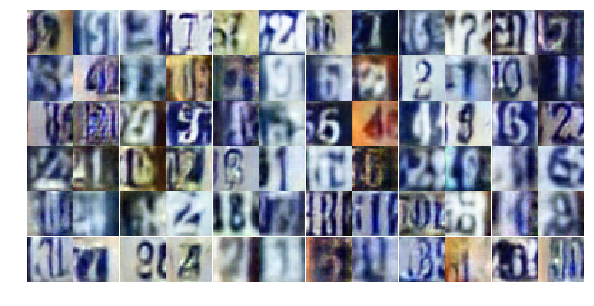

Epoch 10/25... Discriminator Loss: 1.0294... Generator Loss: 0.6115
Epoch 10/25... Discriminator Loss: 0.6495... Generator Loss: 1.0742
Epoch 10/25... Discriminator Loss: 1.0884... Generator Loss: 0.5750
Epoch 10/25... Discriminator Loss: 0.6975... Generator Loss: 1.0251
Epoch 10/25... Discriminator Loss: 0.5972... Generator Loss: 1.6699
Epoch 10/25... Discriminator Loss: 0.6859... Generator Loss: 1.2512
Epoch 10/25... Discriminator Loss: 0.5522... Generator Loss: 1.2718
Epoch 10/25... Discriminator Loss: 0.5541... Generator Loss: 1.1805
Epoch 10/25... Discriminator Loss: 0.4728... Generator Loss: 1.6176
Epoch 10/25... Discriminator Loss: 0.5585... Generator Loss: 1.5178


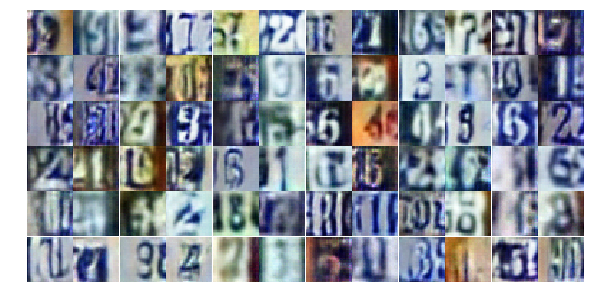

Epoch 10/25... Discriminator Loss: 0.8988... Generator Loss: 0.7199
Epoch 10/25... Discriminator Loss: 0.5718... Generator Loss: 1.1069
Epoch 10/25... Discriminator Loss: 0.4534... Generator Loss: 1.3485
Epoch 11/25... Discriminator Loss: 1.3427... Generator Loss: 0.4720
Epoch 11/25... Discriminator Loss: 0.5469... Generator Loss: 1.5072
Epoch 11/25... Discriminator Loss: 1.0301... Generator Loss: 0.5927
Epoch 11/25... Discriminator Loss: 0.7346... Generator Loss: 1.0005
Epoch 11/25... Discriminator Loss: 0.7882... Generator Loss: 0.9990
Epoch 11/25... Discriminator Loss: 1.3265... Generator Loss: 0.4293
Epoch 11/25... Discriminator Loss: 1.7196... Generator Loss: 0.3268


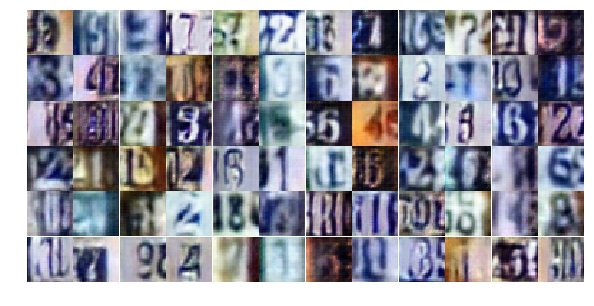

Epoch 11/25... Discriminator Loss: 0.5732... Generator Loss: 1.5254
Epoch 11/25... Discriminator Loss: 0.7100... Generator Loss: 1.3229
Epoch 11/25... Discriminator Loss: 0.7594... Generator Loss: 0.9371
Epoch 11/25... Discriminator Loss: 0.6051... Generator Loss: 1.3042
Epoch 11/25... Discriminator Loss: 0.8471... Generator Loss: 0.8762
Epoch 11/25... Discriminator Loss: 0.5029... Generator Loss: 1.5724
Epoch 11/25... Discriminator Loss: 0.7621... Generator Loss: 0.8948
Epoch 11/25... Discriminator Loss: 0.3199... Generator Loss: 2.3695
Epoch 11/25... Discriminator Loss: 0.9677... Generator Loss: 0.6808
Epoch 11/25... Discriminator Loss: 1.8230... Generator Loss: 0.2490


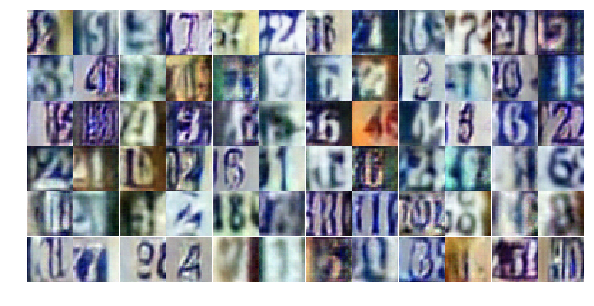

Epoch 11/25... Discriminator Loss: 0.9056... Generator Loss: 0.8060
Epoch 11/25... Discriminator Loss: 0.4442... Generator Loss: 1.9071
Epoch 11/25... Discriminator Loss: 0.7638... Generator Loss: 0.9583
Epoch 11/25... Discriminator Loss: 0.8392... Generator Loss: 0.8329
Epoch 11/25... Discriminator Loss: 0.3444... Generator Loss: 1.9723
Epoch 11/25... Discriminator Loss: 0.4085... Generator Loss: 1.9102
Epoch 11/25... Discriminator Loss: 0.7199... Generator Loss: 0.9689
Epoch 11/25... Discriminator Loss: 1.4214... Generator Loss: 0.4078
Epoch 11/25... Discriminator Loss: 0.4423... Generator Loss: 1.5803
Epoch 11/25... Discriminator Loss: 0.8561... Generator Loss: 0.7724


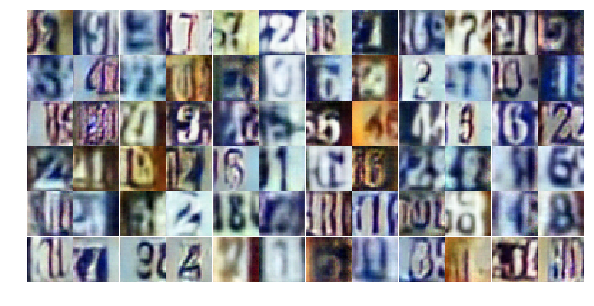

Epoch 11/25... Discriminator Loss: 0.8225... Generator Loss: 0.8601
Epoch 11/25... Discriminator Loss: 0.7199... Generator Loss: 1.0173
Epoch 11/25... Discriminator Loss: 0.7518... Generator Loss: 1.0349
Epoch 11/25... Discriminator Loss: 0.4338... Generator Loss: 1.8107
Epoch 11/25... Discriminator Loss: 0.6661... Generator Loss: 1.0500
Epoch 11/25... Discriminator Loss: 1.5802... Generator Loss: 0.3683
Epoch 11/25... Discriminator Loss: 1.0690... Generator Loss: 0.8805
Epoch 11/25... Discriminator Loss: 0.8309... Generator Loss: 0.8640
Epoch 11/25... Discriminator Loss: 0.5980... Generator Loss: 1.1355
Epoch 11/25... Discriminator Loss: 1.2173... Generator Loss: 0.4865


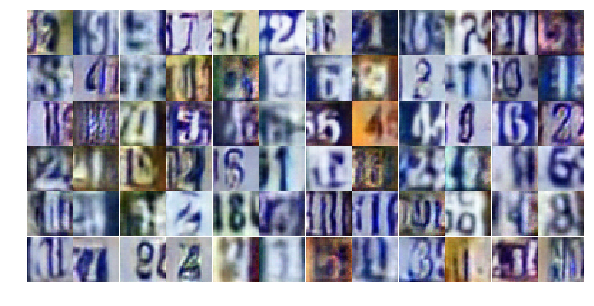

Epoch 11/25... Discriminator Loss: 0.5767... Generator Loss: 1.1708
Epoch 11/25... Discriminator Loss: 0.5125... Generator Loss: 1.2345
Epoch 11/25... Discriminator Loss: 1.1712... Generator Loss: 0.5859
Epoch 11/25... Discriminator Loss: 0.9496... Generator Loss: 0.7464
Epoch 11/25... Discriminator Loss: 0.9617... Generator Loss: 0.6288
Epoch 11/25... Discriminator Loss: 0.5511... Generator Loss: 1.7372
Epoch 11/25... Discriminator Loss: 0.3898... Generator Loss: 1.7760
Epoch 11/25... Discriminator Loss: 0.6193... Generator Loss: 1.1739
Epoch 11/25... Discriminator Loss: 1.4897... Generator Loss: 0.3588
Epoch 11/25... Discriminator Loss: 0.4689... Generator Loss: 1.3433


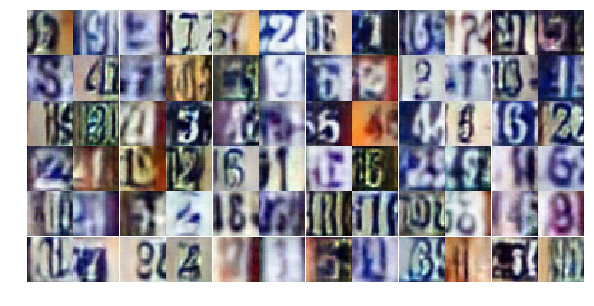

Epoch 11/25... Discriminator Loss: 0.7312... Generator Loss: 1.0185
Epoch 11/25... Discriminator Loss: 0.3688... Generator Loss: 1.8722
Epoch 11/25... Discriminator Loss: 0.5655... Generator Loss: 1.7249
Epoch 11/25... Discriminator Loss: 0.6730... Generator Loss: 0.9384
Epoch 11/25... Discriminator Loss: 1.4855... Generator Loss: 0.3797
Epoch 11/25... Discriminator Loss: 0.5114... Generator Loss: 1.3095
Epoch 11/25... Discriminator Loss: 1.7091... Generator Loss: 0.3681
Epoch 11/25... Discriminator Loss: 0.7044... Generator Loss: 1.3936
Epoch 11/25... Discriminator Loss: 0.9634... Generator Loss: 1.0173
Epoch 11/25... Discriminator Loss: 1.1592... Generator Loss: 0.5564


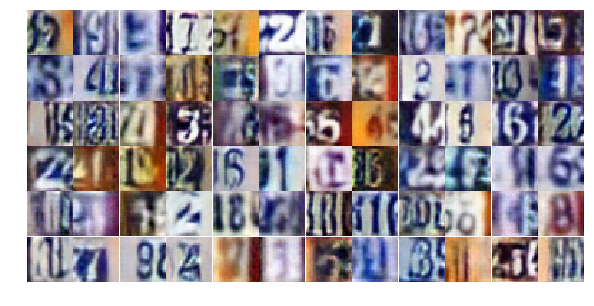

Epoch 12/25... Discriminator Loss: 0.6939... Generator Loss: 1.5522
Epoch 12/25... Discriminator Loss: 0.7592... Generator Loss: 0.9785
Epoch 12/25... Discriminator Loss: 1.0959... Generator Loss: 0.6103
Epoch 12/25... Discriminator Loss: 0.5346... Generator Loss: 1.3771
Epoch 12/25... Discriminator Loss: 0.5872... Generator Loss: 1.0876
Epoch 12/25... Discriminator Loss: 0.9245... Generator Loss: 0.6827
Epoch 12/25... Discriminator Loss: 0.7566... Generator Loss: 0.9773
Epoch 12/25... Discriminator Loss: 0.5893... Generator Loss: 1.2059
Epoch 12/25... Discriminator Loss: 0.6371... Generator Loss: 1.3539
Epoch 12/25... Discriminator Loss: 1.2776... Generator Loss: 0.4370


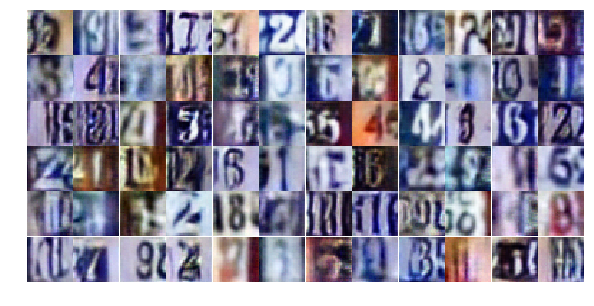

Epoch 12/25... Discriminator Loss: 0.6444... Generator Loss: 1.0639
Epoch 12/25... Discriminator Loss: 0.9475... Generator Loss: 0.6982
Epoch 12/25... Discriminator Loss: 0.6127... Generator Loss: 1.0344
Epoch 12/25... Discriminator Loss: 1.8061... Generator Loss: 0.2698
Epoch 12/25... Discriminator Loss: 0.5421... Generator Loss: 1.7013
Epoch 12/25... Discriminator Loss: 1.1578... Generator Loss: 0.5944
Epoch 12/25... Discriminator Loss: 1.3914... Generator Loss: 0.4126
Epoch 12/25... Discriminator Loss: 0.5171... Generator Loss: 1.9593
Epoch 12/25... Discriminator Loss: 0.4881... Generator Loss: 1.3092
Epoch 12/25... Discriminator Loss: 0.8447... Generator Loss: 0.7842


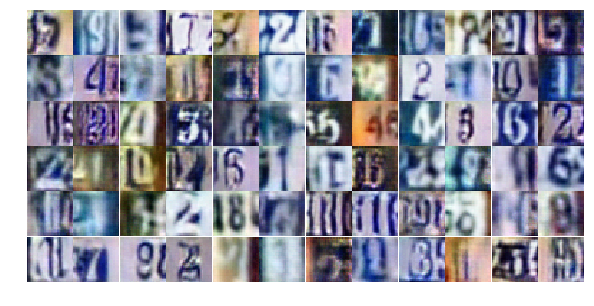

Epoch 12/25... Discriminator Loss: 0.4363... Generator Loss: 1.8081
Epoch 12/25... Discriminator Loss: 0.4156... Generator Loss: 1.4750
Epoch 12/25... Discriminator Loss: 0.4147... Generator Loss: 1.5842
Epoch 12/25... Discriminator Loss: 0.5035... Generator Loss: 1.5032
Epoch 12/25... Discriminator Loss: 0.4334... Generator Loss: 1.6707
Epoch 12/25... Discriminator Loss: 0.4054... Generator Loss: 1.5334
Epoch 12/25... Discriminator Loss: 0.6509... Generator Loss: 1.0613
Epoch 12/25... Discriminator Loss: 0.3867... Generator Loss: 1.5481
Epoch 12/25... Discriminator Loss: 0.7402... Generator Loss: 0.8930
Epoch 12/25... Discriminator Loss: 0.6068... Generator Loss: 1.2254


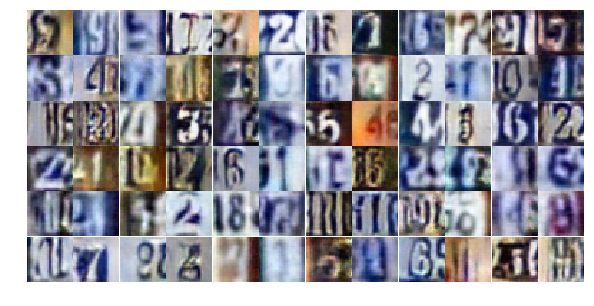

Epoch 12/25... Discriminator Loss: 0.5729... Generator Loss: 1.1871
Epoch 12/25... Discriminator Loss: 0.8402... Generator Loss: 0.9371
Epoch 12/25... Discriminator Loss: 0.7736... Generator Loss: 0.9387
Epoch 12/25... Discriminator Loss: 1.4482... Generator Loss: 0.4175
Epoch 12/25... Discriminator Loss: 1.0785... Generator Loss: 0.6107
Epoch 12/25... Discriminator Loss: 0.9809... Generator Loss: 0.6504
Epoch 12/25... Discriminator Loss: 1.0310... Generator Loss: 0.6100
Epoch 12/25... Discriminator Loss: 0.6983... Generator Loss: 1.3030
Epoch 12/25... Discriminator Loss: 0.5173... Generator Loss: 1.4108
Epoch 12/25... Discriminator Loss: 0.3168... Generator Loss: 1.7403


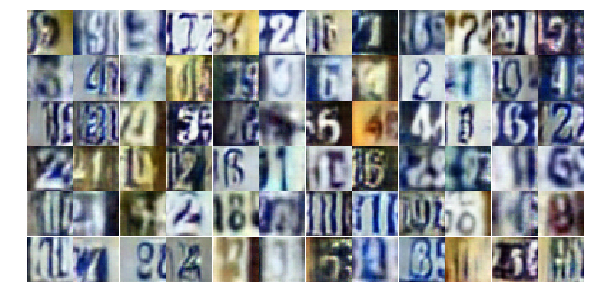

Epoch 12/25... Discriminator Loss: 0.6050... Generator Loss: 1.1945
Epoch 12/25... Discriminator Loss: 0.5993... Generator Loss: 1.1427
Epoch 12/25... Discriminator Loss: 0.5028... Generator Loss: 1.3869
Epoch 12/25... Discriminator Loss: 0.6200... Generator Loss: 1.1671
Epoch 12/25... Discriminator Loss: 0.7200... Generator Loss: 0.9573
Epoch 12/25... Discriminator Loss: 0.8491... Generator Loss: 0.7841
Epoch 12/25... Discriminator Loss: 0.6089... Generator Loss: 1.2511
Epoch 12/25... Discriminator Loss: 1.1626... Generator Loss: 0.5649
Epoch 12/25... Discriminator Loss: 0.5452... Generator Loss: 1.3337
Epoch 12/25... Discriminator Loss: 0.8752... Generator Loss: 0.8371


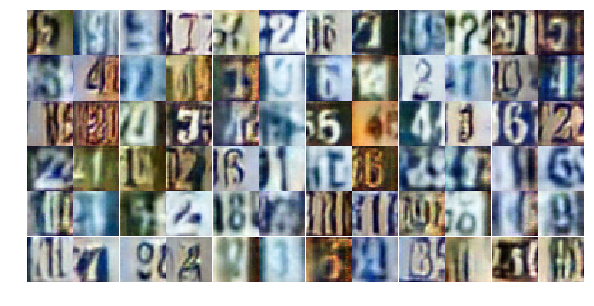

Epoch 12/25... Discriminator Loss: 0.9307... Generator Loss: 0.7862
Epoch 12/25... Discriminator Loss: 0.8620... Generator Loss: 0.7436
Epoch 12/25... Discriminator Loss: 0.7014... Generator Loss: 2.5519
Epoch 12/25... Discriminator Loss: 4.5062... Generator Loss: 0.0223
Epoch 12/25... Discriminator Loss: 0.5705... Generator Loss: 2.2804
Epoch 12/25... Discriminator Loss: 0.7643... Generator Loss: 2.4041
Epoch 12/25... Discriminator Loss: 1.0403... Generator Loss: 0.6795
Epoch 13/25... Discriminator Loss: 0.6891... Generator Loss: 1.0210
Epoch 13/25... Discriminator Loss: 0.4822... Generator Loss: 1.4891
Epoch 13/25... Discriminator Loss: 1.0632... Generator Loss: 0.6182


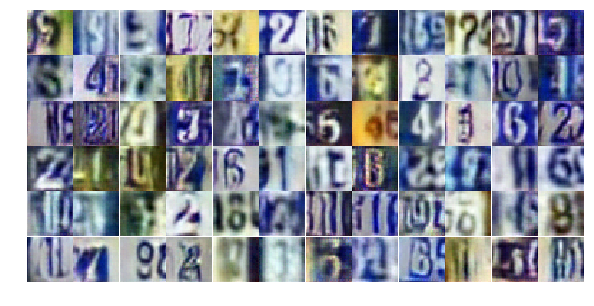

Epoch 13/25... Discriminator Loss: 0.6345... Generator Loss: 1.1708
Epoch 13/25... Discriminator Loss: 0.6971... Generator Loss: 1.4748
Epoch 13/25... Discriminator Loss: 1.1106... Generator Loss: 0.5913
Epoch 13/25... Discriminator Loss: 0.9763... Generator Loss: 0.7363
Epoch 13/25... Discriminator Loss: 0.6283... Generator Loss: 1.2007
Epoch 13/25... Discriminator Loss: 0.5292... Generator Loss: 1.6791
Epoch 13/25... Discriminator Loss: 0.4131... Generator Loss: 1.8157
Epoch 13/25... Discriminator Loss: 0.9215... Generator Loss: 0.7561
Epoch 13/25... Discriminator Loss: 0.5531... Generator Loss: 1.2662
Epoch 13/25... Discriminator Loss: 0.7326... Generator Loss: 0.8604


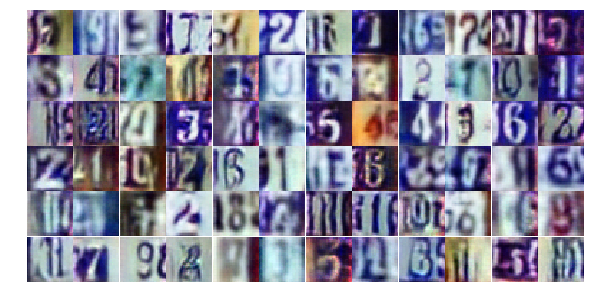

Epoch 13/25... Discriminator Loss: 0.6720... Generator Loss: 1.1647
Epoch 13/25... Discriminator Loss: 0.6203... Generator Loss: 2.3149
Epoch 13/25... Discriminator Loss: 1.0204... Generator Loss: 0.8268
Epoch 13/25... Discriminator Loss: 0.6163... Generator Loss: 1.2489
Epoch 13/25... Discriminator Loss: 0.5460... Generator Loss: 1.3580
Epoch 13/25... Discriminator Loss: 0.7414... Generator Loss: 0.8838
Epoch 13/25... Discriminator Loss: 0.6689... Generator Loss: 1.5355
Epoch 13/25... Discriminator Loss: 1.0101... Generator Loss: 0.6054
Epoch 13/25... Discriminator Loss: 0.5832... Generator Loss: 1.1391
Epoch 13/25... Discriminator Loss: 1.5852... Generator Loss: 0.3210


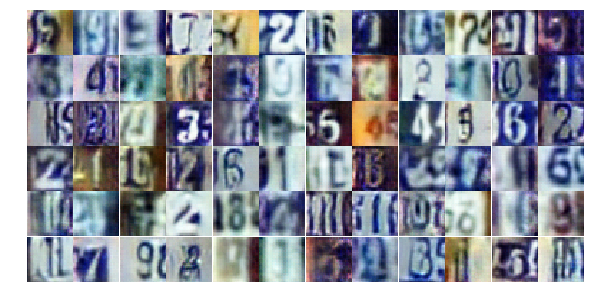

Epoch 13/25... Discriminator Loss: 0.8672... Generator Loss: 0.9365
Epoch 13/25... Discriminator Loss: 0.6126... Generator Loss: 1.2387
Epoch 13/25... Discriminator Loss: 0.6277... Generator Loss: 1.3468
Epoch 13/25... Discriminator Loss: 0.6720... Generator Loss: 1.0604
Epoch 13/25... Discriminator Loss: 0.7222... Generator Loss: 0.9866
Epoch 13/25... Discriminator Loss: 1.0801... Generator Loss: 0.5841
Epoch 13/25... Discriminator Loss: 1.1612... Generator Loss: 1.6634
Epoch 13/25... Discriminator Loss: 0.5283... Generator Loss: 1.3165
Epoch 13/25... Discriminator Loss: 0.5961... Generator Loss: 1.3687
Epoch 13/25... Discriminator Loss: 0.7215... Generator Loss: 1.6933


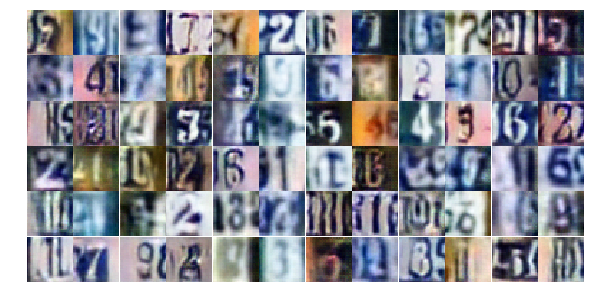

Epoch 13/25... Discriminator Loss: 0.9057... Generator Loss: 0.7849
Epoch 13/25... Discriminator Loss: 0.9297... Generator Loss: 0.9222
Epoch 13/25... Discriminator Loss: 1.0726... Generator Loss: 0.6321
Epoch 13/25... Discriminator Loss: 1.2523... Generator Loss: 0.4547
Epoch 13/25... Discriminator Loss: 0.6255... Generator Loss: 1.5223
Epoch 13/25... Discriminator Loss: 0.4525... Generator Loss: 1.3696
Epoch 13/25... Discriminator Loss: 0.5434... Generator Loss: 1.1742
Epoch 13/25... Discriminator Loss: 1.0551... Generator Loss: 0.5905
Epoch 13/25... Discriminator Loss: 0.6494... Generator Loss: 1.7896
Epoch 13/25... Discriminator Loss: 0.5255... Generator Loss: 1.3172


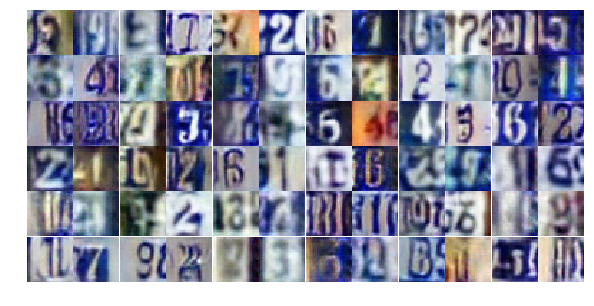

Epoch 13/25... Discriminator Loss: 0.5173... Generator Loss: 1.3126
Epoch 13/25... Discriminator Loss: 1.2098... Generator Loss: 0.5168
Epoch 13/25... Discriminator Loss: 0.9444... Generator Loss: 0.7272
Epoch 13/25... Discriminator Loss: 0.6073... Generator Loss: 1.4093
Epoch 13/25... Discriminator Loss: 1.2189... Generator Loss: 0.4879
Epoch 13/25... Discriminator Loss: 0.5817... Generator Loss: 1.5738
Epoch 13/25... Discriminator Loss: 0.9192... Generator Loss: 0.8398
Epoch 13/25... Discriminator Loss: 0.8409... Generator Loss: 0.8457
Epoch 13/25... Discriminator Loss: 0.9525... Generator Loss: 0.6738
Epoch 13/25... Discriminator Loss: 0.8489... Generator Loss: 0.7943


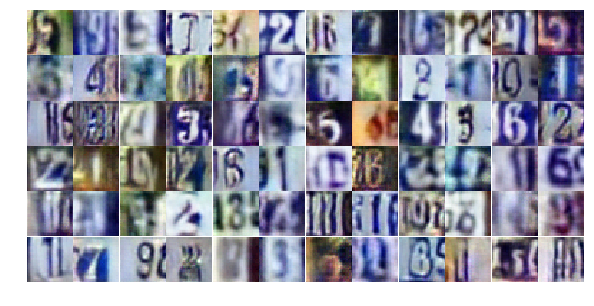

Epoch 13/25... Discriminator Loss: 0.4265... Generator Loss: 1.9938
Epoch 13/25... Discriminator Loss: 1.4320... Generator Loss: 0.3972
Epoch 13/25... Discriminator Loss: 0.7731... Generator Loss: 0.8972
Epoch 13/25... Discriminator Loss: 0.9041... Generator Loss: 0.7326
Epoch 14/25... Discriminator Loss: 0.6823... Generator Loss: 1.1129
Epoch 14/25... Discriminator Loss: 0.5933... Generator Loss: 1.5158
Epoch 14/25... Discriminator Loss: 0.9906... Generator Loss: 0.7008
Epoch 14/25... Discriminator Loss: 0.5711... Generator Loss: 2.0222
Epoch 14/25... Discriminator Loss: 0.5986... Generator Loss: 1.6450
Epoch 14/25... Discriminator Loss: 0.6200... Generator Loss: 1.1356


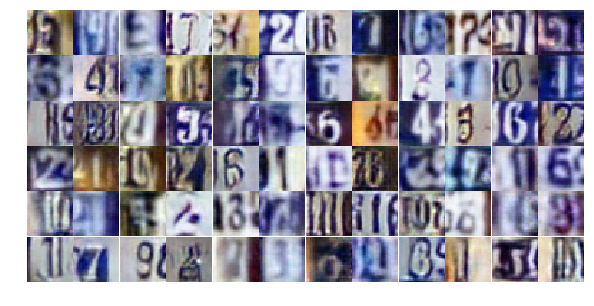

Epoch 14/25... Discriminator Loss: 0.7846... Generator Loss: 1.4676
Epoch 14/25... Discriminator Loss: 0.7358... Generator Loss: 0.9004
Epoch 14/25... Discriminator Loss: 0.7087... Generator Loss: 1.0026
Epoch 14/25... Discriminator Loss: 0.6465... Generator Loss: 1.0391
Epoch 14/25... Discriminator Loss: 1.1069... Generator Loss: 0.5682
Epoch 14/25... Discriminator Loss: 0.3984... Generator Loss: 1.4111
Epoch 14/25... Discriminator Loss: 0.4004... Generator Loss: 1.8769
Epoch 14/25... Discriminator Loss: 1.6504... Generator Loss: 0.2809
Epoch 14/25... Discriminator Loss: 1.5362... Generator Loss: 1.2405
Epoch 14/25... Discriminator Loss: 1.4842... Generator Loss: 0.4389


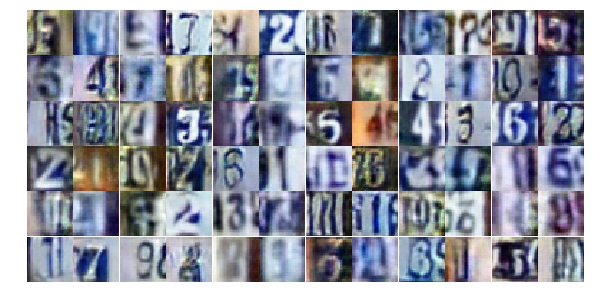

Epoch 14/25... Discriminator Loss: 0.7334... Generator Loss: 0.8607
Epoch 14/25... Discriminator Loss: 0.5373... Generator Loss: 1.5280
Epoch 14/25... Discriminator Loss: 0.7303... Generator Loss: 1.0037
Epoch 14/25... Discriminator Loss: 0.6395... Generator Loss: 1.2037
Epoch 14/25... Discriminator Loss: 0.8548... Generator Loss: 0.7942
Epoch 14/25... Discriminator Loss: 0.8874... Generator Loss: 0.8939
Epoch 14/25... Discriminator Loss: 0.7641... Generator Loss: 0.9704
Epoch 14/25... Discriminator Loss: 0.8243... Generator Loss: 0.8073
Epoch 14/25... Discriminator Loss: 0.5005... Generator Loss: 1.4562
Epoch 14/25... Discriminator Loss: 0.5942... Generator Loss: 1.3565


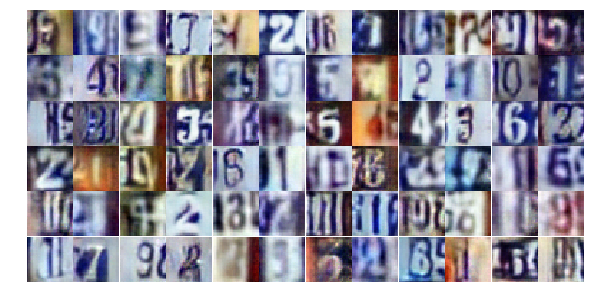

Epoch 14/25... Discriminator Loss: 1.4176... Generator Loss: 0.3864
Epoch 14/25... Discriminator Loss: 0.5922... Generator Loss: 1.1518
Epoch 14/25... Discriminator Loss: 0.6384... Generator Loss: 1.1638
Epoch 14/25... Discriminator Loss: 0.5182... Generator Loss: 1.1884
Epoch 14/25... Discriminator Loss: 0.7574... Generator Loss: 0.9490
Epoch 14/25... Discriminator Loss: 0.8496... Generator Loss: 0.8081
Epoch 14/25... Discriminator Loss: 0.8808... Generator Loss: 0.7355
Epoch 14/25... Discriminator Loss: 0.3567... Generator Loss: 1.7113
Epoch 14/25... Discriminator Loss: 0.4353... Generator Loss: 1.4862
Epoch 14/25... Discriminator Loss: 1.2194... Generator Loss: 0.5212


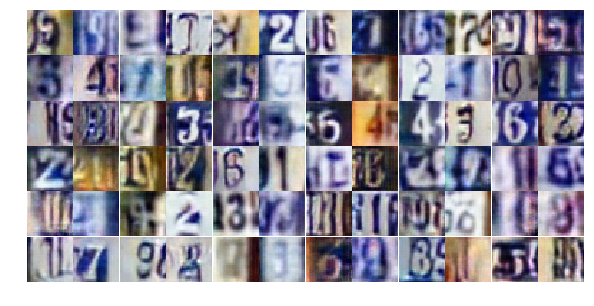

Epoch 14/25... Discriminator Loss: 1.4350... Generator Loss: 0.3786
Epoch 14/25... Discriminator Loss: 1.3580... Generator Loss: 0.4806
Epoch 14/25... Discriminator Loss: 0.7442... Generator Loss: 0.8667
Epoch 14/25... Discriminator Loss: 1.0510... Generator Loss: 0.5620
Epoch 14/25... Discriminator Loss: 0.8022... Generator Loss: 1.1358
Epoch 14/25... Discriminator Loss: 0.7280... Generator Loss: 1.0593
Epoch 14/25... Discriminator Loss: 0.8390... Generator Loss: 1.7914
Epoch 14/25... Discriminator Loss: 0.5376... Generator Loss: 1.3075
Epoch 14/25... Discriminator Loss: 1.2672... Generator Loss: 0.4410
Epoch 14/25... Discriminator Loss: 1.4020... Generator Loss: 0.4042


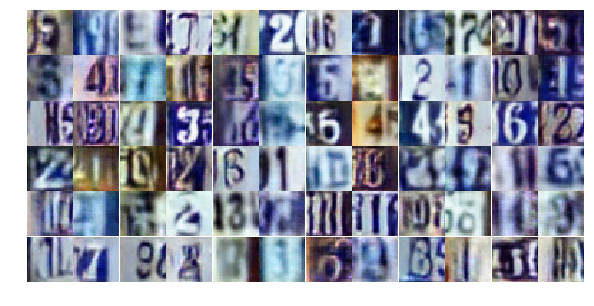

Epoch 14/25... Discriminator Loss: 0.9273... Generator Loss: 0.8730
Epoch 14/25... Discriminator Loss: 1.4759... Generator Loss: 0.3613
Epoch 14/25... Discriminator Loss: 0.5945... Generator Loss: 1.3862
Epoch 14/25... Discriminator Loss: 1.3729... Generator Loss: 0.4006
Epoch 14/25... Discriminator Loss: 0.6085... Generator Loss: 1.3136
Epoch 14/25... Discriminator Loss: 0.8402... Generator Loss: 0.8392
Epoch 14/25... Discriminator Loss: 0.7819... Generator Loss: 1.2835
Epoch 14/25... Discriminator Loss: 0.5884... Generator Loss: 1.9702
Epoch 14/25... Discriminator Loss: 1.2717... Generator Loss: 0.4673
Epoch 14/25... Discriminator Loss: 1.1960... Generator Loss: 0.5075


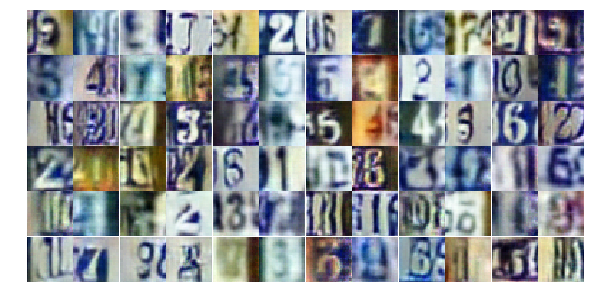

Epoch 14/25... Discriminator Loss: 0.7805... Generator Loss: 1.2206
Epoch 14/25... Discriminator Loss: 1.3322... Generator Loss: 0.4772
Epoch 15/25... Discriminator Loss: 1.3470... Generator Loss: 0.3931
Epoch 15/25... Discriminator Loss: 0.5651... Generator Loss: 1.2686
Epoch 15/25... Discriminator Loss: 0.7778... Generator Loss: 0.8431
Epoch 15/25... Discriminator Loss: 0.9983... Generator Loss: 0.7147
Epoch 15/25... Discriminator Loss: 1.2663... Generator Loss: 0.4951
Epoch 15/25... Discriminator Loss: 0.7072... Generator Loss: 0.9140
Epoch 15/25... Discriminator Loss: 1.4898... Generator Loss: 0.3550
Epoch 15/25... Discriminator Loss: 0.6122... Generator Loss: 1.2023


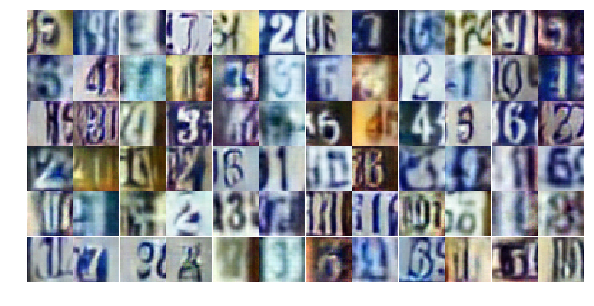

Epoch 15/25... Discriminator Loss: 0.9633... Generator Loss: 0.6827
Epoch 15/25... Discriminator Loss: 1.3056... Generator Loss: 2.5135
Epoch 15/25... Discriminator Loss: 0.9813... Generator Loss: 0.6597
Epoch 15/25... Discriminator Loss: 0.7034... Generator Loss: 0.9651
Epoch 15/25... Discriminator Loss: 0.8518... Generator Loss: 0.8170
Epoch 15/25... Discriminator Loss: 0.9125... Generator Loss: 0.7074
Epoch 15/25... Discriminator Loss: 1.7925... Generator Loss: 0.2803
Epoch 15/25... Discriminator Loss: 0.7597... Generator Loss: 1.7644
Epoch 15/25... Discriminator Loss: 0.7978... Generator Loss: 2.6097
Epoch 15/25... Discriminator Loss: 1.3135... Generator Loss: 0.4523


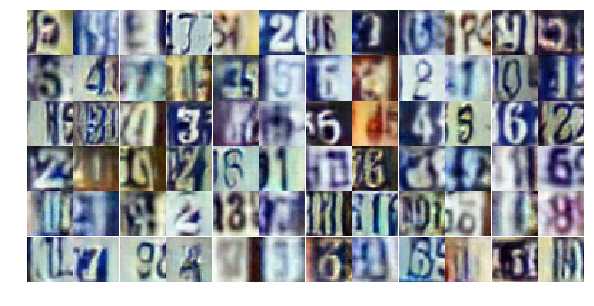

Epoch 15/25... Discriminator Loss: 0.9047... Generator Loss: 0.9017
Epoch 15/25... Discriminator Loss: 0.7175... Generator Loss: 0.9380
Epoch 15/25... Discriminator Loss: 0.6153... Generator Loss: 1.1888
Epoch 15/25... Discriminator Loss: 1.1409... Generator Loss: 0.5709
Epoch 15/25... Discriminator Loss: 1.3237... Generator Loss: 2.5019
Epoch 15/25... Discriminator Loss: 0.5750... Generator Loss: 1.5040
Epoch 15/25... Discriminator Loss: 1.0812... Generator Loss: 0.6844
Epoch 15/25... Discriminator Loss: 1.1386... Generator Loss: 0.5083
Epoch 15/25... Discriminator Loss: 0.6323... Generator Loss: 1.1468
Epoch 15/25... Discriminator Loss: 1.4341... Generator Loss: 0.4426


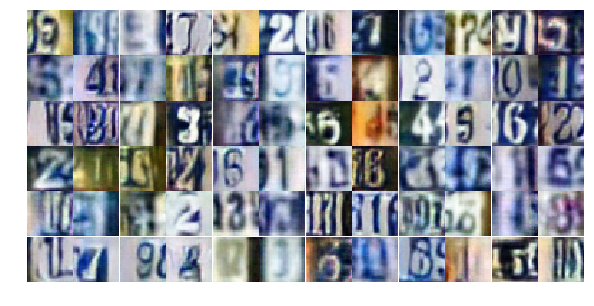

Epoch 15/25... Discriminator Loss: 0.7391... Generator Loss: 0.9892
Epoch 15/25... Discriminator Loss: 0.8887... Generator Loss: 0.7610
Epoch 15/25... Discriminator Loss: 0.4325... Generator Loss: 1.5662
Epoch 15/25... Discriminator Loss: 0.6185... Generator Loss: 1.2963
Epoch 15/25... Discriminator Loss: 0.6137... Generator Loss: 1.3285
Epoch 15/25... Discriminator Loss: 1.3530... Generator Loss: 3.7387
Epoch 15/25... Discriminator Loss: 0.6316... Generator Loss: 1.2069
Epoch 15/25... Discriminator Loss: 0.6994... Generator Loss: 0.9670
Epoch 15/25... Discriminator Loss: 0.4879... Generator Loss: 1.4336
Epoch 15/25... Discriminator Loss: 0.8454... Generator Loss: 1.4643


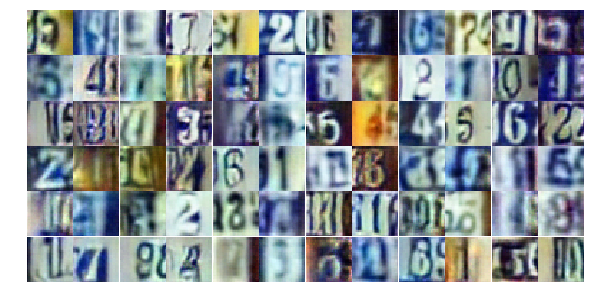

Epoch 15/25... Discriminator Loss: 0.5652... Generator Loss: 1.1599
Epoch 15/25... Discriminator Loss: 1.2564... Generator Loss: 0.5703
Epoch 15/25... Discriminator Loss: 0.5702... Generator Loss: 1.3400
Epoch 15/25... Discriminator Loss: 0.5984... Generator Loss: 1.2974
Epoch 15/25... Discriminator Loss: 0.8605... Generator Loss: 0.7570
Epoch 15/25... Discriminator Loss: 1.5362... Generator Loss: 0.3919
Epoch 15/25... Discriminator Loss: 0.5960... Generator Loss: 1.4703
Epoch 15/25... Discriminator Loss: 0.9949... Generator Loss: 0.6516
Epoch 15/25... Discriminator Loss: 0.9454... Generator Loss: 0.6756
Epoch 15/25... Discriminator Loss: 0.7437... Generator Loss: 1.0369


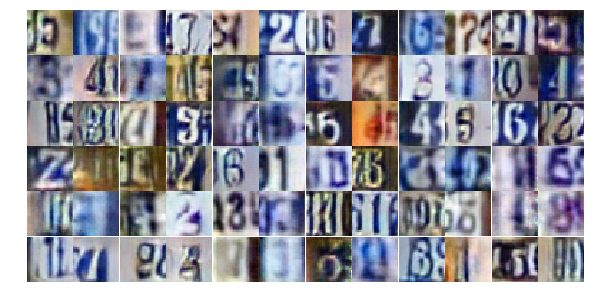

Epoch 15/25... Discriminator Loss: 0.8941... Generator Loss: 0.7512
Epoch 15/25... Discriminator Loss: 0.7062... Generator Loss: 1.3548
Epoch 15/25... Discriminator Loss: 0.5889... Generator Loss: 1.4115
Epoch 15/25... Discriminator Loss: 0.7077... Generator Loss: 1.4708
Epoch 15/25... Discriminator Loss: 0.5985... Generator Loss: 2.2112
Epoch 15/25... Discriminator Loss: 0.8678... Generator Loss: 1.8744
Epoch 15/25... Discriminator Loss: 0.9033... Generator Loss: 0.7835
Epoch 15/25... Discriminator Loss: 0.7495... Generator Loss: 0.9886
Epoch 15/25... Discriminator Loss: 1.1283... Generator Loss: 1.0533
Epoch 16/25... Discriminator Loss: 1.0160... Generator Loss: 0.6905


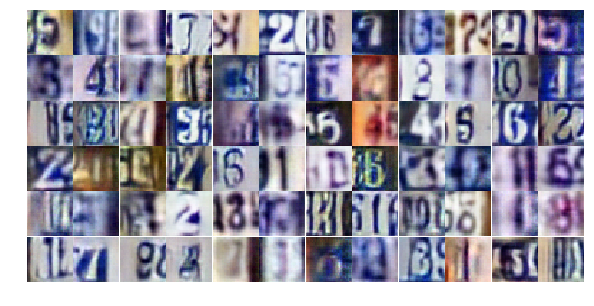

Epoch 16/25... Discriminator Loss: 0.7627... Generator Loss: 0.9203
Epoch 16/25... Discriminator Loss: 0.6589... Generator Loss: 1.2818
Epoch 16/25... Discriminator Loss: 0.7800... Generator Loss: 0.9182
Epoch 16/25... Discriminator Loss: 0.4948... Generator Loss: 1.5733
Epoch 16/25... Discriminator Loss: 0.6976... Generator Loss: 1.5638
Epoch 16/25... Discriminator Loss: 0.7512... Generator Loss: 1.0952
Epoch 16/25... Discriminator Loss: 1.3924... Generator Loss: 0.4365
Epoch 16/25... Discriminator Loss: 1.0633... Generator Loss: 0.5819
Epoch 16/25... Discriminator Loss: 0.6531... Generator Loss: 1.0628
Epoch 16/25... Discriminator Loss: 0.8505... Generator Loss: 0.8294


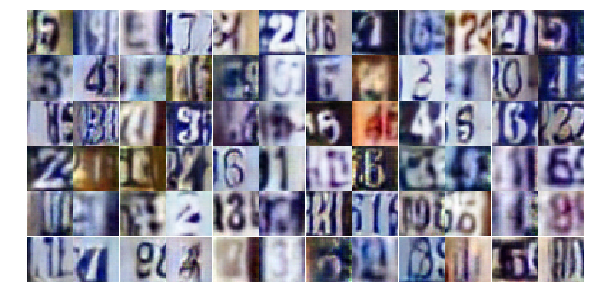

Epoch 16/25... Discriminator Loss: 1.1065... Generator Loss: 0.7351
Epoch 16/25... Discriminator Loss: 0.6872... Generator Loss: 1.0253
Epoch 16/25... Discriminator Loss: 0.7016... Generator Loss: 1.0866
Epoch 16/25... Discriminator Loss: 1.4166... Generator Loss: 0.3627
Epoch 16/25... Discriminator Loss: 0.5858... Generator Loss: 1.2654
Epoch 16/25... Discriminator Loss: 0.7927... Generator Loss: 0.8116
Epoch 16/25... Discriminator Loss: 1.5244... Generator Loss: 0.4072
Epoch 16/25... Discriminator Loss: 0.5288... Generator Loss: 1.5656
Epoch 16/25... Discriminator Loss: 0.6190... Generator Loss: 1.1832
Epoch 16/25... Discriminator Loss: 0.6361... Generator Loss: 1.2267


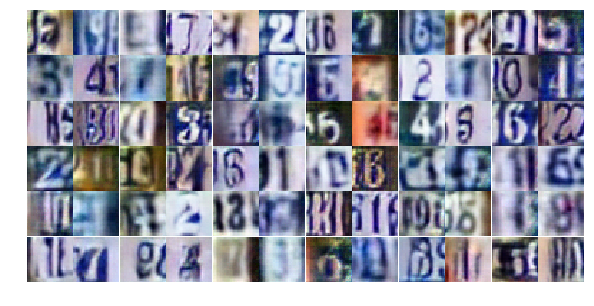

Epoch 16/25... Discriminator Loss: 0.6491... Generator Loss: 1.2537
Epoch 16/25... Discriminator Loss: 0.7321... Generator Loss: 1.2168
Epoch 16/25... Discriminator Loss: 0.7048... Generator Loss: 1.1517
Epoch 16/25... Discriminator Loss: 1.3410... Generator Loss: 0.4176
Epoch 16/25... Discriminator Loss: 0.8925... Generator Loss: 0.8733
Epoch 16/25... Discriminator Loss: 0.8126... Generator Loss: 0.8105
Epoch 16/25... Discriminator Loss: 0.7935... Generator Loss: 0.8039
Epoch 16/25... Discriminator Loss: 0.7185... Generator Loss: 0.8912
Epoch 16/25... Discriminator Loss: 0.9076... Generator Loss: 1.2704
Epoch 16/25... Discriminator Loss: 0.6766... Generator Loss: 0.9618


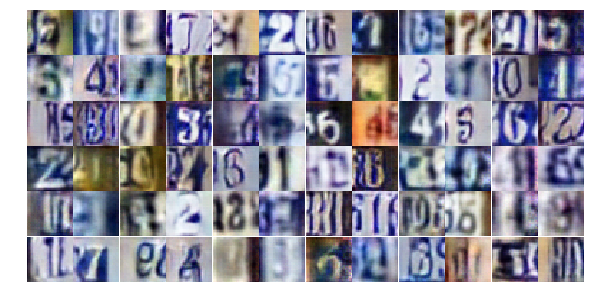

Epoch 16/25... Discriminator Loss: 0.5452... Generator Loss: 1.1652
Epoch 16/25... Discriminator Loss: 0.5302... Generator Loss: 1.2153
Epoch 16/25... Discriminator Loss: 0.6956... Generator Loss: 2.3403
Epoch 16/25... Discriminator Loss: 1.2758... Generator Loss: 3.0801
Epoch 16/25... Discriminator Loss: 0.9524... Generator Loss: 1.9066
Epoch 16/25... Discriminator Loss: 0.6933... Generator Loss: 1.4033
Epoch 16/25... Discriminator Loss: 0.7795... Generator Loss: 0.8457
Epoch 16/25... Discriminator Loss: 1.5817... Generator Loss: 0.3035
Epoch 16/25... Discriminator Loss: 0.6521... Generator Loss: 1.1474
Epoch 16/25... Discriminator Loss: 0.5655... Generator Loss: 1.3201


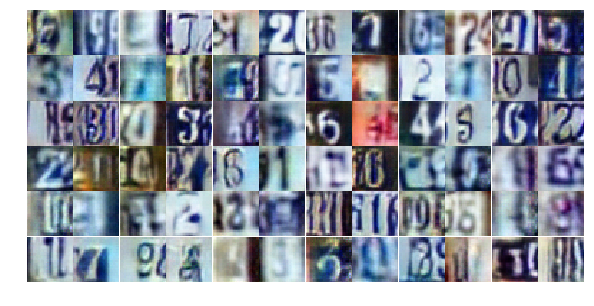

Epoch 16/25... Discriminator Loss: 0.4151... Generator Loss: 1.6041
Epoch 16/25... Discriminator Loss: 0.5943... Generator Loss: 1.1982
Epoch 16/25... Discriminator Loss: 1.7902... Generator Loss: 0.3332
Epoch 16/25... Discriminator Loss: 0.7626... Generator Loss: 2.1326
Epoch 16/25... Discriminator Loss: 0.6683... Generator Loss: 0.9843
Epoch 16/25... Discriminator Loss: 1.3068... Generator Loss: 0.4462
Epoch 16/25... Discriminator Loss: 0.5414... Generator Loss: 1.3630
Epoch 16/25... Discriminator Loss: 0.7608... Generator Loss: 0.9201
Epoch 16/25... Discriminator Loss: 0.3342... Generator Loss: 1.9229
Epoch 16/25... Discriminator Loss: 0.9017... Generator Loss: 0.7503


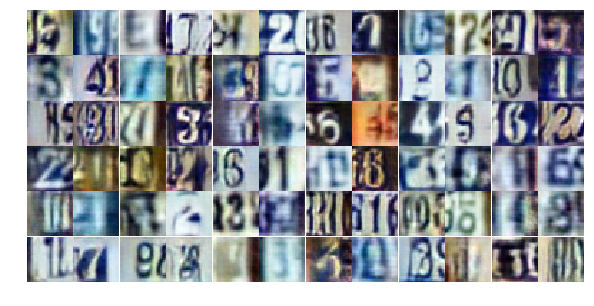

Epoch 16/25... Discriminator Loss: 1.3102... Generator Loss: 0.4803
Epoch 16/25... Discriminator Loss: 0.6952... Generator Loss: 1.0113
Epoch 16/25... Discriminator Loss: 2.4531... Generator Loss: 0.1802
Epoch 16/25... Discriminator Loss: 0.5671... Generator Loss: 2.3177
Epoch 16/25... Discriminator Loss: 0.5834... Generator Loss: 2.0555
Epoch 16/25... Discriminator Loss: 0.7366... Generator Loss: 1.1017
Epoch 17/25... Discriminator Loss: 0.7315... Generator Loss: 1.1165
Epoch 17/25... Discriminator Loss: 0.8207... Generator Loss: 0.8309
Epoch 17/25... Discriminator Loss: 0.7527... Generator Loss: 1.0436
Epoch 17/25... Discriminator Loss: 0.7251... Generator Loss: 0.9957


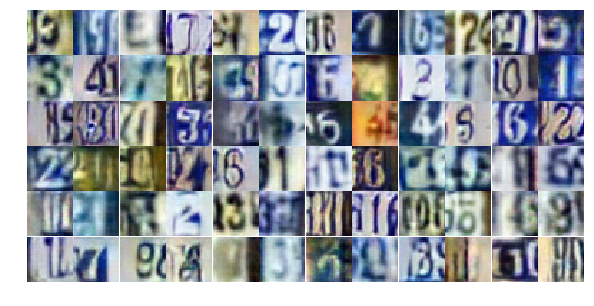

Epoch 17/25... Discriminator Loss: 0.4904... Generator Loss: 1.4815
Epoch 17/25... Discriminator Loss: 0.4959... Generator Loss: 1.3060
Epoch 17/25... Discriminator Loss: 0.7756... Generator Loss: 1.1226
Epoch 17/25... Discriminator Loss: 0.7119... Generator Loss: 1.0349
Epoch 17/25... Discriminator Loss: 1.0922... Generator Loss: 0.5618
Epoch 17/25... Discriminator Loss: 0.8441... Generator Loss: 1.1444
Epoch 17/25... Discriminator Loss: 0.6953... Generator Loss: 1.7185
Epoch 17/25... Discriminator Loss: 0.9144... Generator Loss: 0.7305
Epoch 17/25... Discriminator Loss: 0.5473... Generator Loss: 1.3615
Epoch 17/25... Discriminator Loss: 0.6556... Generator Loss: 1.3596


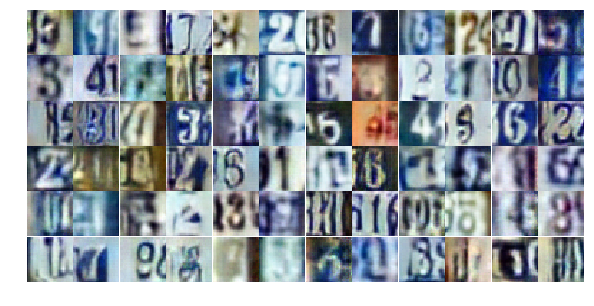

Epoch 17/25... Discriminator Loss: 0.6803... Generator Loss: 1.5519
Epoch 17/25... Discriminator Loss: 0.6357... Generator Loss: 1.9045
Epoch 17/25... Discriminator Loss: 0.6777... Generator Loss: 1.1094
Epoch 17/25... Discriminator Loss: 0.7437... Generator Loss: 1.0023
Epoch 17/25... Discriminator Loss: 0.6076... Generator Loss: 1.2695
Epoch 17/25... Discriminator Loss: 1.5584... Generator Loss: 0.3276
Epoch 17/25... Discriminator Loss: 0.6715... Generator Loss: 1.1370
Epoch 17/25... Discriminator Loss: 0.7042... Generator Loss: 1.0001
Epoch 17/25... Discriminator Loss: 0.7631... Generator Loss: 0.8602
Epoch 17/25... Discriminator Loss: 0.4629... Generator Loss: 1.4733


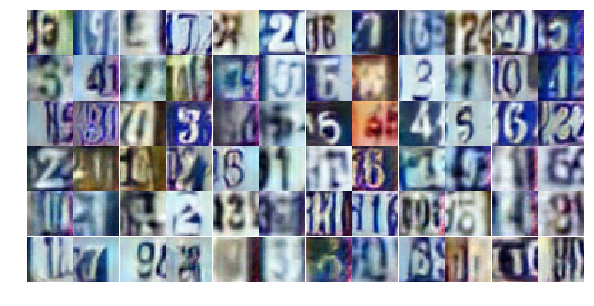

Epoch 17/25... Discriminator Loss: 1.7208... Generator Loss: 0.2912
Epoch 17/25... Discriminator Loss: 0.5260... Generator Loss: 1.4151
Epoch 17/25... Discriminator Loss: 0.4684... Generator Loss: 1.5671
Epoch 17/25... Discriminator Loss: 0.8192... Generator Loss: 0.8454
Epoch 17/25... Discriminator Loss: 1.5037... Generator Loss: 0.3753
Epoch 17/25... Discriminator Loss: 0.5909... Generator Loss: 1.0871
Epoch 17/25... Discriminator Loss: 0.6639... Generator Loss: 1.0853
Epoch 17/25... Discriminator Loss: 1.2466... Generator Loss: 0.4530
Epoch 17/25... Discriminator Loss: 1.0315... Generator Loss: 0.7398
Epoch 17/25... Discriminator Loss: 0.6744... Generator Loss: 1.0179


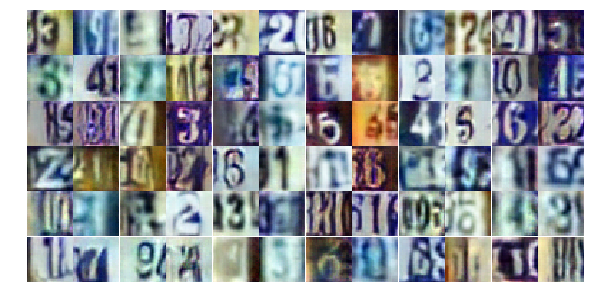

Epoch 17/25... Discriminator Loss: 0.7028... Generator Loss: 1.1722
Epoch 17/25... Discriminator Loss: 0.8583... Generator Loss: 1.7964
Epoch 17/25... Discriminator Loss: 0.8524... Generator Loss: 1.7746
Epoch 17/25... Discriminator Loss: 0.8547... Generator Loss: 0.8263
Epoch 17/25... Discriminator Loss: 1.3088... Generator Loss: 0.4526
Epoch 17/25... Discriminator Loss: 0.7088... Generator Loss: 1.4712
Epoch 17/25... Discriminator Loss: 0.7009... Generator Loss: 1.1882
Epoch 17/25... Discriminator Loss: 0.5611... Generator Loss: 1.2807
Epoch 17/25... Discriminator Loss: 0.2738... Generator Loss: 2.4697
Epoch 17/25... Discriminator Loss: 0.8326... Generator Loss: 0.8149


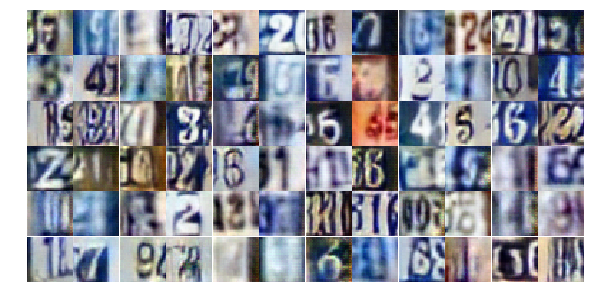

Epoch 17/25... Discriminator Loss: 1.1066... Generator Loss: 0.6504
Epoch 17/25... Discriminator Loss: 0.3035... Generator Loss: 2.1038
Epoch 17/25... Discriminator Loss: 1.0144... Generator Loss: 2.7133
Epoch 17/25... Discriminator Loss: 0.6063... Generator Loss: 1.4397
Epoch 17/25... Discriminator Loss: 0.6440... Generator Loss: 1.1805
Epoch 17/25... Discriminator Loss: 1.0456... Generator Loss: 0.6026
Epoch 17/25... Discriminator Loss: 0.9672... Generator Loss: 0.6543
Epoch 17/25... Discriminator Loss: 0.9510... Generator Loss: 0.7750
Epoch 17/25... Discriminator Loss: 0.8260... Generator Loss: 0.8297
Epoch 17/25... Discriminator Loss: 1.0310... Generator Loss: 0.6535


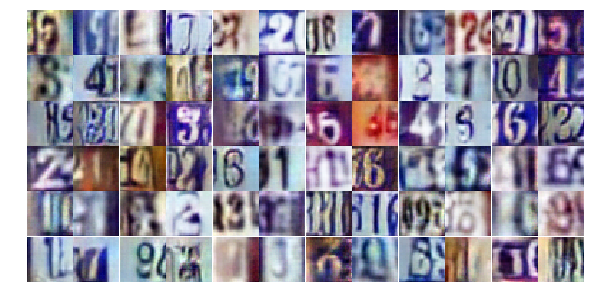

Epoch 17/25... Discriminator Loss: 0.8795... Generator Loss: 1.0028
Epoch 17/25... Discriminator Loss: 1.2792... Generator Loss: 2.6964
Epoch 17/25... Discriminator Loss: 0.3924... Generator Loss: 3.6169
Epoch 17/25... Discriminator Loss: 0.6745... Generator Loss: 1.1272
Epoch 18/25... Discriminator Loss: 1.1669... Generator Loss: 0.5240
Epoch 18/25... Discriminator Loss: 1.2270... Generator Loss: 0.4826
Epoch 18/25... Discriminator Loss: 0.6230... Generator Loss: 1.2397
Epoch 18/25... Discriminator Loss: 0.5556... Generator Loss: 1.2478
Epoch 18/25... Discriminator Loss: 1.3188... Generator Loss: 0.4568
Epoch 18/25... Discriminator Loss: 0.8258... Generator Loss: 1.0450


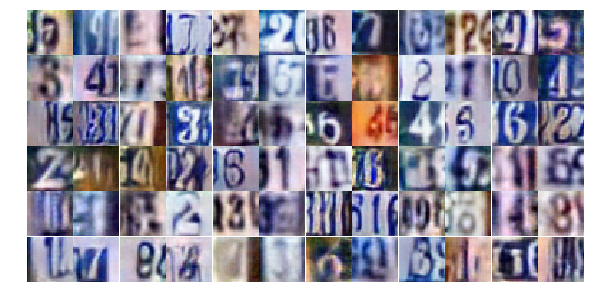

Epoch 18/25... Discriminator Loss: 0.4946... Generator Loss: 1.3511
Epoch 18/25... Discriminator Loss: 1.4604... Generator Loss: 0.3884
Epoch 18/25... Discriminator Loss: 1.3446... Generator Loss: 0.4057
Epoch 18/25... Discriminator Loss: 0.3892... Generator Loss: 1.8425
Epoch 18/25... Discriminator Loss: 0.7675... Generator Loss: 0.8812
Epoch 18/25... Discriminator Loss: 1.4645... Generator Loss: 0.3850
Epoch 18/25... Discriminator Loss: 0.6184... Generator Loss: 1.0396
Epoch 18/25... Discriminator Loss: 0.9181... Generator Loss: 0.6998
Epoch 18/25... Discriminator Loss: 0.7734... Generator Loss: 0.9458
Epoch 18/25... Discriminator Loss: 0.2801... Generator Loss: 2.2261


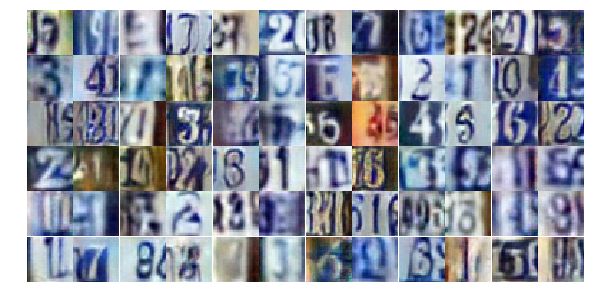

Epoch 18/25... Discriminator Loss: 0.8733... Generator Loss: 0.8237
Epoch 18/25... Discriminator Loss: 0.6207... Generator Loss: 1.2555
Epoch 18/25... Discriminator Loss: 1.2801... Generator Loss: 0.5297
Epoch 18/25... Discriminator Loss: 0.5182... Generator Loss: 1.3613
Epoch 18/25... Discriminator Loss: 0.8722... Generator Loss: 0.8387
Epoch 18/25... Discriminator Loss: 1.0127... Generator Loss: 0.6604
Epoch 18/25... Discriminator Loss: 1.0488... Generator Loss: 1.2332
Epoch 18/25... Discriminator Loss: 1.5854... Generator Loss: 0.3278
Epoch 18/25... Discriminator Loss: 0.6192... Generator Loss: 1.8821
Epoch 18/25... Discriminator Loss: 0.7584... Generator Loss: 0.8778


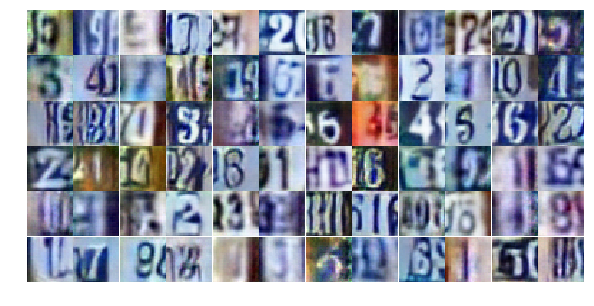

Epoch 18/25... Discriminator Loss: 0.5176... Generator Loss: 1.6604
Epoch 18/25... Discriminator Loss: 0.6955... Generator Loss: 1.1654
Epoch 18/25... Discriminator Loss: 0.6150... Generator Loss: 1.0273
Epoch 18/25... Discriminator Loss: 0.6489... Generator Loss: 1.2469
Epoch 18/25... Discriminator Loss: 0.9221... Generator Loss: 0.7363
Epoch 18/25... Discriminator Loss: 0.6332... Generator Loss: 1.1471
Epoch 18/25... Discriminator Loss: 0.6239... Generator Loss: 1.3688
Epoch 18/25... Discriminator Loss: 0.7217... Generator Loss: 1.0454
Epoch 18/25... Discriminator Loss: 0.6631... Generator Loss: 1.1155
Epoch 18/25... Discriminator Loss: 1.0584... Generator Loss: 0.6511


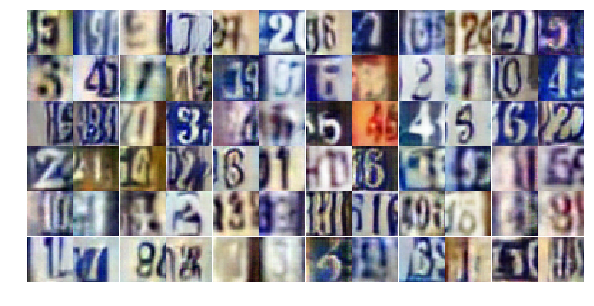

Epoch 18/25... Discriminator Loss: 0.8527... Generator Loss: 1.9968
Epoch 18/25... Discriminator Loss: 0.7621... Generator Loss: 1.0100
Epoch 18/25... Discriminator Loss: 0.8101... Generator Loss: 0.8528
Epoch 18/25... Discriminator Loss: 0.6587... Generator Loss: 1.0343
Epoch 18/25... Discriminator Loss: 0.8759... Generator Loss: 0.7925
Epoch 18/25... Discriminator Loss: 0.8223... Generator Loss: 0.9117
Epoch 18/25... Discriminator Loss: 1.0713... Generator Loss: 0.5729
Epoch 18/25... Discriminator Loss: 1.0326... Generator Loss: 0.7617
Epoch 18/25... Discriminator Loss: 1.1901... Generator Loss: 0.5595
Epoch 18/25... Discriminator Loss: 0.3777... Generator Loss: 1.7929


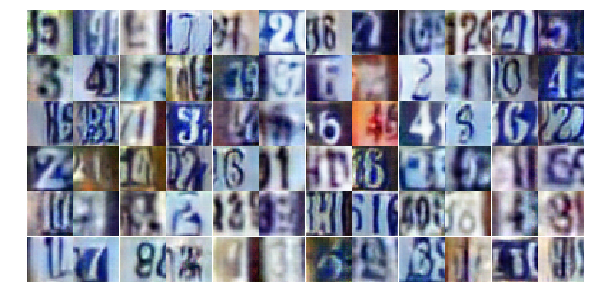

Epoch 18/25... Discriminator Loss: 0.5742... Generator Loss: 1.2233
Epoch 18/25... Discriminator Loss: 0.6214... Generator Loss: 1.0861
Epoch 18/25... Discriminator Loss: 1.2886... Generator Loss: 2.6266
Epoch 18/25... Discriminator Loss: 1.2190... Generator Loss: 2.6140
Epoch 18/25... Discriminator Loss: 0.7821... Generator Loss: 0.9850
Epoch 18/25... Discriminator Loss: 0.8908... Generator Loss: 0.8763
Epoch 18/25... Discriminator Loss: 0.6309... Generator Loss: 1.2990
Epoch 18/25... Discriminator Loss: 0.5330... Generator Loss: 1.2267
Epoch 18/25... Discriminator Loss: 0.9291... Generator Loss: 0.8458
Epoch 18/25... Discriminator Loss: 0.8211... Generator Loss: 0.9029


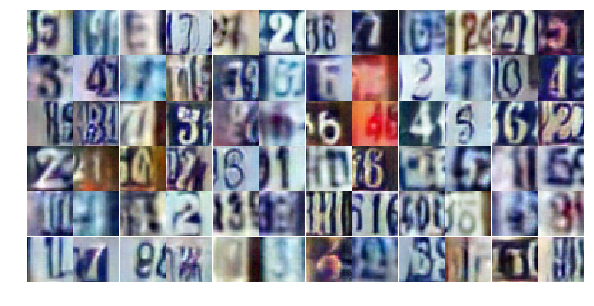

Epoch 18/25... Discriminator Loss: 0.7448... Generator Loss: 1.5345
Epoch 19/25... Discriminator Loss: 1.0881... Generator Loss: 0.6075
Epoch 19/25... Discriminator Loss: 1.2593... Generator Loss: 0.4860
Epoch 19/25... Discriminator Loss: 0.6520... Generator Loss: 1.0498
Epoch 19/25... Discriminator Loss: 0.5644... Generator Loss: 1.2513
Epoch 19/25... Discriminator Loss: 1.0614... Generator Loss: 0.5934
Epoch 19/25... Discriminator Loss: 0.5299... Generator Loss: 1.3087
Epoch 19/25... Discriminator Loss: 1.3368... Generator Loss: 0.4479
Epoch 19/25... Discriminator Loss: 0.8244... Generator Loss: 1.0204
Epoch 19/25... Discriminator Loss: 1.1722... Generator Loss: 0.5403


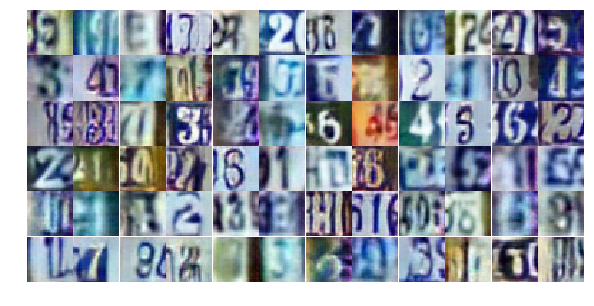

Epoch 19/25... Discriminator Loss: 0.4109... Generator Loss: 1.4594
Epoch 19/25... Discriminator Loss: 0.9651... Generator Loss: 0.6809
Epoch 19/25... Discriminator Loss: 0.7167... Generator Loss: 1.0400
Epoch 19/25... Discriminator Loss: 1.2072... Generator Loss: 0.5507
Epoch 19/25... Discriminator Loss: 0.8258... Generator Loss: 0.7968
Epoch 19/25... Discriminator Loss: 0.9862... Generator Loss: 0.6989
Epoch 19/25... Discriminator Loss: 0.9990... Generator Loss: 0.6673
Epoch 19/25... Discriminator Loss: 0.5098... Generator Loss: 1.3210
Epoch 19/25... Discriminator Loss: 0.7143... Generator Loss: 1.1113
Epoch 19/25... Discriminator Loss: 1.0091... Generator Loss: 0.7895


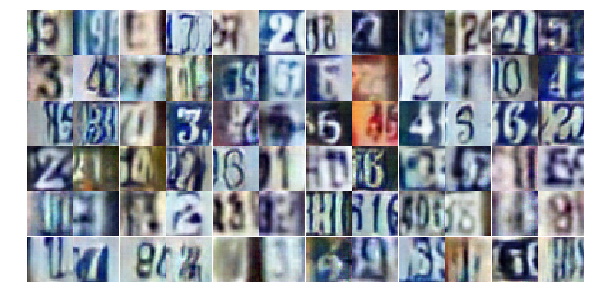

Epoch 19/25... Discriminator Loss: 0.4929... Generator Loss: 1.3207
Epoch 19/25... Discriminator Loss: 1.3665... Generator Loss: 0.4482
Epoch 19/25... Discriminator Loss: 1.0836... Generator Loss: 0.6096
Epoch 19/25... Discriminator Loss: 0.8324... Generator Loss: 1.0573
Epoch 19/25... Discriminator Loss: 1.5681... Generator Loss: 0.3754
Epoch 19/25... Discriminator Loss: 0.8901... Generator Loss: 2.3884
Epoch 19/25... Discriminator Loss: 0.7300... Generator Loss: 1.0786
Epoch 19/25... Discriminator Loss: 0.4662... Generator Loss: 2.2902
Epoch 19/25... Discriminator Loss: 0.7558... Generator Loss: 1.1076
Epoch 19/25... Discriminator Loss: 1.7328... Generator Loss: 0.2962


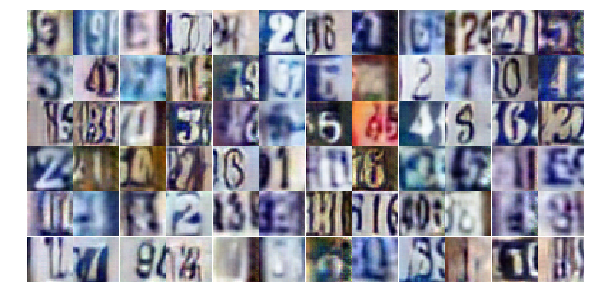

Epoch 19/25... Discriminator Loss: 0.8719... Generator Loss: 0.8397
Epoch 19/25... Discriminator Loss: 0.7518... Generator Loss: 0.9885
Epoch 19/25... Discriminator Loss: 0.9529... Generator Loss: 0.6839
Epoch 19/25... Discriminator Loss: 0.5762... Generator Loss: 1.1455
Epoch 19/25... Discriminator Loss: 0.7500... Generator Loss: 1.1337
Epoch 19/25... Discriminator Loss: 1.5255... Generator Loss: 0.3845
Epoch 19/25... Discriminator Loss: 0.5868... Generator Loss: 1.6018
Epoch 19/25... Discriminator Loss: 0.4489... Generator Loss: 1.8364
Epoch 19/25... Discriminator Loss: 0.7148... Generator Loss: 1.1882
Epoch 19/25... Discriminator Loss: 0.6185... Generator Loss: 1.2155


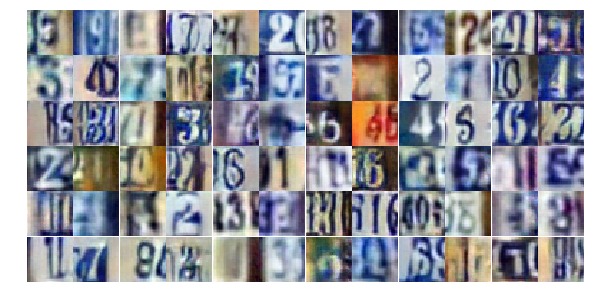

Epoch 19/25... Discriminator Loss: 0.8235... Generator Loss: 0.7566
Epoch 19/25... Discriminator Loss: 0.9051... Generator Loss: 0.7999
Epoch 19/25... Discriminator Loss: 1.3397... Generator Loss: 0.4759
Epoch 19/25... Discriminator Loss: 0.7376... Generator Loss: 0.9158
Epoch 19/25... Discriminator Loss: 0.8728... Generator Loss: 1.0615
Epoch 19/25... Discriminator Loss: 1.3948... Generator Loss: 0.4791
Epoch 19/25... Discriminator Loss: 1.0845... Generator Loss: 0.7087
Epoch 19/25... Discriminator Loss: 0.5306... Generator Loss: 1.4753
Epoch 19/25... Discriminator Loss: 0.7890... Generator Loss: 0.8871
Epoch 19/25... Discriminator Loss: 1.1500... Generator Loss: 0.5937


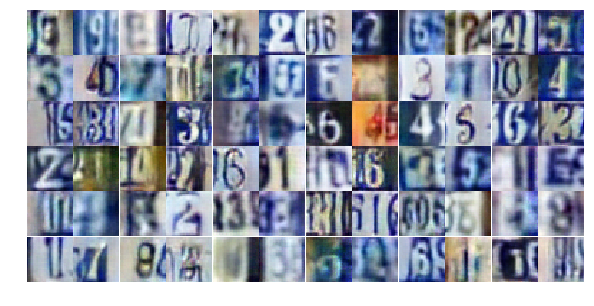

Epoch 19/25... Discriminator Loss: 0.6313... Generator Loss: 1.0396
Epoch 19/25... Discriminator Loss: 0.9041... Generator Loss: 0.7769
Epoch 19/25... Discriminator Loss: 0.7277... Generator Loss: 1.0704
Epoch 19/25... Discriminator Loss: 1.6001... Generator Loss: 0.3791
Epoch 19/25... Discriminator Loss: 1.0748... Generator Loss: 0.5834
Epoch 19/25... Discriminator Loss: 0.7270... Generator Loss: 1.0651
Epoch 19/25... Discriminator Loss: 1.5669... Generator Loss: 0.3855
Epoch 19/25... Discriminator Loss: 0.5777... Generator Loss: 1.3023
Epoch 20/25... Discriminator Loss: 1.0609... Generator Loss: 0.6300
Epoch 20/25... Discriminator Loss: 0.6661... Generator Loss: 1.0119


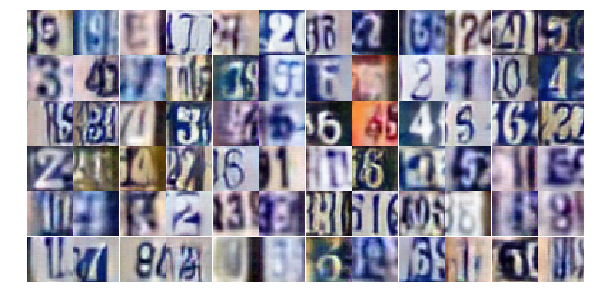

Epoch 20/25... Discriminator Loss: 0.6274... Generator Loss: 1.0998
Epoch 20/25... Discriminator Loss: 0.9783... Generator Loss: 0.6296
Epoch 20/25... Discriminator Loss: 1.5151... Generator Loss: 0.4295
Epoch 20/25... Discriminator Loss: 0.6752... Generator Loss: 1.6876
Epoch 20/25... Discriminator Loss: 0.7388... Generator Loss: 0.9027
Epoch 20/25... Discriminator Loss: 0.6416... Generator Loss: 1.1209
Epoch 20/25... Discriminator Loss: 0.7247... Generator Loss: 1.0409
Epoch 20/25... Discriminator Loss: 0.8078... Generator Loss: 1.1063
Epoch 20/25... Discriminator Loss: 0.6298... Generator Loss: 1.1264
Epoch 20/25... Discriminator Loss: 0.6402... Generator Loss: 1.0193


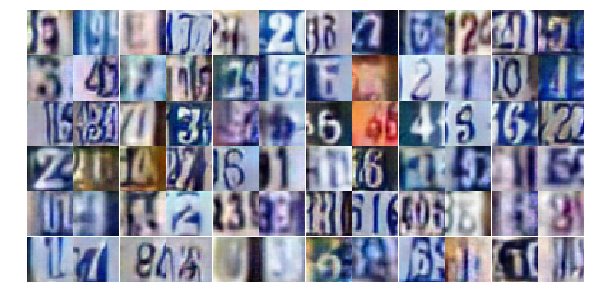

Epoch 20/25... Discriminator Loss: 1.3074... Generator Loss: 0.4506
Epoch 20/25... Discriminator Loss: 0.9995... Generator Loss: 0.6853
Epoch 20/25... Discriminator Loss: 1.0753... Generator Loss: 0.6179
Epoch 20/25... Discriminator Loss: 1.2432... Generator Loss: 0.5187
Epoch 20/25... Discriminator Loss: 1.5768... Generator Loss: 0.3161
Epoch 20/25... Discriminator Loss: 0.7800... Generator Loss: 1.0062
Epoch 20/25... Discriminator Loss: 1.3163... Generator Loss: 0.4588
Epoch 20/25... Discriminator Loss: 0.6265... Generator Loss: 1.2485
Epoch 20/25... Discriminator Loss: 0.4598... Generator Loss: 1.3652
Epoch 20/25... Discriminator Loss: 0.8912... Generator Loss: 0.8369


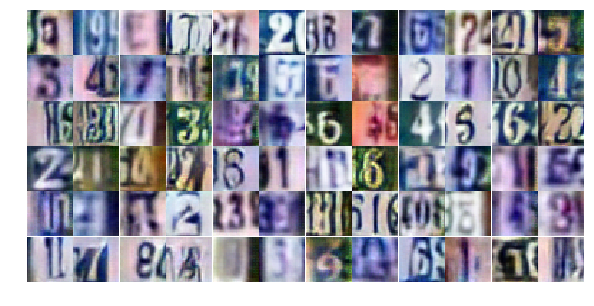

Epoch 20/25... Discriminator Loss: 0.5536... Generator Loss: 1.3039
Epoch 20/25... Discriminator Loss: 0.5837... Generator Loss: 1.2961
Epoch 20/25... Discriminator Loss: 0.4707... Generator Loss: 2.9787
Epoch 20/25... Discriminator Loss: 1.2202... Generator Loss: 0.5014
Epoch 20/25... Discriminator Loss: 0.7886... Generator Loss: 0.8474
Epoch 20/25... Discriminator Loss: 0.6547... Generator Loss: 1.0114
Epoch 20/25... Discriminator Loss: 0.9782... Generator Loss: 2.6898
Epoch 20/25... Discriminator Loss: 1.6974... Generator Loss: 0.3013
Epoch 20/25... Discriminator Loss: 0.8895... Generator Loss: 0.7615
Epoch 20/25... Discriminator Loss: 0.2457... Generator Loss: 2.4256


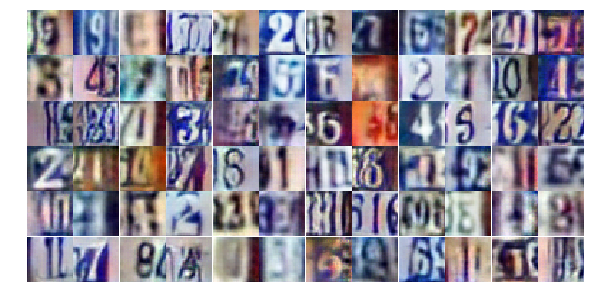

Epoch 20/25... Discriminator Loss: 1.0070... Generator Loss: 0.6423
Epoch 20/25... Discriminator Loss: 0.7315... Generator Loss: 1.0095
Epoch 20/25... Discriminator Loss: 1.1648... Generator Loss: 0.5723
Epoch 20/25... Discriminator Loss: 0.6458... Generator Loss: 1.6237
Epoch 20/25... Discriminator Loss: 1.0282... Generator Loss: 0.7321
Epoch 20/25... Discriminator Loss: 0.8857... Generator Loss: 0.7165
Epoch 20/25... Discriminator Loss: 0.7315... Generator Loss: 1.4789
Epoch 20/25... Discriminator Loss: 1.0372... Generator Loss: 0.6964
Epoch 20/25... Discriminator Loss: 1.0000... Generator Loss: 0.7224
Epoch 20/25... Discriminator Loss: 0.8811... Generator Loss: 0.7959


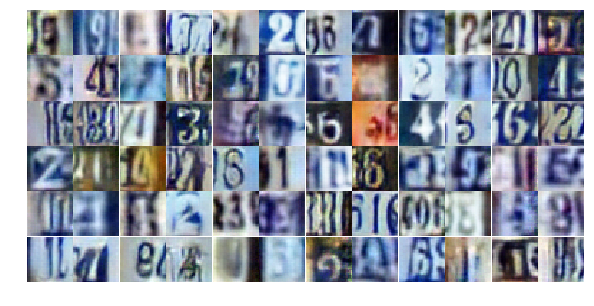

Epoch 20/25... Discriminator Loss: 0.7018... Generator Loss: 0.9450
Epoch 20/25... Discriminator Loss: 0.9614... Generator Loss: 0.7490
Epoch 20/25... Discriminator Loss: 1.2181... Generator Loss: 0.5641
Epoch 20/25... Discriminator Loss: 1.2215... Generator Loss: 0.4900
Epoch 20/25... Discriminator Loss: 3.8715... Generator Loss: 6.0980
Epoch 20/25... Discriminator Loss: 1.6039... Generator Loss: 0.4718
Epoch 20/25... Discriminator Loss: 1.3462... Generator Loss: 0.5423
Epoch 20/25... Discriminator Loss: 0.6237... Generator Loss: 1.6198
Epoch 20/25... Discriminator Loss: 0.6876... Generator Loss: 1.3511
Epoch 20/25... Discriminator Loss: 0.6145... Generator Loss: 1.3153


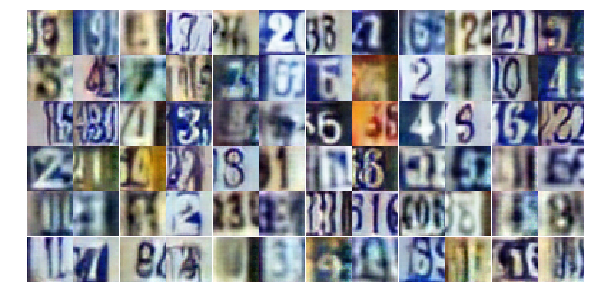

Epoch 20/25... Discriminator Loss: 0.6687... Generator Loss: 1.1720
Epoch 20/25... Discriminator Loss: 0.7586... Generator Loss: 1.2076
Epoch 20/25... Discriminator Loss: 0.5325... Generator Loss: 1.6300
Epoch 20/25... Discriminator Loss: 0.8276... Generator Loss: 1.4254
Epoch 20/25... Discriminator Loss: 0.5123... Generator Loss: 1.3408
Epoch 20/25... Discriminator Loss: 0.6552... Generator Loss: 1.0759
Epoch 21/25... Discriminator Loss: 1.0450... Generator Loss: 0.6007
Epoch 21/25... Discriminator Loss: 0.7851... Generator Loss: 0.9962
Epoch 21/25... Discriminator Loss: 1.0084... Generator Loss: 0.6693
Epoch 21/25... Discriminator Loss: 1.1340... Generator Loss: 0.5865


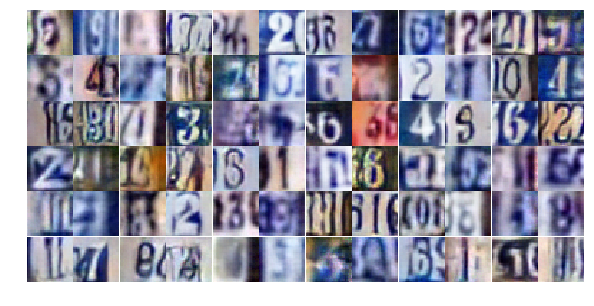

Epoch 21/25... Discriminator Loss: 0.7878... Generator Loss: 1.0538
Epoch 21/25... Discriminator Loss: 1.2181... Generator Loss: 0.5433
Epoch 21/25... Discriminator Loss: 0.4851... Generator Loss: 1.4796
Epoch 21/25... Discriminator Loss: 0.4431... Generator Loss: 1.4308
Epoch 21/25... Discriminator Loss: 0.7907... Generator Loss: 0.9222
Epoch 21/25... Discriminator Loss: 0.4838... Generator Loss: 1.4830
Epoch 21/25... Discriminator Loss: 0.8638... Generator Loss: 0.7855
Epoch 21/25... Discriminator Loss: 0.7971... Generator Loss: 1.1633
Epoch 21/25... Discriminator Loss: 0.6209... Generator Loss: 1.3500
Epoch 21/25... Discriminator Loss: 1.0528... Generator Loss: 0.6183


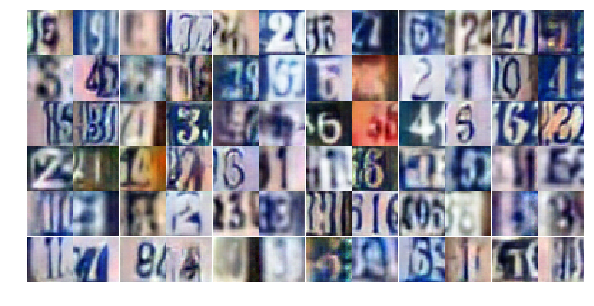

Epoch 21/25... Discriminator Loss: 0.4703... Generator Loss: 1.3810
Epoch 21/25... Discriminator Loss: 0.8339... Generator Loss: 0.8032
Epoch 21/25... Discriminator Loss: 1.4066... Generator Loss: 0.4171
Epoch 21/25... Discriminator Loss: 0.7469... Generator Loss: 0.9865
Epoch 21/25... Discriminator Loss: 0.4741... Generator Loss: 1.7661
Epoch 21/25... Discriminator Loss: 1.5446... Generator Loss: 0.3177
Epoch 21/25... Discriminator Loss: 0.6895... Generator Loss: 1.0727
Epoch 21/25... Discriminator Loss: 0.8014... Generator Loss: 0.8971
Epoch 21/25... Discriminator Loss: 0.3972... Generator Loss: 1.4965
Epoch 21/25... Discriminator Loss: 0.7172... Generator Loss: 0.9701


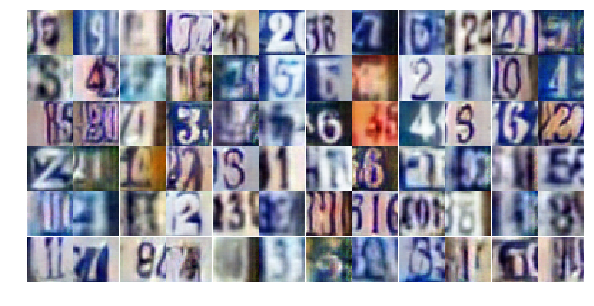

Epoch 21/25... Discriminator Loss: 0.8324... Generator Loss: 0.9656
Epoch 21/25... Discriminator Loss: 0.4280... Generator Loss: 1.7214
Epoch 21/25... Discriminator Loss: 0.9380... Generator Loss: 0.7125
Epoch 21/25... Discriminator Loss: 1.3904... Generator Loss: 0.4073
Epoch 21/25... Discriminator Loss: 0.8326... Generator Loss: 0.8215
Epoch 21/25... Discriminator Loss: 0.7581... Generator Loss: 1.0002
Epoch 21/25... Discriminator Loss: 0.5853... Generator Loss: 1.1429
Epoch 21/25... Discriminator Loss: 1.0292... Generator Loss: 0.6750
Epoch 21/25... Discriminator Loss: 1.2163... Generator Loss: 0.4912
Epoch 21/25... Discriminator Loss: 1.6606... Generator Loss: 0.3317


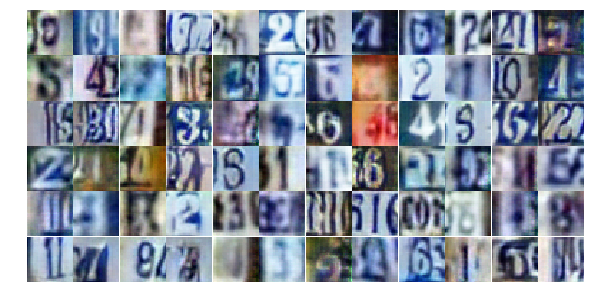

Epoch 21/25... Discriminator Loss: 1.2451... Generator Loss: 0.4540
Epoch 21/25... Discriminator Loss: 0.6123... Generator Loss: 1.1555
Epoch 21/25... Discriminator Loss: 1.0751... Generator Loss: 0.6393
Epoch 21/25... Discriminator Loss: 0.5819... Generator Loss: 1.1439
Epoch 21/25... Discriminator Loss: 0.4761... Generator Loss: 1.3424
Epoch 21/25... Discriminator Loss: 1.6793... Generator Loss: 0.3328
Epoch 21/25... Discriminator Loss: 1.3396... Generator Loss: 0.4150
Epoch 21/25... Discriminator Loss: 1.5519... Generator Loss: 0.4535
Epoch 21/25... Discriminator Loss: 0.7368... Generator Loss: 0.8942
Epoch 21/25... Discriminator Loss: 0.3597... Generator Loss: 1.8705


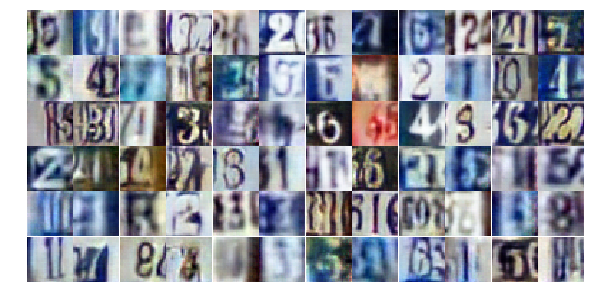

Epoch 21/25... Discriminator Loss: 0.7059... Generator Loss: 1.6785
Epoch 21/25... Discriminator Loss: 1.3489... Generator Loss: 0.4548
Epoch 21/25... Discriminator Loss: 0.7603... Generator Loss: 0.9291
Epoch 21/25... Discriminator Loss: 0.9520... Generator Loss: 0.7356
Epoch 21/25... Discriminator Loss: 0.3332... Generator Loss: 1.8021
Epoch 21/25... Discriminator Loss: 0.7801... Generator Loss: 0.9413
Epoch 21/25... Discriminator Loss: 1.2341... Generator Loss: 0.4990
Epoch 21/25... Discriminator Loss: 1.6793... Generator Loss: 3.9856
Epoch 21/25... Discriminator Loss: 2.6520... Generator Loss: 0.1688
Epoch 21/25... Discriminator Loss: 1.0100... Generator Loss: 0.6514


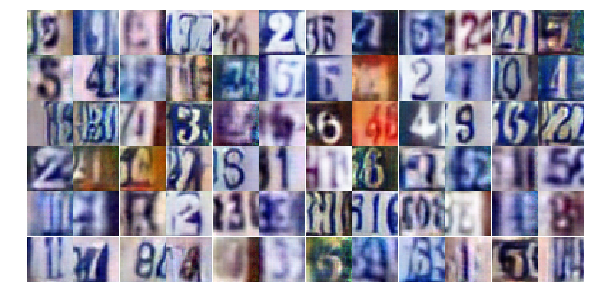

Epoch 21/25... Discriminator Loss: 0.6417... Generator Loss: 1.2826
Epoch 21/25... Discriminator Loss: 0.9184... Generator Loss: 0.7303
Epoch 21/25... Discriminator Loss: 0.8692... Generator Loss: 0.8144
Epoch 22/25... Discriminator Loss: 0.6496... Generator Loss: 1.2738
Epoch 22/25... Discriminator Loss: 1.0712... Generator Loss: 0.6361
Epoch 22/25... Discriminator Loss: 0.8914... Generator Loss: 0.8150
Epoch 22/25... Discriminator Loss: 0.6830... Generator Loss: 1.0543
Epoch 22/25... Discriminator Loss: 0.6707... Generator Loss: 0.9881
Epoch 22/25... Discriminator Loss: 1.1272... Generator Loss: 0.6181
Epoch 22/25... Discriminator Loss: 1.0975... Generator Loss: 0.6655


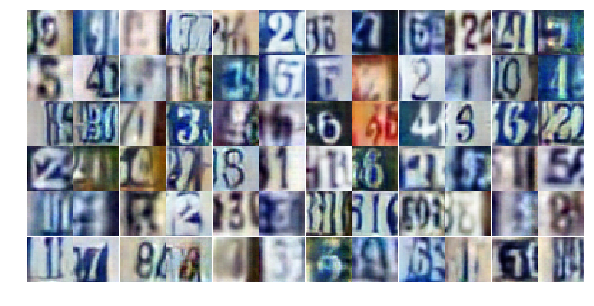

Epoch 22/25... Discriminator Loss: 0.5302... Generator Loss: 1.3513
Epoch 22/25... Discriminator Loss: 0.7018... Generator Loss: 1.2823
Epoch 22/25... Discriminator Loss: 1.6181... Generator Loss: 0.3335
Epoch 22/25... Discriminator Loss: 0.8815... Generator Loss: 0.7285
Epoch 22/25... Discriminator Loss: 1.5998... Generator Loss: 0.3475
Epoch 22/25... Discriminator Loss: 0.7778... Generator Loss: 0.9349
Epoch 22/25... Discriminator Loss: 0.9102... Generator Loss: 0.7752
Epoch 22/25... Discriminator Loss: 0.3836... Generator Loss: 1.6909
Epoch 22/25... Discriminator Loss: 1.3132... Generator Loss: 0.4354
Epoch 22/25... Discriminator Loss: 1.5550... Generator Loss: 0.3422


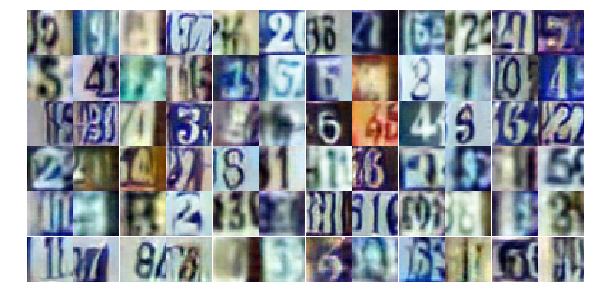

Epoch 22/25... Discriminator Loss: 0.4813... Generator Loss: 1.6650
Epoch 22/25... Discriminator Loss: 0.5633... Generator Loss: 1.1241
Epoch 22/25... Discriminator Loss: 0.9829... Generator Loss: 0.6687
Epoch 22/25... Discriminator Loss: 0.6219... Generator Loss: 1.3721
Epoch 22/25... Discriminator Loss: 0.5213... Generator Loss: 1.3118
Epoch 22/25... Discriminator Loss: 1.3900... Generator Loss: 0.4374
Epoch 22/25... Discriminator Loss: 0.4932... Generator Loss: 1.4093
Epoch 22/25... Discriminator Loss: 0.4691... Generator Loss: 1.5435
Epoch 22/25... Discriminator Loss: 0.6276... Generator Loss: 1.5040
Epoch 22/25... Discriminator Loss: 0.9189... Generator Loss: 0.8145


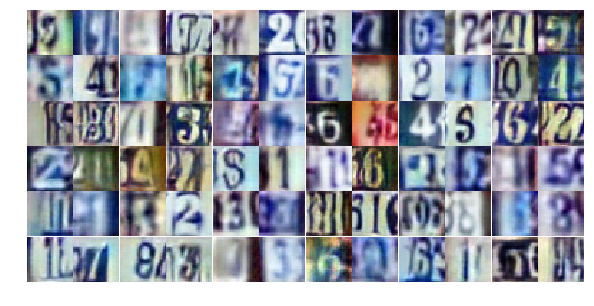

Epoch 22/25... Discriminator Loss: 0.5487... Generator Loss: 1.3331
Epoch 22/25... Discriminator Loss: 0.8887... Generator Loss: 0.7305
Epoch 22/25... Discriminator Loss: 0.7653... Generator Loss: 0.9145
Epoch 22/25... Discriminator Loss: 1.0763... Generator Loss: 0.5955
Epoch 22/25... Discriminator Loss: 0.9391... Generator Loss: 1.0840
Epoch 22/25... Discriminator Loss: 1.0406... Generator Loss: 0.7208
Epoch 22/25... Discriminator Loss: 2.0930... Generator Loss: 0.2168
Epoch 22/25... Discriminator Loss: 0.9371... Generator Loss: 2.5057
Epoch 22/25... Discriminator Loss: 1.3167... Generator Loss: 0.5338
Epoch 22/25... Discriminator Loss: 1.2072... Generator Loss: 0.5856


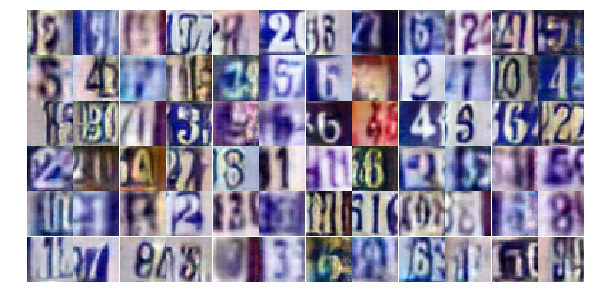

Epoch 22/25... Discriminator Loss: 0.8580... Generator Loss: 0.9817
Epoch 22/25... Discriminator Loss: 0.5959... Generator Loss: 1.2153
Epoch 22/25... Discriminator Loss: 0.5018... Generator Loss: 1.4094
Epoch 22/25... Discriminator Loss: 0.7715... Generator Loss: 1.0118
Epoch 22/25... Discriminator Loss: 0.5637... Generator Loss: 1.2575
Epoch 22/25... Discriminator Loss: 0.7154... Generator Loss: 0.8819
Epoch 22/25... Discriminator Loss: 0.6123... Generator Loss: 1.2921
Epoch 22/25... Discriminator Loss: 1.0628... Generator Loss: 0.6580
Epoch 22/25... Discriminator Loss: 1.2039... Generator Loss: 0.5819
Epoch 22/25... Discriminator Loss: 0.6178... Generator Loss: 1.1533


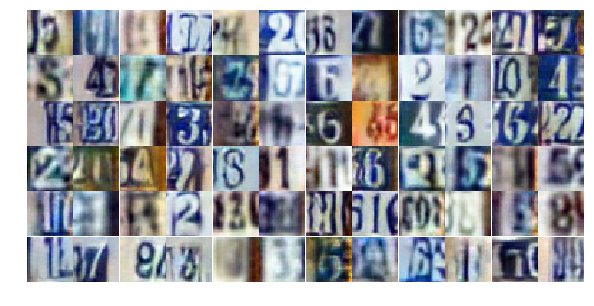

Epoch 22/25... Discriminator Loss: 1.3881... Generator Loss: 0.4176
Epoch 22/25... Discriminator Loss: 0.4902... Generator Loss: 1.5462
Epoch 22/25... Discriminator Loss: 1.2330... Generator Loss: 0.5179
Epoch 22/25... Discriminator Loss: 0.8542... Generator Loss: 0.9690
Epoch 22/25... Discriminator Loss: 0.7407... Generator Loss: 0.9522
Epoch 22/25... Discriminator Loss: 0.6474... Generator Loss: 1.4939
Epoch 22/25... Discriminator Loss: 0.8890... Generator Loss: 0.9494
Epoch 22/25... Discriminator Loss: 0.9903... Generator Loss: 0.6512
Epoch 22/25... Discriminator Loss: 0.9638... Generator Loss: 2.4462
Epoch 22/25... Discriminator Loss: 0.7536... Generator Loss: 1.0749


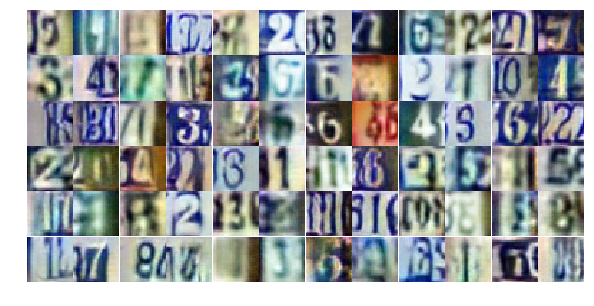

Epoch 23/25... Discriminator Loss: 0.6844... Generator Loss: 1.1020
Epoch 23/25... Discriminator Loss: 0.3478... Generator Loss: 1.7469
Epoch 23/25... Discriminator Loss: 0.9622... Generator Loss: 0.6843
Epoch 23/25... Discriminator Loss: 0.5672... Generator Loss: 1.5503
Epoch 23/25... Discriminator Loss: 0.7365... Generator Loss: 1.3952
Epoch 23/25... Discriminator Loss: 1.6591... Generator Loss: 0.3663
Epoch 23/25... Discriminator Loss: 1.4002... Generator Loss: 0.4455
Epoch 23/25... Discriminator Loss: 0.7086... Generator Loss: 1.0317
Epoch 23/25... Discriminator Loss: 0.4907... Generator Loss: 1.3706
Epoch 23/25... Discriminator Loss: 0.4196... Generator Loss: 1.5094


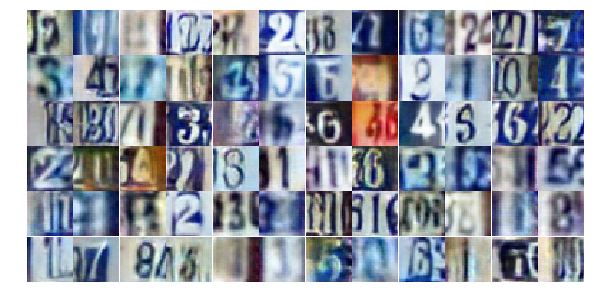

Epoch 23/25... Discriminator Loss: 0.5497... Generator Loss: 1.2353
Epoch 23/25... Discriminator Loss: 0.6447... Generator Loss: 1.2610
Epoch 23/25... Discriminator Loss: 0.6190... Generator Loss: 1.2719
Epoch 23/25... Discriminator Loss: 0.8536... Generator Loss: 0.7739
Epoch 23/25... Discriminator Loss: 0.3269... Generator Loss: 1.8812
Epoch 23/25... Discriminator Loss: 0.8915... Generator Loss: 0.8028
Epoch 23/25... Discriminator Loss: 0.7323... Generator Loss: 1.0282
Epoch 23/25... Discriminator Loss: 0.5669... Generator Loss: 1.7070
Epoch 23/25... Discriminator Loss: 0.6910... Generator Loss: 1.4110
Epoch 23/25... Discriminator Loss: 1.2844... Generator Loss: 0.4555


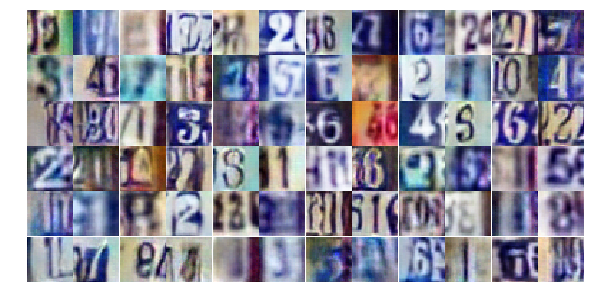

Epoch 23/25... Discriminator Loss: 0.9665... Generator Loss: 0.7399
Epoch 23/25... Discriminator Loss: 0.5962... Generator Loss: 1.4978
Epoch 23/25... Discriminator Loss: 1.4491... Generator Loss: 0.4354
Epoch 23/25... Discriminator Loss: 0.9314... Generator Loss: 0.7238
Epoch 23/25... Discriminator Loss: 0.5748... Generator Loss: 1.4092
Epoch 23/25... Discriminator Loss: 1.0917... Generator Loss: 0.5922
Epoch 23/25... Discriminator Loss: 0.8394... Generator Loss: 0.8807
Epoch 23/25... Discriminator Loss: 1.1168... Generator Loss: 0.5370
Epoch 23/25... Discriminator Loss: 0.4870... Generator Loss: 1.3116
Epoch 23/25... Discriminator Loss: 0.8802... Generator Loss: 0.9202


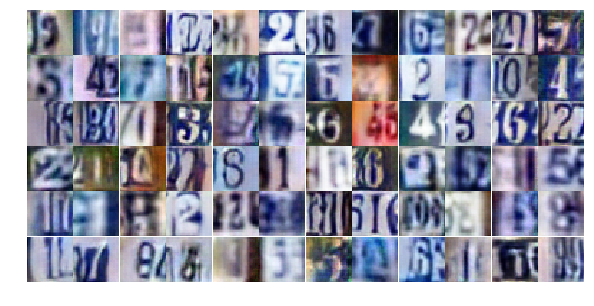

Epoch 23/25... Discriminator Loss: 0.5925... Generator Loss: 1.2758
Epoch 23/25... Discriminator Loss: 0.4638... Generator Loss: 1.3854
Epoch 23/25... Discriminator Loss: 0.6724... Generator Loss: 1.0386
Epoch 23/25... Discriminator Loss: 1.3897... Generator Loss: 0.4118
Epoch 23/25... Discriminator Loss: 1.1901... Generator Loss: 3.1531
Epoch 23/25... Discriminator Loss: 1.1054... Generator Loss: 0.6374
Epoch 23/25... Discriminator Loss: 1.1113... Generator Loss: 1.3119
Epoch 23/25... Discriminator Loss: 0.7391... Generator Loss: 1.0117
Epoch 23/25... Discriminator Loss: 0.5480... Generator Loss: 1.3189
Epoch 23/25... Discriminator Loss: 0.4611... Generator Loss: 1.4265


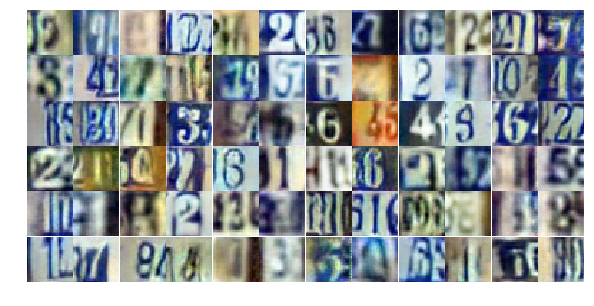

Epoch 23/25... Discriminator Loss: 1.1142... Generator Loss: 0.6098
Epoch 23/25... Discriminator Loss: 0.7696... Generator Loss: 0.9265
Epoch 23/25... Discriminator Loss: 1.5496... Generator Loss: 0.4067
Epoch 23/25... Discriminator Loss: 0.6736... Generator Loss: 1.0632
Epoch 23/25... Discriminator Loss: 1.2926... Generator Loss: 0.5992
Epoch 23/25... Discriminator Loss: 0.9773... Generator Loss: 0.6912
Epoch 23/25... Discriminator Loss: 0.7132... Generator Loss: 1.0592
Epoch 23/25... Discriminator Loss: 1.0696... Generator Loss: 0.6584
Epoch 23/25... Discriminator Loss: 0.7064... Generator Loss: 1.0842
Epoch 23/25... Discriminator Loss: 1.1570... Generator Loss: 0.5696


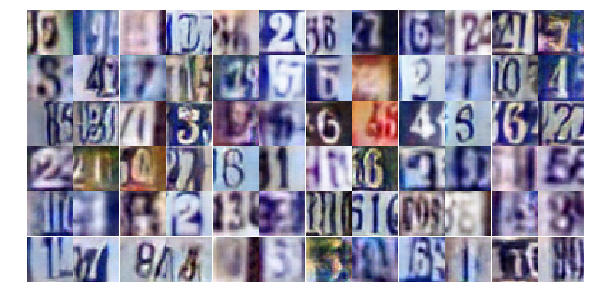

Epoch 23/25... Discriminator Loss: 0.5478... Generator Loss: 1.4802
Epoch 23/25... Discriminator Loss: 1.2389... Generator Loss: 0.5370
Epoch 23/25... Discriminator Loss: 0.9245... Generator Loss: 0.8759
Epoch 23/25... Discriminator Loss: 0.4256... Generator Loss: 1.4645
Epoch 23/25... Discriminator Loss: 1.2259... Generator Loss: 0.5775
Epoch 23/25... Discriminator Loss: 0.6623... Generator Loss: 1.0250
Epoch 23/25... Discriminator Loss: 0.8445... Generator Loss: 0.8341
Epoch 24/25... Discriminator Loss: 0.7711... Generator Loss: 0.8584
Epoch 24/25... Discriminator Loss: 0.8477... Generator Loss: 0.8670
Epoch 24/25... Discriminator Loss: 0.8793... Generator Loss: 1.5022


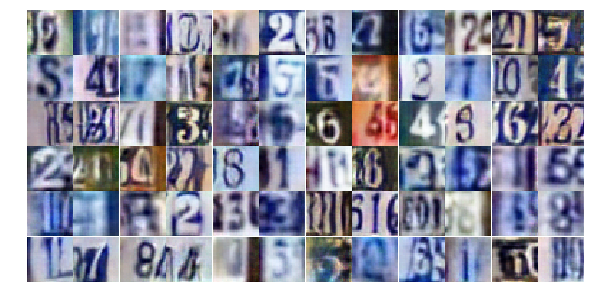

Epoch 24/25... Discriminator Loss: 0.4797... Generator Loss: 1.5521
Epoch 24/25... Discriminator Loss: 1.0418... Generator Loss: 2.3340
Epoch 24/25... Discriminator Loss: 0.6617... Generator Loss: 1.5964
Epoch 24/25... Discriminator Loss: 0.9834... Generator Loss: 3.0640
Epoch 24/25... Discriminator Loss: 0.8610... Generator Loss: 0.8328
Epoch 24/25... Discriminator Loss: 0.8367... Generator Loss: 0.8805
Epoch 24/25... Discriminator Loss: 0.8484... Generator Loss: 0.9300
Epoch 24/25... Discriminator Loss: 0.9820... Generator Loss: 0.6885
Epoch 24/25... Discriminator Loss: 0.2587... Generator Loss: 2.1272
Epoch 24/25... Discriminator Loss: 0.4929... Generator Loss: 1.7064


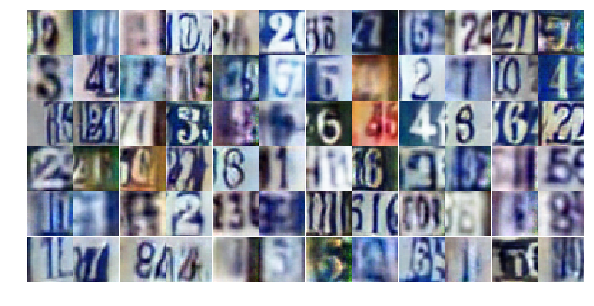

Epoch 24/25... Discriminator Loss: 1.1957... Generator Loss: 0.5266
Epoch 24/25... Discriminator Loss: 0.9347... Generator Loss: 0.8869
Epoch 24/25... Discriminator Loss: 1.0985... Generator Loss: 0.5946
Epoch 24/25... Discriminator Loss: 0.7071... Generator Loss: 0.9286
Epoch 24/25... Discriminator Loss: 0.9849... Generator Loss: 3.6066
Epoch 24/25... Discriminator Loss: 0.8466... Generator Loss: 2.0137
Epoch 24/25... Discriminator Loss: 0.8709... Generator Loss: 0.8729
Epoch 24/25... Discriminator Loss: 1.5813... Generator Loss: 0.3565
Epoch 24/25... Discriminator Loss: 0.7977... Generator Loss: 1.1269
Epoch 24/25... Discriminator Loss: 0.8456... Generator Loss: 0.8333


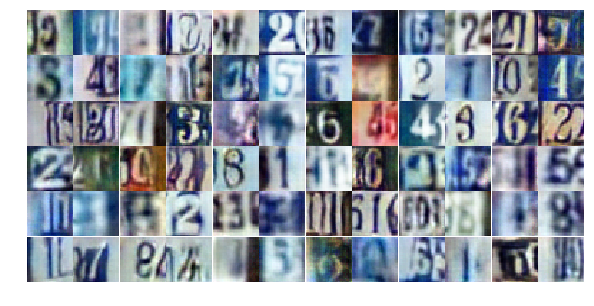

Epoch 24/25... Discriminator Loss: 0.7806... Generator Loss: 0.9029
Epoch 24/25... Discriminator Loss: 0.5560... Generator Loss: 1.2960
Epoch 24/25... Discriminator Loss: 0.4647... Generator Loss: 1.4031
Epoch 24/25... Discriminator Loss: 1.1363... Generator Loss: 0.6115
Epoch 24/25... Discriminator Loss: 0.7581... Generator Loss: 0.9098
Epoch 24/25... Discriminator Loss: 0.5240... Generator Loss: 1.2597
Epoch 24/25... Discriminator Loss: 0.4346... Generator Loss: 1.7360
Epoch 24/25... Discriminator Loss: 1.5473... Generator Loss: 3.1952
Epoch 24/25... Discriminator Loss: 0.8980... Generator Loss: 0.8301
Epoch 24/25... Discriminator Loss: 0.9749... Generator Loss: 0.8080


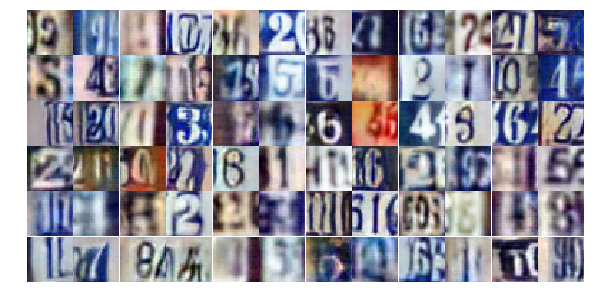

Epoch 24/25... Discriminator Loss: 0.6529... Generator Loss: 1.0337
Epoch 24/25... Discriminator Loss: 1.2077... Generator Loss: 0.4864
Epoch 24/25... Discriminator Loss: 0.9618... Generator Loss: 0.7361
Epoch 24/25... Discriminator Loss: 2.0408... Generator Loss: 0.2153
Epoch 24/25... Discriminator Loss: 0.7966... Generator Loss: 1.4120
Epoch 24/25... Discriminator Loss: 0.8093... Generator Loss: 0.8623
Epoch 24/25... Discriminator Loss: 0.8881... Generator Loss: 0.8747
Epoch 24/25... Discriminator Loss: 1.0223... Generator Loss: 0.6659
Epoch 24/25... Discriminator Loss: 0.9076... Generator Loss: 0.7534
Epoch 24/25... Discriminator Loss: 0.7461... Generator Loss: 2.3157


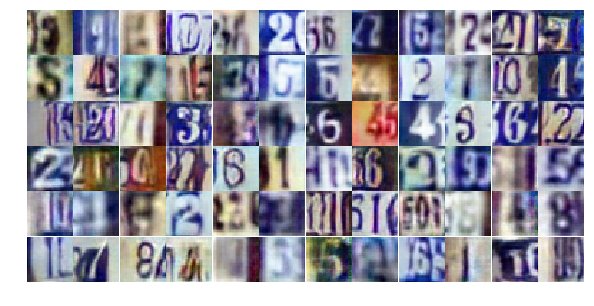

Epoch 24/25... Discriminator Loss: 0.5665... Generator Loss: 2.0812
Epoch 24/25... Discriminator Loss: 1.9147... Generator Loss: 0.2847
Epoch 24/25... Discriminator Loss: 0.8997... Generator Loss: 1.6012
Epoch 24/25... Discriminator Loss: 1.2285... Generator Loss: 0.5801
Epoch 24/25... Discriminator Loss: 1.1684... Generator Loss: 0.5636
Epoch 24/25... Discriminator Loss: 0.7545... Generator Loss: 1.0434
Epoch 24/25... Discriminator Loss: 1.1529... Generator Loss: 0.5799
Epoch 24/25... Discriminator Loss: 0.4782... Generator Loss: 1.3947
Epoch 24/25... Discriminator Loss: 0.8498... Generator Loss: 0.8273
Epoch 24/25... Discriminator Loss: 0.7518... Generator Loss: 1.0756


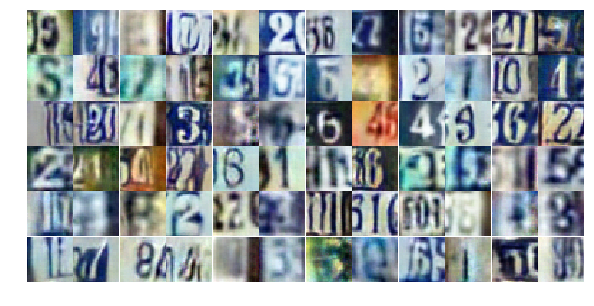

Epoch 24/25... Discriminator Loss: 0.8793... Generator Loss: 0.8226
Epoch 24/25... Discriminator Loss: 1.3573... Generator Loss: 0.4348
Epoch 24/25... Discriminator Loss: 1.5471... Generator Loss: 0.3497
Epoch 24/25... Discriminator Loss: 0.7315... Generator Loss: 1.9227
Epoch 24/25... Discriminator Loss: 0.7184... Generator Loss: 1.0051
Epoch 25/25... Discriminator Loss: 0.5812... Generator Loss: 1.5014
Epoch 25/25... Discriminator Loss: 0.4284... Generator Loss: 1.6891
Epoch 25/25... Discriminator Loss: 0.9670... Generator Loss: 0.6990
Epoch 25/25... Discriminator Loss: 0.9846... Generator Loss: 0.6613
Epoch 25/25... Discriminator Loss: 0.8077... Generator Loss: 0.8405


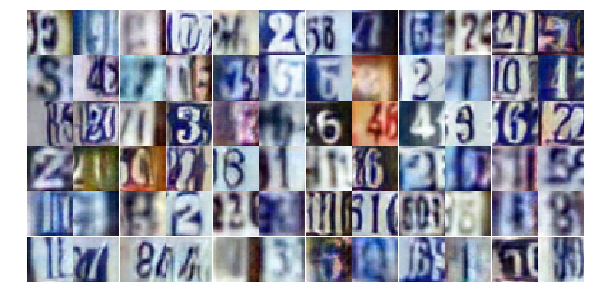

Epoch 25/25... Discriminator Loss: 0.8859... Generator Loss: 0.8101
Epoch 25/25... Discriminator Loss: 1.8637... Generator Loss: 0.2695
Epoch 25/25... Discriminator Loss: 1.1325... Generator Loss: 0.6035
Epoch 25/25... Discriminator Loss: 0.6379... Generator Loss: 1.3778
Epoch 25/25... Discriminator Loss: 1.0857... Generator Loss: 0.6127
Epoch 25/25... Discriminator Loss: 0.8278... Generator Loss: 0.8412
Epoch 25/25... Discriminator Loss: 0.6781... Generator Loss: 1.0430
Epoch 25/25... Discriminator Loss: 0.6776... Generator Loss: 1.3216
Epoch 25/25... Discriminator Loss: 0.6185... Generator Loss: 1.0965
Epoch 25/25... Discriminator Loss: 0.9472... Generator Loss: 0.7062


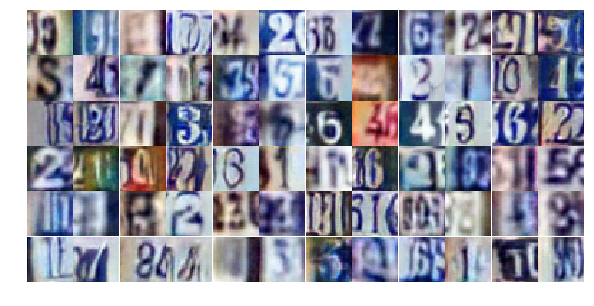

Epoch 25/25... Discriminator Loss: 0.8577... Generator Loss: 1.9534
Epoch 25/25... Discriminator Loss: 0.6951... Generator Loss: 2.3102
Epoch 25/25... Discriminator Loss: 1.0256... Generator Loss: 0.6836
Epoch 25/25... Discriminator Loss: 1.4148... Generator Loss: 0.4560
Epoch 25/25... Discriminator Loss: 0.8373... Generator Loss: 0.7734
Epoch 25/25... Discriminator Loss: 0.6975... Generator Loss: 1.0967
Epoch 25/25... Discriminator Loss: 0.8272... Generator Loss: 0.9152
Epoch 25/25... Discriminator Loss: 0.6957... Generator Loss: 1.9344
Epoch 25/25... Discriminator Loss: 0.7359... Generator Loss: 0.9835
Epoch 25/25... Discriminator Loss: 1.2763... Generator Loss: 0.6044


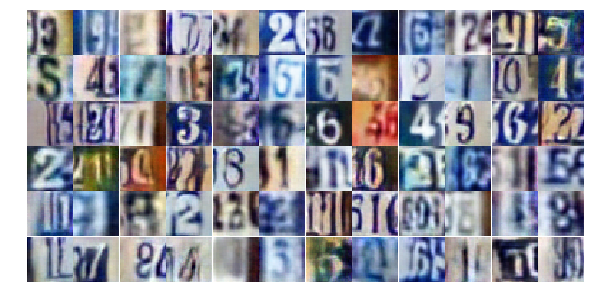

Epoch 25/25... Discriminator Loss: 1.5505... Generator Loss: 0.4048
Epoch 25/25... Discriminator Loss: 0.6113... Generator Loss: 1.3020
Epoch 25/25... Discriminator Loss: 1.2486... Generator Loss: 0.6139
Epoch 25/25... Discriminator Loss: 1.2185... Generator Loss: 0.5895
Epoch 25/25... Discriminator Loss: 0.6957... Generator Loss: 1.2393
Epoch 25/25... Discriminator Loss: 0.6086... Generator Loss: 1.2625
Epoch 25/25... Discriminator Loss: 0.6759... Generator Loss: 1.0377
Epoch 25/25... Discriminator Loss: 0.6742... Generator Loss: 1.0816
Epoch 25/25... Discriminator Loss: 0.9440... Generator Loss: 0.6918
Epoch 25/25... Discriminator Loss: 1.6016... Generator Loss: 0.8712


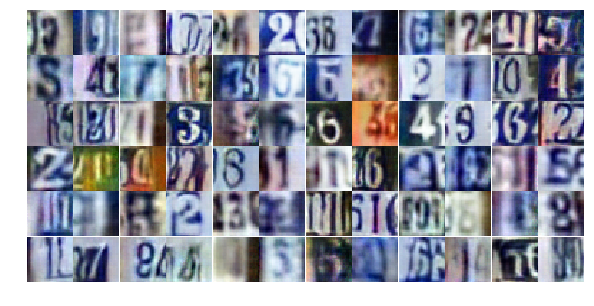

Epoch 25/25... Discriminator Loss: 1.0681... Generator Loss: 1.9367
Epoch 25/25... Discriminator Loss: 0.6596... Generator Loss: 2.7016
Epoch 25/25... Discriminator Loss: 0.9866... Generator Loss: 0.7609
Epoch 25/25... Discriminator Loss: 1.0769... Generator Loss: 0.6125
Epoch 25/25... Discriminator Loss: 1.3569... Generator Loss: 0.5111
Epoch 25/25... Discriminator Loss: 0.6630... Generator Loss: 1.1408
Epoch 25/25... Discriminator Loss: 0.4931... Generator Loss: 1.3397
Epoch 25/25... Discriminator Loss: 0.7387... Generator Loss: 0.9716
Epoch 25/25... Discriminator Loss: 2.2412... Generator Loss: 0.2322
Epoch 25/25... Discriminator Loss: 0.7150... Generator Loss: 1.0531


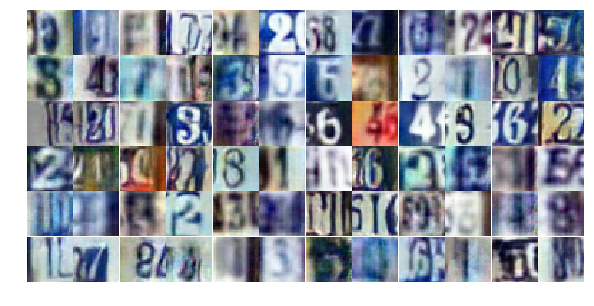

Epoch 25/25... Discriminator Loss: 1.2736... Generator Loss: 0.5030
Epoch 25/25... Discriminator Loss: 0.8282... Generator Loss: 0.8293
Epoch 25/25... Discriminator Loss: 0.8884... Generator Loss: 0.7684
Epoch 25/25... Discriminator Loss: 0.7703... Generator Loss: 1.0779
Epoch 25/25... Discriminator Loss: 0.6352... Generator Loss: 1.2079
Epoch 25/25... Discriminator Loss: 0.5104... Generator Loss: 1.2884
Epoch 25/25... Discriminator Loss: 1.5468... Generator Loss: 0.3722
Epoch 25/25... Discriminator Loss: 0.5515... Generator Loss: 1.2566
Epoch 25/25... Discriminator Loss: 0.9276... Generator Loss: 0.7350
Epoch 25/25... Discriminator Loss: 0.6087... Generator Loss: 1.1182


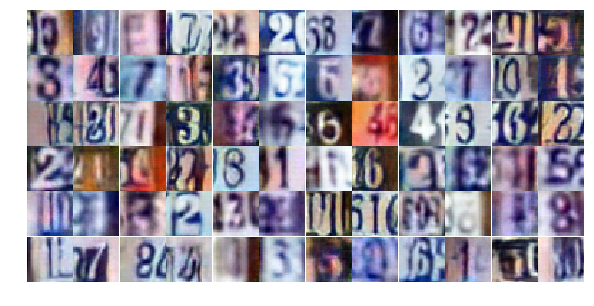

Epoch 25/25... Discriminator Loss: 0.8345... Generator Loss: 0.8492
Epoch 25/25... Discriminator Loss: 2.0877... Generator Loss: 0.2073


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

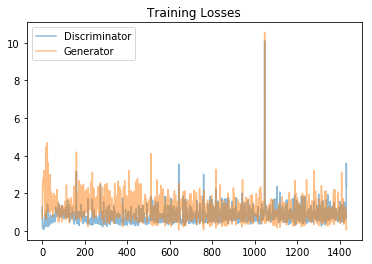

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

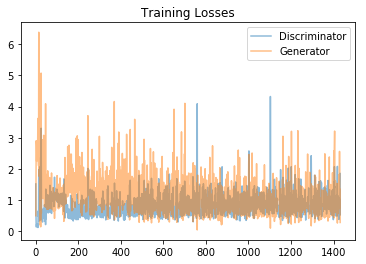

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

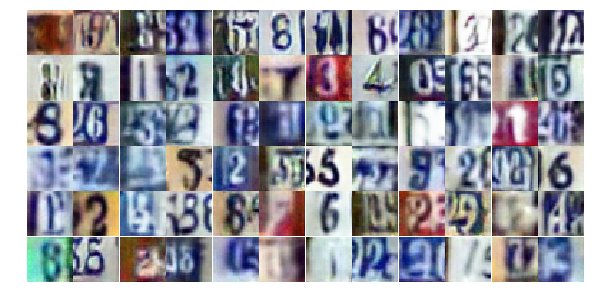

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

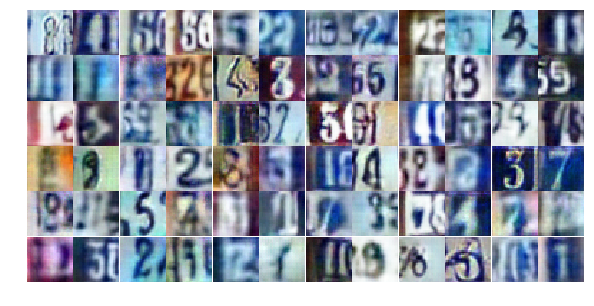

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))